# Physical Therapy Dataset

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import faux as f
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
import numpy as np
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, mean_absolute_error, r2_score
import warnings
warnings.filterwarnings('ignore')
import pickle
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

# Sobre los datos

El conjunto de datos utilizado en este ejercicio contiene información obtenida de sensores inerciales y magnéticos portátiles durante la ejecución de ejercicios de fisioterapia. Incluye ocho tipos de ejercicios, cada uno realizado en tres modalidades diferentes (correcta, rápida y de baja amplitud), repetidos varias veces por cinco sujetos. Los participantes usaron cinco unidades de sensores MTx fabricadas por XSens, cada una equipada con acelerómetro, giroscopio y magnetómetro tri-axiales, muestreados a 25 Hz. Los datos fueron recolectados bajo la aprobación del Comité de Ética de la Universidad de Bilkent, garantizando el anonimato de los participantes y con su consentimiento informado. Este conjunto de datos respalda investigaciones sobre la detección automatizada y evaluación de ejercicios de fisioterapia.

## Estructura de los datos

La estructura de los datos están distribuidos en carpetas de la siguiente manera:

- **s1, ..., s5**: representan los sujetos 1 a 5.
- **e1, ..., e8**: representan los 8 tipos de ejercicios.
- **u1, ..., u5**: representan las 5 unidades de sensores utilizadas.

La organización de los archivos es la siguiente:

1. **Sesiones de plantilla (template_session.txt)**: Para cada sujeto, tipo de ejercicio y unidad de sensor, este archivo contiene datos recolectados durante una sesión de grabación que incluye tres ejecuciones para cada uno de los tres tipos de ejecución (correcta, rápida y de baja amplitud). Los intervalos de tiempo de las plantillas seleccionadas están disponibles en archivos adicionales denominados `template_times.txt`.

2. **Intervalos de tiempo de plantillas seleccionadas (template_times.txt)**: Estos archivos, disponibles para cada sujeto y tipo de ejercicio, especifican los índices de tiempo de inicio y fin de las plantillas seleccionadas en los archivos `template_session.txt`.

3. **Sesiones de prueba (test.txt)**: Para cada sujeto, tipo de ejercicio y unidad de sensor, este archivo contiene datos de una sesión de prueba con 10 repeticiones para cada tipo de ejecución.

Cada fila de los archivos `template_session.txt` y `test.txt` incluye el índice de tiempo (𝑛 = 1, 2, … , 𝑁) y las mediciones en los ejes 𝑥, 𝑦 y 𝑧 de los sensores de acelerómetro (acc), giroscopio (gyr) y magnetómetro (mag), cuyo orden se indica en las filas de encabezado. Los datos están muestreados a una frecuencia de 25 Hz (𝑓𝑠 = 25 Hz), permitiendo calcular el tiempo como 𝑡 = (𝑛 − 1)/𝑓𝑠 = 0.04 (𝑛 − 1) segundos.

# Análisis exploratorio


In [ ]:
for s in range(1,6):
    for e in range(1,9):
        for u in range(1,6):
            var_name = f's{s}e{e}u{u}'
            globals()[var_name] = pd.read_csv(rf'C:\Users\Valen\Desktop\fisioterapia_dataset_regresion\s{s}\e{e}\u{u}\template_session.txt', sep = ';')

In [ ]:
templates = {f's{s}e{e}u{u}': globals()[f's{s}e{e}u{u}'] for s in range(1, 6) for e in range(1, 9) for u in range(1, 6)}

En total son 200 bases de datos con las combinaciones entre sujeto, ejercicio y unidad de sensor. Se declaró la ausencia de datos faltantes.

## Comportamiento de las series

El análisis comenzará explorando cada combinación de las series de datos obtenidas para los diferentes sujetos, tipos de ejercicios y unidades de sensores. Esto permitirá observar y comparar el comportamiento específico de las mediciones según cada sujeto, considerando los ocho ejercicos distitos y las cinco unidades de sensores utilizadas.

Para ello, se procesarán y visualizarán las señales de acelerómetro, giroscopio y magnetómetro en los ejes 𝑥, 𝑦 y 𝑧, obtenidas. Se analizarán las tendencias, patrones y variaciones en las series temporales para identificar características relevantes en el contexto de la detección automatizada y evaluación de ejercicios de fisioterapia.

### Primer ejercicio

```{note}
Este ejercicio consiste en sentarse en una superficie plana y elevada. Desde esa posición, debes levantar la pierna derecha manteniéndola completamente recta. Luego, sostén esa postura durante 5 segundos, asegurándote de que la rodilla derecha permanezca extendida. Finalmente, baja la pierna con control y regresa a la posición inicial. Al ser un ejercicio de piernas, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en rodilla derecha, 4 en rodilla izquierda y 5 en pecho.
```


![](assets/sensor_leg.png)

![](assets/ex1.png)




_Figuras tomada de Yurtman, A., & Barshan, B. (2024). Automated evaluation of physical therapy exercises using multi-template dynamic time warping on wearable sensor signals. Journal of Sensor Technology, 15(4), 123-134. https://doi.org/10.1016/j.cmpb.2014.07.003_

In [ ]:
def plot_dens(s, e, variables):
    """
    Genera una gráfica con una matriz 3x5 mostrando la densidad (density plot)
    para las señales de los sensores.

    Parámetros:
    s (int): Número del sujeto.
    e (int): Número del ejercicio.
    variables (dict): Diccionario con las variables de datos.
    """

    # Paleta de colores personalizada
    colores = {'acc_x': '#003f5c', 'acc_y': '#2f4b7c', 'acc_z': '#665191',
               'gyr_x': '#a05195', 'gyr_y': '#d45087', 'gyr_z': '#f95d6a',
               'mag_x': '#ff7c43', 'mag_y': '#ffa600', 'mag_z': '#ffd026'}

    fig, axes = plt.subplots(3, 5, figsize=(20, 12), sharex=False, sharey=False)
    fig.suptitle(f'Sujeto {s} - Ejercicio {e} (template)', fontsize=20)

    sensor_axes = ['acc', 'gyr', 'mag']
    units = range(1, 6)

    for i, sensor in enumerate(sensor_axes):
        for j, u in enumerate(units):
            var_name = f's{s}e{e}u{u}'
            data = variables[var_name]

            ax = axes[i, j]

            # Graficar densidad con colores personalizados
            sns.kdeplot(data[f'{sensor}_x'], ax=ax, label=f'{sensor}_x', fill=True, alpha=0.5, color=colores[f'{sensor}_x'])
            sns.kdeplot(data[f'{sensor}_y'], ax=ax, label=f'{sensor}_y', fill=True, alpha=0.5, color=colores[f'{sensor}_y'])
            sns.kdeplot(data[f'{sensor}_z'], ax=ax, label=f'{sensor}_z', fill=True, alpha=0.5, color=colores[f'{sensor}_z'])

            if i == 0:
                ax.set_title(f'Unidad {u}', fontsize=12)
            if j == 0:
                ax.set_ylabel(f'{sensor.upper()}', fontsize=12)
            ax.legend(fontsize=8)
            ax.grid(True)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()



def plot_dist(s, e, variables):
    """
    Genera una gráfica con una matriz 3x5 para las señales de los sensores.

    Parámetros:
    s (int): Número del sujeto.
    e (int): Número del ejercicio.
    variables (dict): Diccionario con las variables de datos.
    """

    # Paleta de colores personalizada
    colores = {'acc_x': '#003f5c', 'acc_y': '#2f4b7c', 'acc_z': '#665191',
               'gyr_x': '#a05195', 'gyr_y': '#d45087', 'gyr_z': '#f95d6a',
               'mag_x': '#ff7c43', 'mag_y': '#ffa600', 'mag_z': '#ffd026'}

    fig, axes = plt.subplots(3, 5, figsize=(20, 12), sharex=True, sharey=True)
    fig.suptitle(f'Sujeto {s} - Ejercicio {e} (template)', fontsize=20)

    sensor_axes = ['acc', 'gyr', 'mag']
    units = range(1, 6)

    for i, sensor in enumerate(sensor_axes):
        for j, u in enumerate(units):
            var_name = f's{s}e{e}u{u}'
            data = variables[var_name]

            time = data['time index']

            ax = axes[i, j]
            ax.plot(time, data[f'{sensor}_x'], label=f'{sensor}_x', color=colores[f'{sensor}_x'])
            ax.plot(time, data[f'{sensor}_y'], label=f'{sensor}_y', color=colores[f'{sensor}_y'])
            ax.plot(time, data[f'{sensor}_z'], label=f'{sensor}_z', color=colores[f'{sensor}_z'])

            if i == 0:
                ax.set_title(f'Unidad {u}', fontsize=12)
            if j == 0:
                ax.set_ylabel(f'{sensor.upper()}', fontsize=12)
            ax.grid(True)
            ax.legend(fontsize=8)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


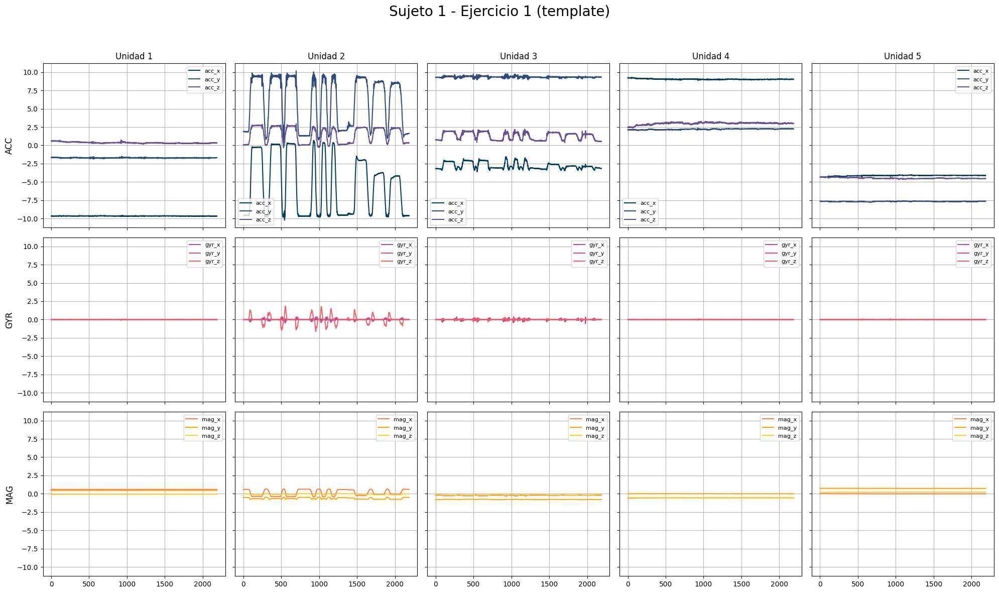

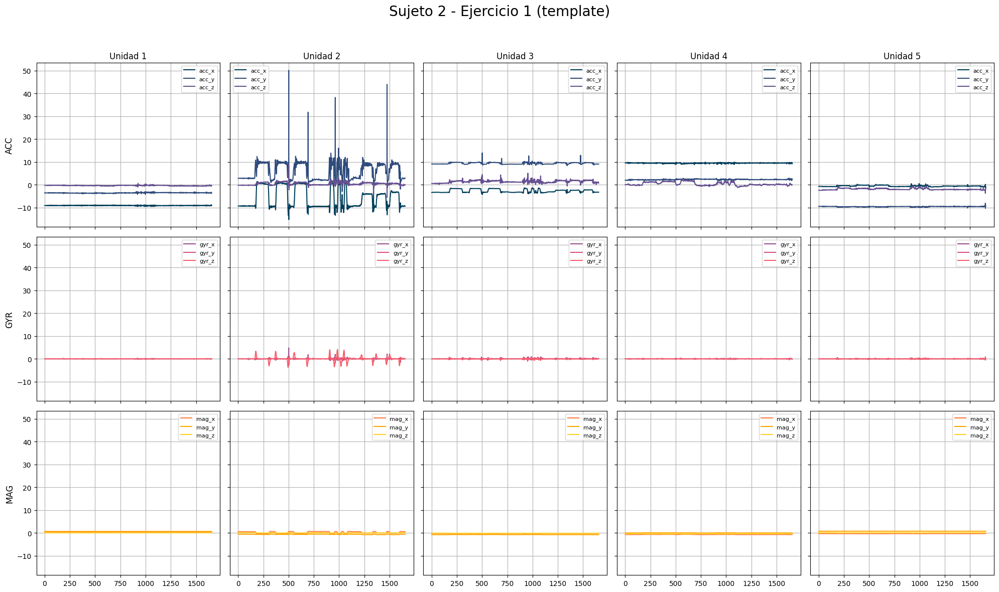

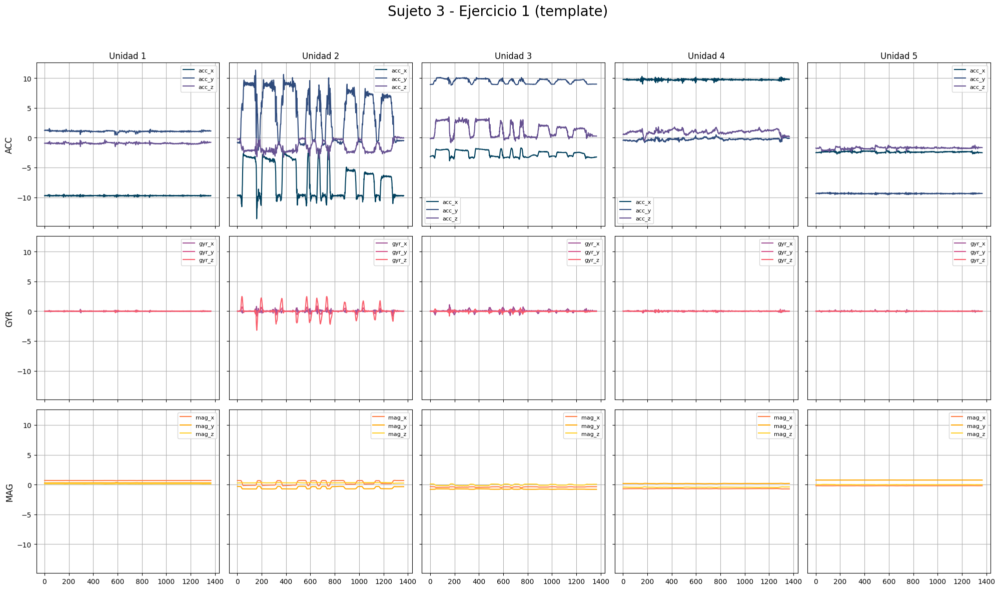

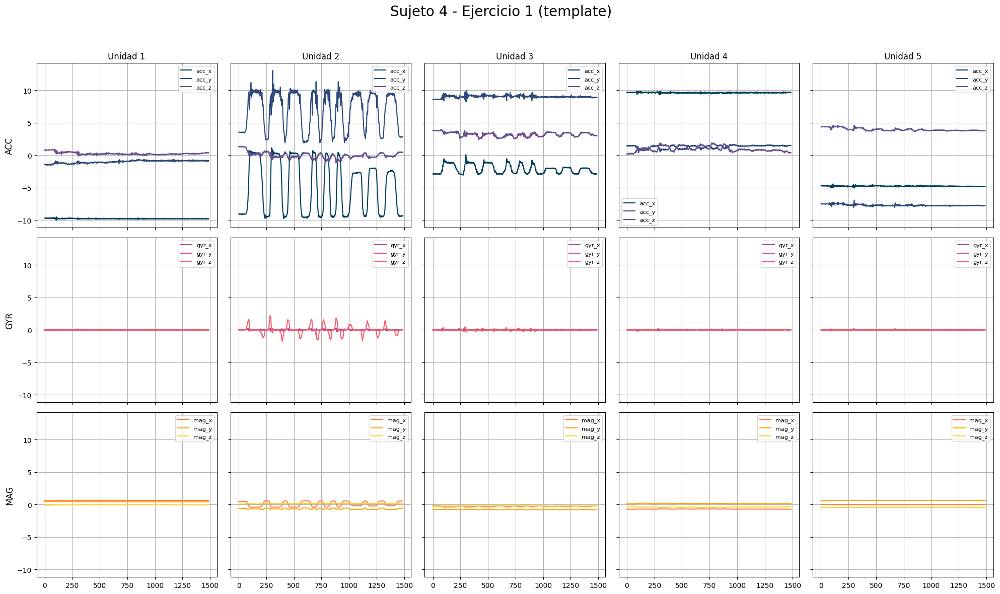

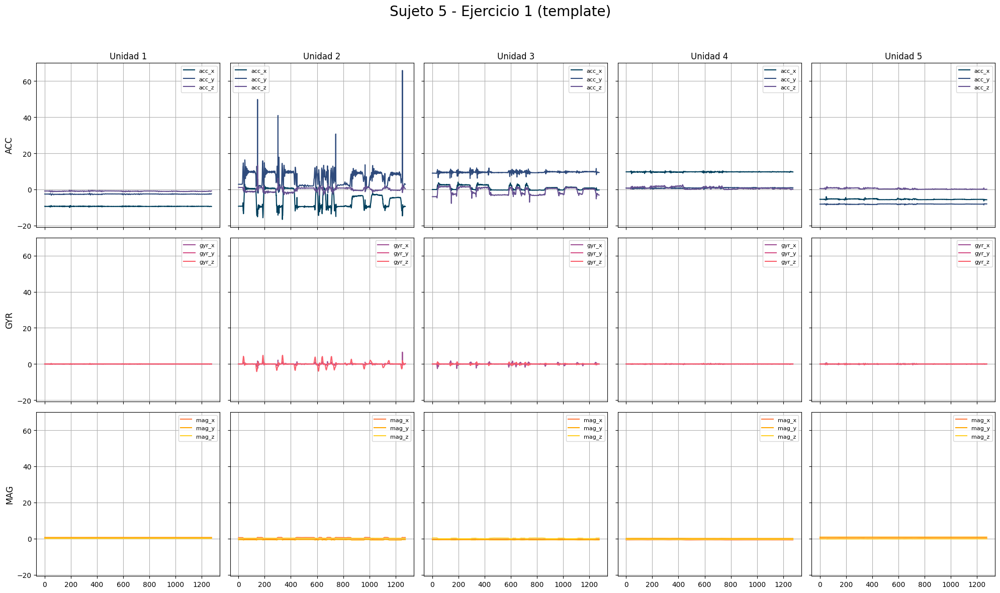

In [ ]:
f.plot_dist(1, 1, templates)
f.plot_dist(2, 1, templates)
f.plot_dist(3, 1, templates)
f.plot_dist(4, 1, templates)
f.plot_dist(5, 1, templates)

Dado que los sensores involucrados en este ejercicio están mayormente asociados con la extremidad inferior derecha, era de esperarse una mayor actividad en las unidades de sensores 2 y 3. Se identifican claramente las nueve repeticiones descritas en los datos proporcionados, así como la agrupación en los tres tipos de ejecución realizados por cada sujeto. Este patrón es particularmente evidente en el caso del tercer sujeto, donde se observan picos pronunciados en las señales del acelerómetro, atribuibles a la ejecución del tipo 1, es decir, en modalidad rápida. Además, los cambios en las mediciones del giroscopio, especialmente en el eje z, son notables y reflejan el movimiento de elevación y descenso realizado predominantemente por el tobillo derecho (unidad 2).

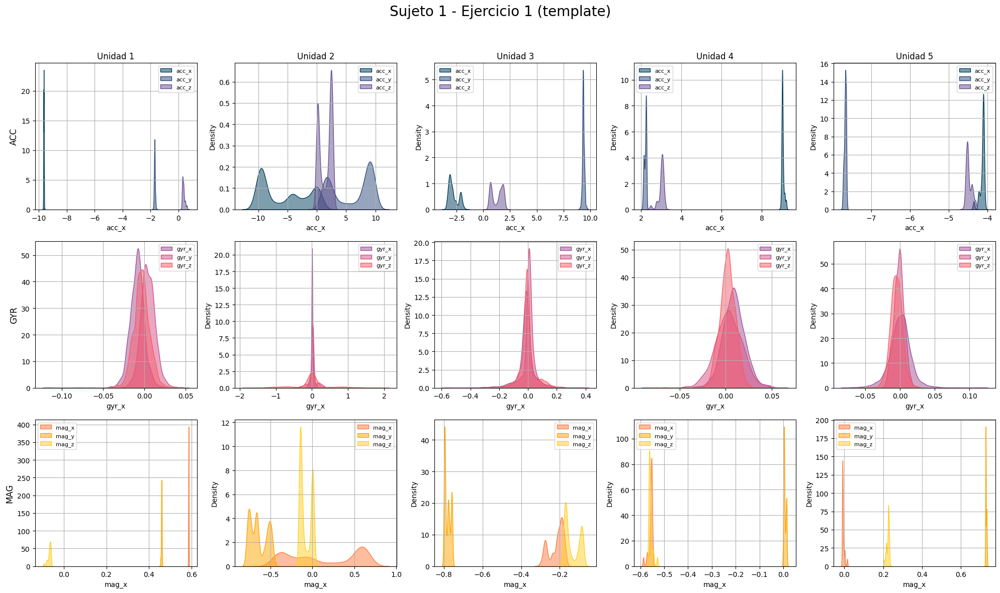

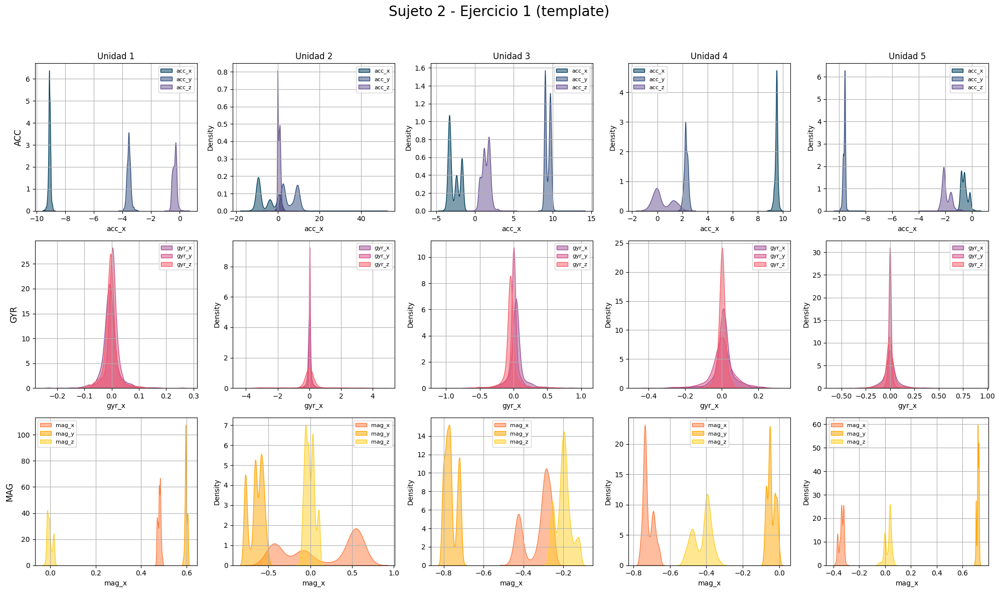

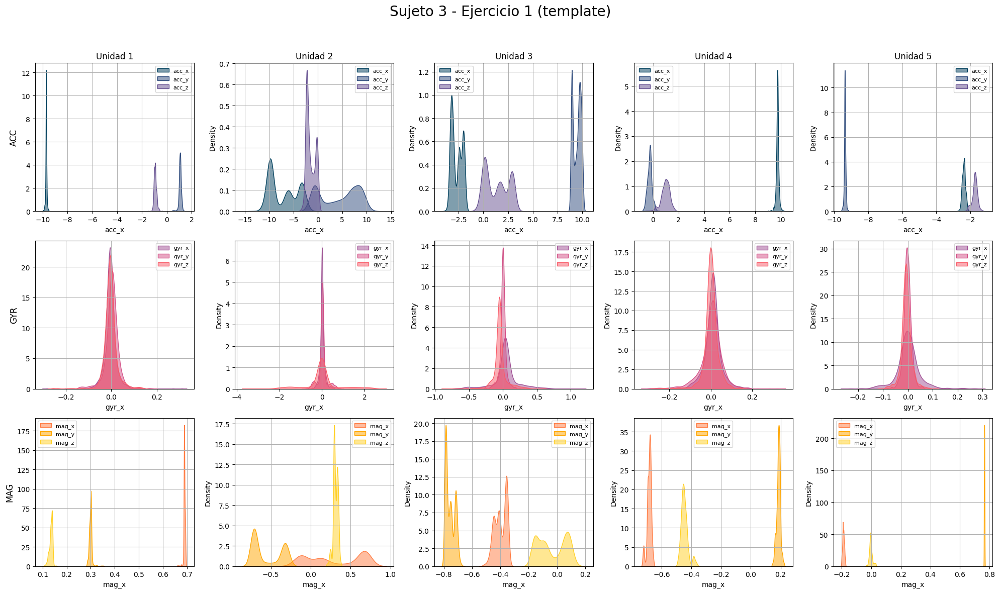

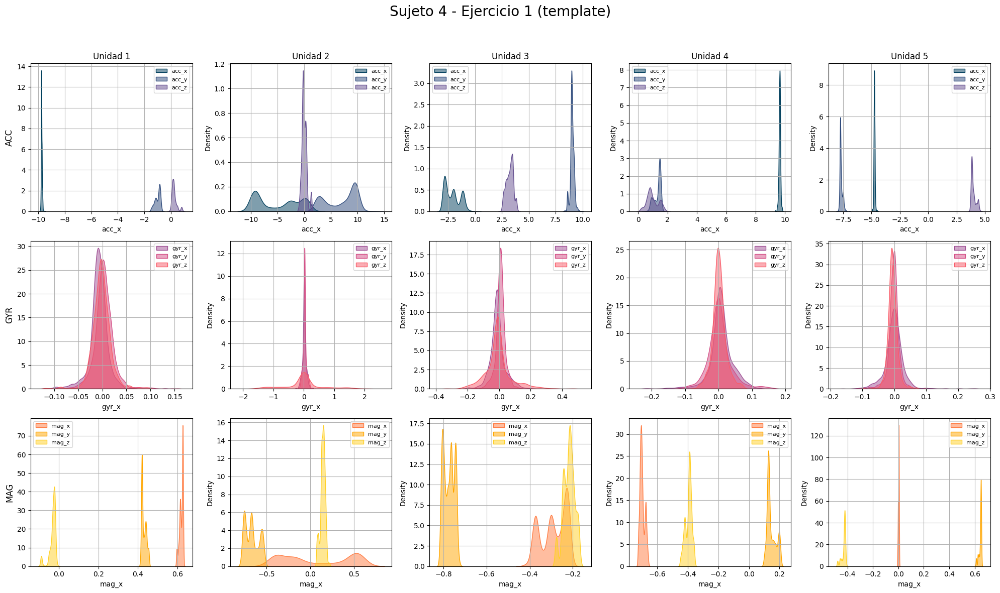

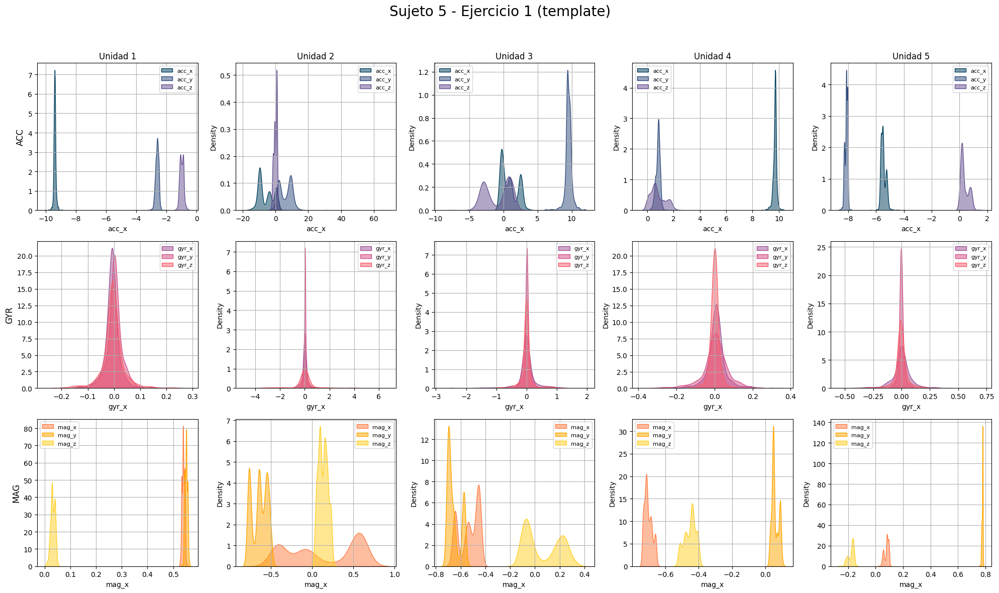

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 1, templates)

Se puede observar los casos de la unidad dos y tres, las distribuciones en el acelerómetro para la coordenada z parece estar siempre entre la distribución de las coordenadas x y y en todos los sujetos. Las figuras reflejan distribuciones similares y bastantes leptokurticas (punteadas), como las asociadas a las medidas del giroscopío.

In [ ]:
temp = f.stats_por_unidad(1,templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.007554,0.003,-0.003678,-9.533232,-1.630793,-0.244513,0.580823,0.469654,0.002841
Mediana,-0.007685,0.003388,-0.00375,-9.647643,-1.710451,-0.237421,0.586989,0.459703,-0.012382
Desviación estándar,0.025491,0.023479,0.027695,0.248346,1.508149,0.581099,0.069072,0.098615,0.069846


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.007159,0.019697,-0.002799,-5.815661,5.924555,0.226042,0.149879,-0.629556,0.07758
Mediana,0.004266,0.019747,-0.003886,-6.638964,6.954605,0.126491,0.125992,-0.656313,0.080676
Desviación estándar,0.184964,0.134206,0.799696,4.025359,3.760253,1.327514,0.404617,0.117234,0.146752


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.007064,0.004701,-0.020392,-2.04856,9.343125,1.338649,-0.335044,-0.751875,-0.115305
Mediana,0.000331,0.006135,-0.02006,-2.483286,9.322949,1.519057,-0.300484,-0.768408,-0.163164
Desviación estándar,0.189605,0.066329,0.127228,1.475255,0.365531,1.553813,0.119276,0.053029,0.124773


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.008586,0.002321,0.001144,9.462405,1.404986,1.37732,-0.662494,0.061083,-0.463567
Mediana,0.008299,0.003532,0.001447,9.566833,1.531519,1.091514,-0.686296,0.034125,-0.449966
Desviación estándar,0.041857,0.051819,0.024175,0.290021,0.945753,1.121267,0.068535,0.086465,0.067927


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.000246,-0.001976,-0.005683,-3.427367,-8.441707,-1.132555,-0.091534,0.724615,-0.04333
Mediana,-0.000213,-0.001404,-0.006034,-4.108644,-8.073672,-1.739244,-0.008729,0.72781,-0.002036
Desviación estándar,0.060915,0.018883,0.043641,1.744735,0.845009,2.920452,0.15075,0.045161,0.227751


Las unidades 2 (tobillo derecho) y 3 (rodilla derecha) muestran las mayores variaciones en todas las mediciones, lo que confirma su participación activa en el levantamiento y mantenimiento de la pierna derecha extendida. Estas unidades tienen desviaciones estándar elevadas en el acelerómetro, giroscopio y magnetómetro, reflejando tanto el levantamiento como los ajustes durante el ejercicio. Las unidades 1 (tobillo izquierdo) y 4 (rodilla izquierda) presentan señales muy estables, reflejando su papel de soporte durante el movimiento. La unidad 5 (pecho) muestra señales estables con ligeras variaciones en el acelerómetro, probablemente debido a ajustes posturales mínimos.



### Segundo ejercicio

```{note}
Este ejercicio consiste en sentarse erguido en un taburete con los brazos colgando hacia abajo. Desde esa posición, inclinar el torso hacia adelante a un ángulo de 30°, manteniendo la postura durante 5 segundos. Finalmente, regresa a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en la rodilla derecha, 2 en la muñeca derecha, 3 en el codo derecho, 4 en el hombro derecho y 5 en el pecho.
```


![](assets/sensor_arm.png)

![](assets/ex2.png)


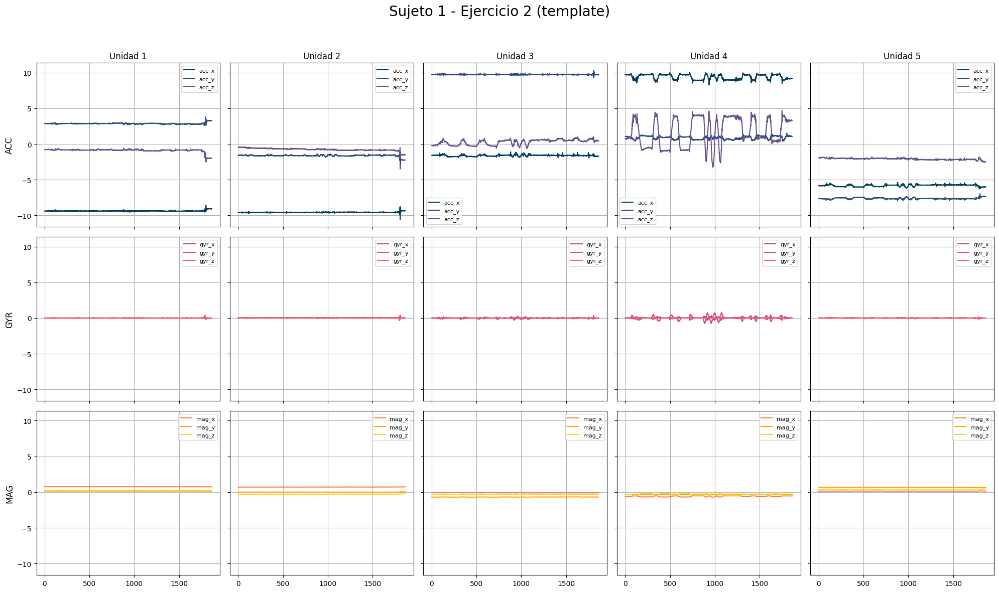

In [ ]:
f.plot_dist(1, 2, templates)

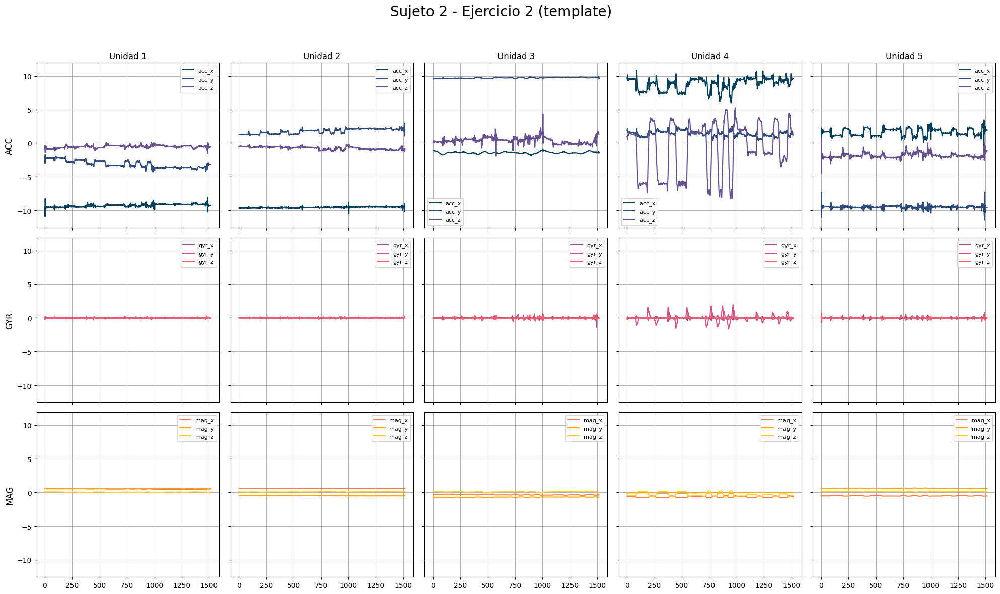

In [ ]:
f.plot_dist(2, 2, templates)

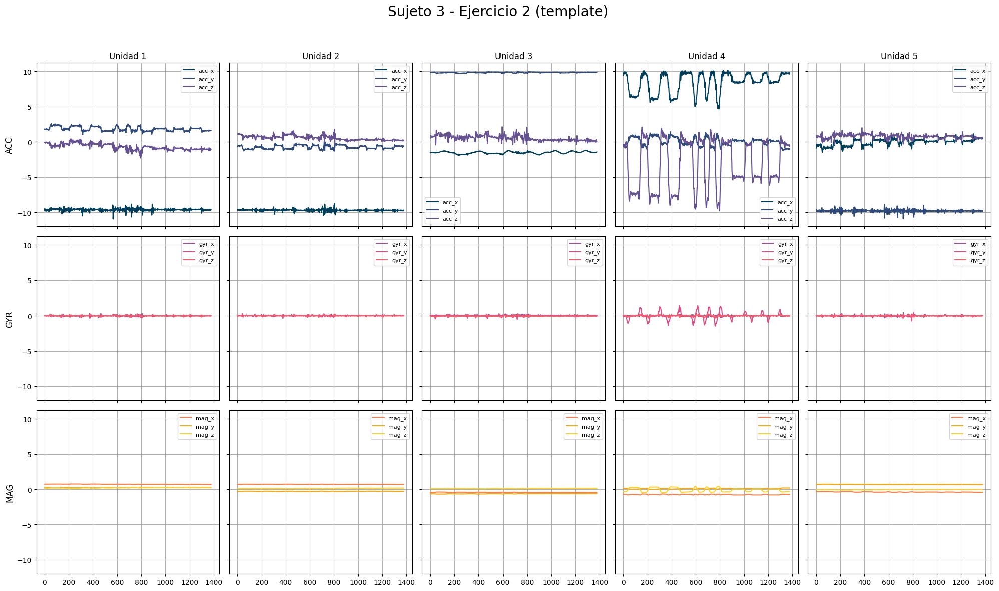

In [ ]:
f.plot_dist(3, 2, templates)

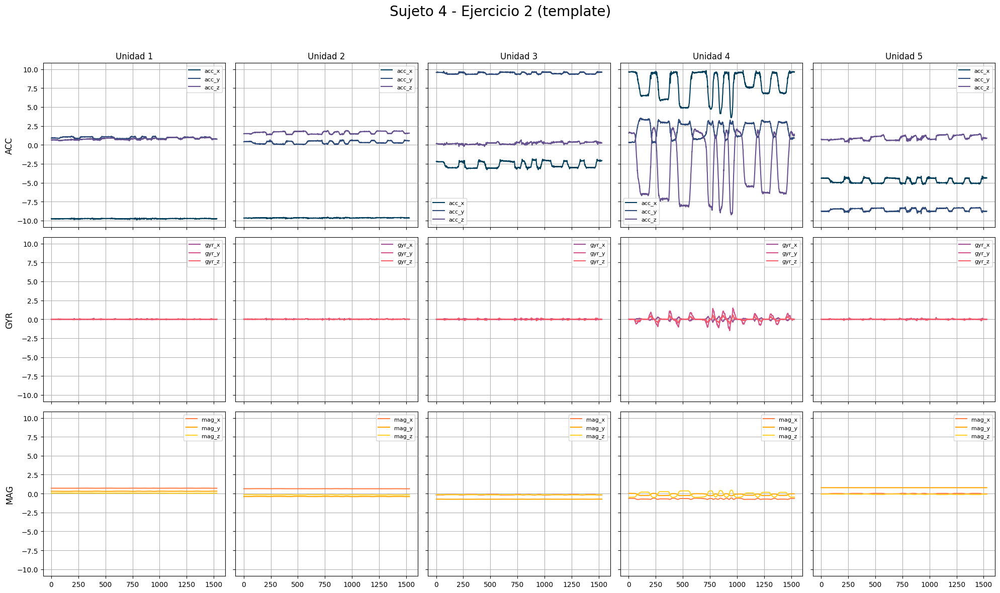

In [ ]:
f.plot_dist(4, 2, templates)

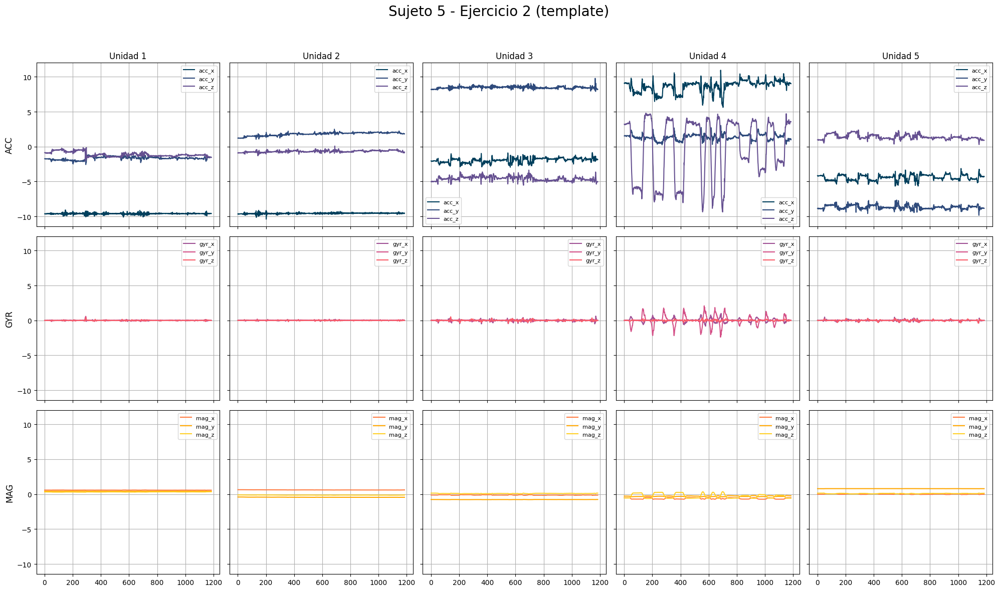

In [ ]:
f.plot_dist(5, 2, templates)

Debido a la naturaleza del ejercicio y los movimientos realizados, era de esperarse que el acelerómetro mostrara mayores cambios en la unidad del sensor localizada en el hombro (4), el cual presenta una mayor variabilidad en las mediciones de los tres instrumentos (acelerómetro, giroscopio y magnetómetro). Asimismo, el sensor ubicado en el pecho (5) refleja una actividad significativa en todos los ejes del acelerómetro. Por otro lado, debido a que los brazos permanecen colgando durante el ejercicio, se observa poca actividad en la unidad 2, correspondiente al sensor ubicado en la muñeca, como era de esperarse dada la posición requerida.

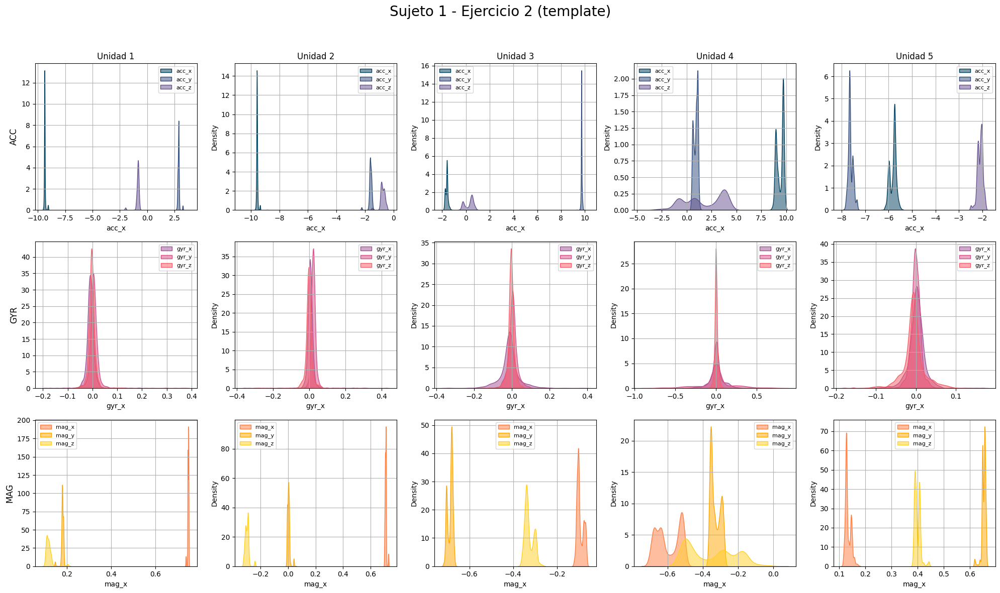

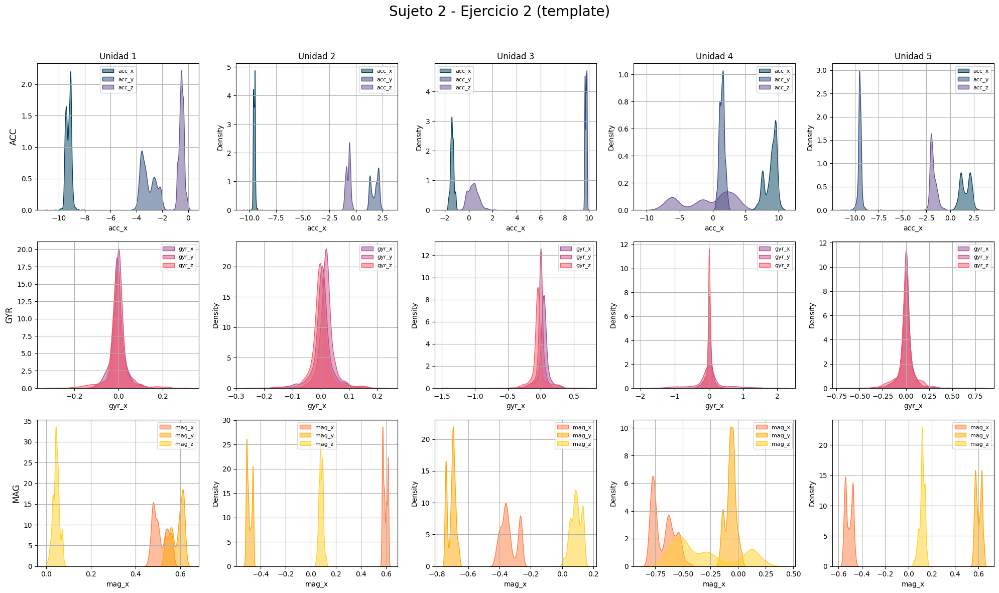

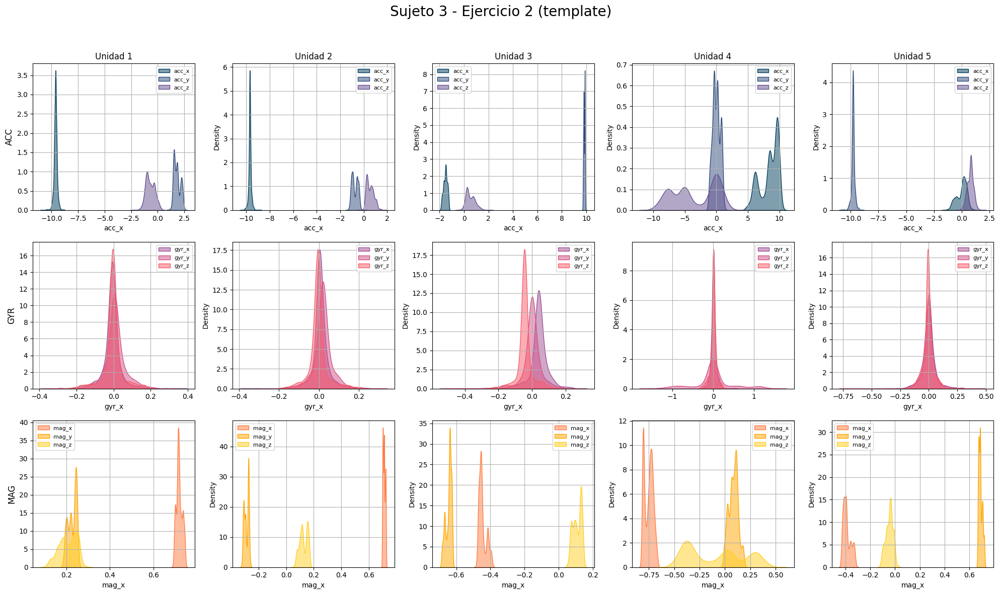

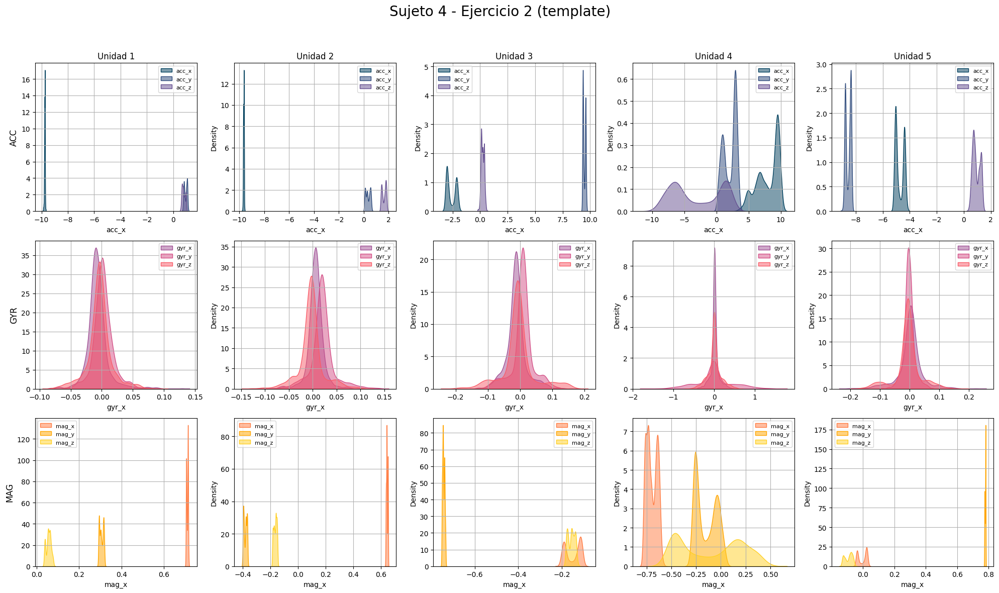

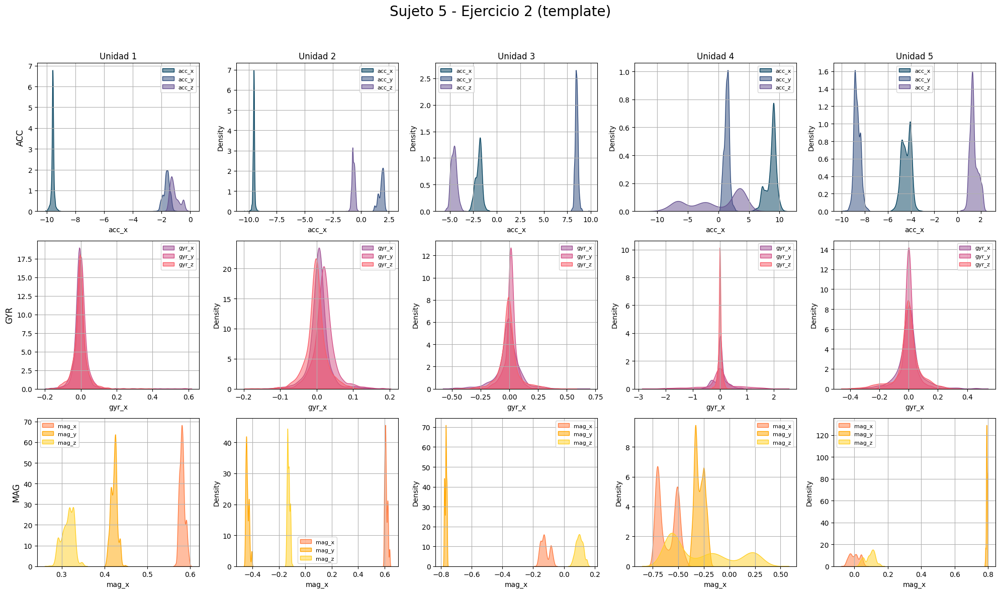

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 2, templates)

En la unidad 1, las distribuciones son muy concentradas con variaciones mínimas, indicando que la rodilla derecha se mantiene estable y actúa como punto de soporte durante el ejercicio, las densidades en el giroscopio están centradas cerca de 0, lo que sugiere que no hubo rotaciones significativas en esta unidad. Además de señales muy consistentes en el magnetómetro, lo que confirma que la orientación magnética de la rodilla derecha no cambió.

Para la segunda unidad, las distribuciones muestran ligeras variaciones, lo que podría estar relacionado con pequeños ajustes posturales o movimientos involuntarios del brazo derecho. En el codo, o tercera unidad, las densidades del acelerómetro presentan más dispersión en comparación con la unidad 2, lo que podría reflejar mayor actividad en el codo como punto de equilibrio durante la inclinación.



In [ ]:
temp = f.stats_por_unidad(2,templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.006921,0.00392,-0.004318,-9.512067,0.352322,-0.47394,0.659888,0.334242,0.137898
Mediana,-0.008068,0.002641,-0.004704,-9.533207,1.024937,-0.72645,0.709466,0.29983,0.109687
Desviación estándar,0.034862,0.038495,0.038859,0.222854,2.278719,0.717935,0.09401,0.150005,0.097661


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.005227,0.020675,-0.00298,-9.602408,0.167304,-0.015894,0.656832,-0.300212,-0.089362
Mediana,0.005337,0.020513,-0.003393,-9.596688,0.228972,-0.580989,0.647689,-0.376215,-0.135287
Desviación estándar,0.032824,0.031647,0.033781,0.100898,1.403836,0.981764,0.050285,0.187195,0.164465


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.006985,0.003047,-0.019992,-1.811427,9.492468,-0.443186,-0.225574,-0.708077,-0.060215
Mediana,0.002167,0.004571,-0.01493,-1.625933,9.700836,0.246319,-0.154159,-0.703192,0.05514
Desviación estándar,0.08031,0.048905,0.070028,0.516049,0.471286,1.833983,0.141036,0.043545,0.184719


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.00897,0.003554,0.002327,8.682101,1.144819,-1.068367,-0.663819,-0.156636,-0.23058
Mediana,0.008577,0.000203,0.003072,9.059381,1.077403,-0.163758,-0.678507,-0.196295,-0.295961
Desviación estándar,0.122227,0.459045,0.092407,1.226649,0.891372,3.975968,0.093511,0.161256,0.289136


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.001239,-0.002013,-0.006179,-2.800657,-8.76137,-0.335887,-0.142841,0.696956,0.110131
Mediana,0.001827,-0.001358,-0.005891,-4.391821,-8.77505,0.535535,-0.026287,0.678733,0.096228
Desviación estándar,0.06293,0.050864,0.063265,3.000858,0.822057,1.517653,0.256615,0.073182,0.185716


En la primera unidad, la rodilla derecha, el acelerómetro presenta media y mediana cercanas a valores bajos, lo que indica estabilidad y poca actividad en esta unidad, las desviaciones estándar son muy pequeñas, reflejando un rol pasivo de soporte. En cuanto al giroscopi y magnetómetro, las distribuciones tienen valores cercanos a 0 con desviaciones estándar muy bajas, indicando que no hubo rotaciones significativas y al ser valores son estables y consistentes, la orientación magnética no cambió.

Para la segunda unidad, la muñeca derecha, se notan ligeras variaciones en los ejes x y y, posiblemente debido a pequeños ajustes en la posición de la muñeca al inclinar el torso. El codo derecho y hombro derecho presentan variaciones similares a la unidad 2. En cuanto al pecho o quinta unidad, las medias y desviaciones estándar en el acelerómetro reflejan una alta actividad en el eje z, lo que es consistente con el movimiento principal de inclinación hacia adelante y retorno a la posición inicial. Los ejes x e y también muestran actividad, probablemente debido a pequeños ajustes posturales. En el giroscipio, las desviaciones estándar son más altas en esta unidad, lo que indica rotaciones asociadas al movimiento del torso, y en elmagnetómetro, las variaciones son más altas en comparación con las demás unidades, reflejando los cambios de orientación del torso durante el movimiento.

Los datos confirman que el torso es el punto de actividad principal en el ejercicio, con el acelerómetro y giroscopio mostrando las mayores variaciones.

### Tercer ejercicio

```{note}
Este ejercicio consiste en acostarse boca arriba sobre una superficie plana. Desde esa posición, debes levantar la pierna derecha desde la articulación de la cadera, manteniendo tanto la rodilla derecha como la pierna izquierda completamente rectas. Luego, sostén la postura durante 5 segundos. Finalmente, regresa la pierna derecha a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en la rodilla derecha, 4 en la rodilla izquierda y 5 en el pecho.
```

![](assets/ex3.png)

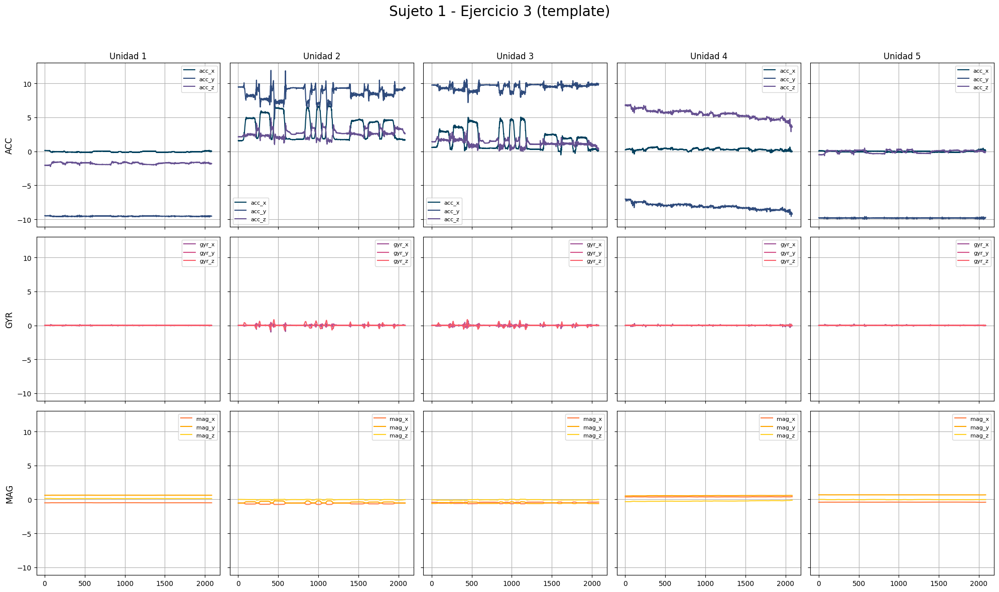

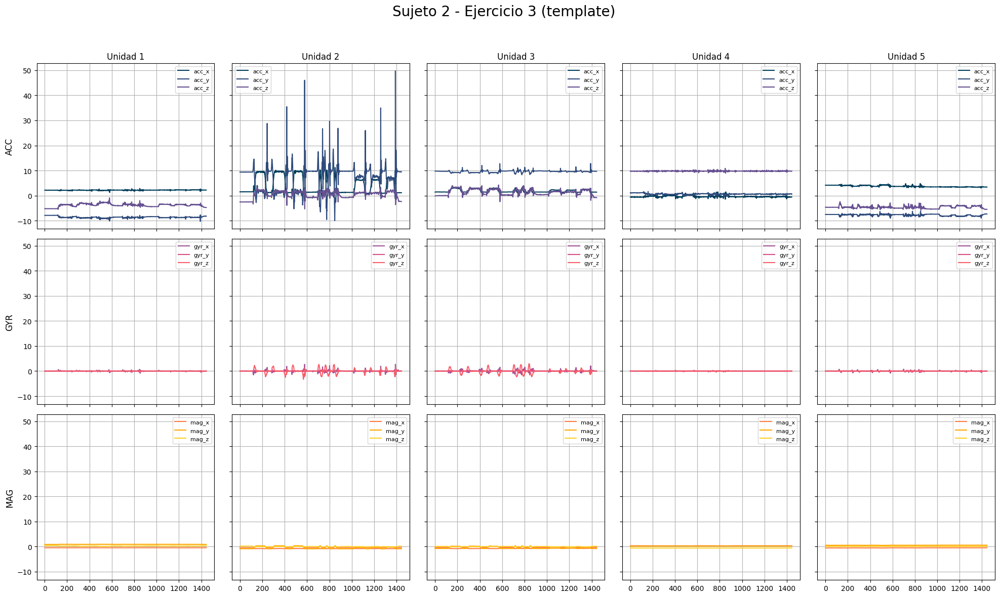

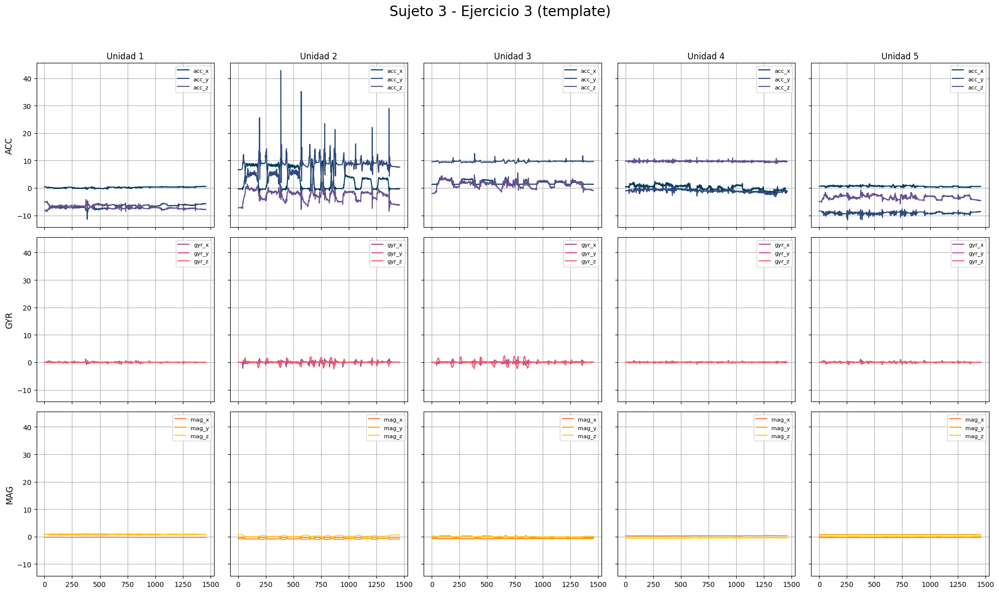

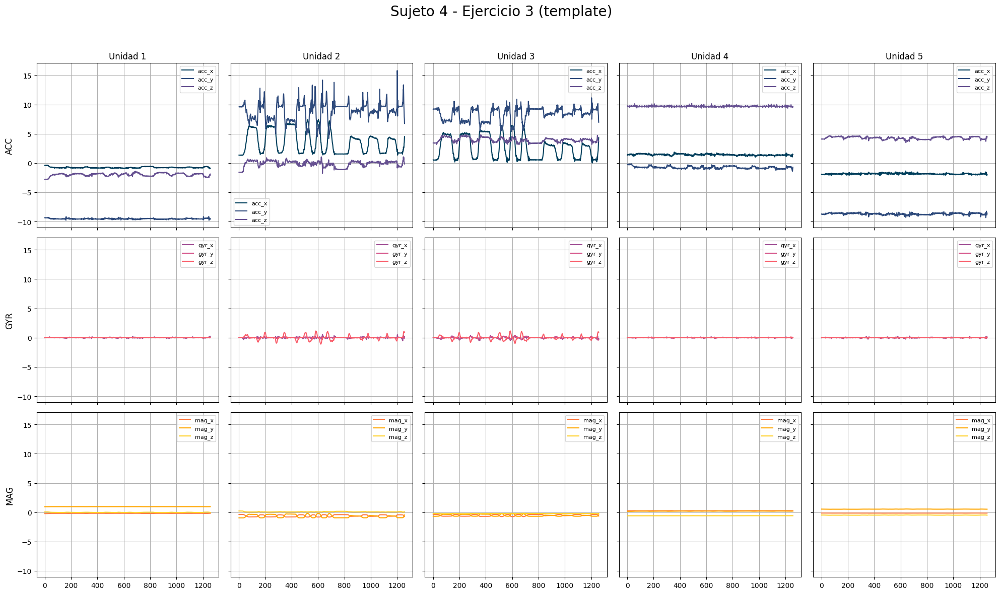

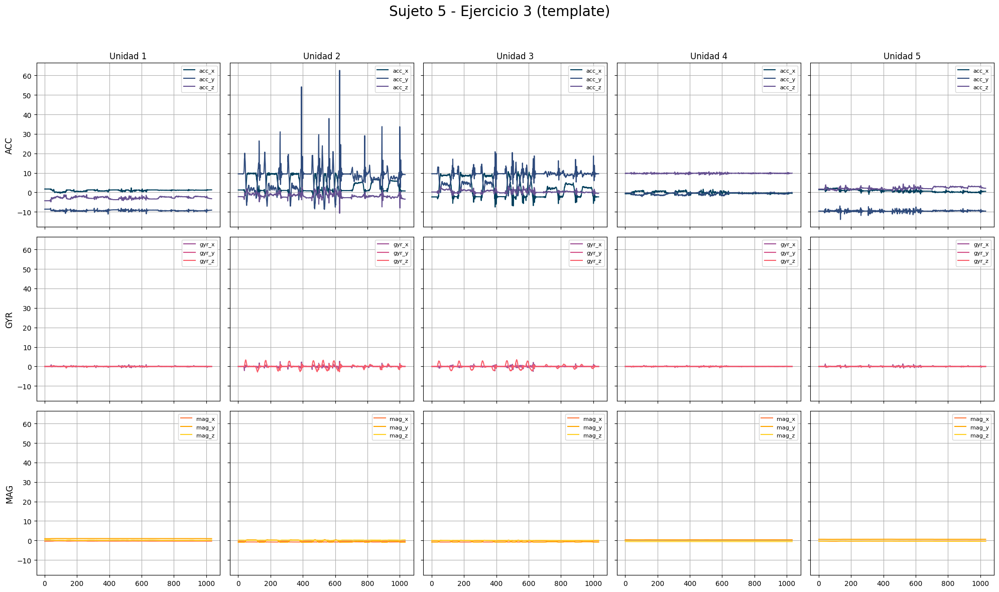

In [ ]:
f.plot_dist(1, 3, templates)
f.plot_dist(2, 3, templates)
f.plot_dist(3, 3, templates)
f.plot_dist(4, 3, templates)
f.plot_dist(5, 3, templates)

Durante la ejecución del tercer ejercicio, las señales obtenidas muestran que el tobillo derecho o unidad 2 registra la mayor variabilidad en el acelerómetro, especialmente en el eje `y`, lo que refleja el movimiento principal de levantamiento y descenso de la pierna derecha desde la cadera. Este comportamiento es consistente con la descripción del ejercicio, donde el tobillo derecho es el punto de mayor actividad. Por otro lado, la rodilla derecha (unidad 3) también muestra una actividad notable, aunque de menor intensidad, reflejando el esfuerzo asociado a mantener la pierna completamente recta durante el movimiento. En contraste, el tobillo izquierdo, rodilla izquierda y pecho presentan señales más estables, como era de esperarse, ya que estas partes del cuerpo permanecen relativamente inmóviles o actúan como soporte durante el ejercicio.

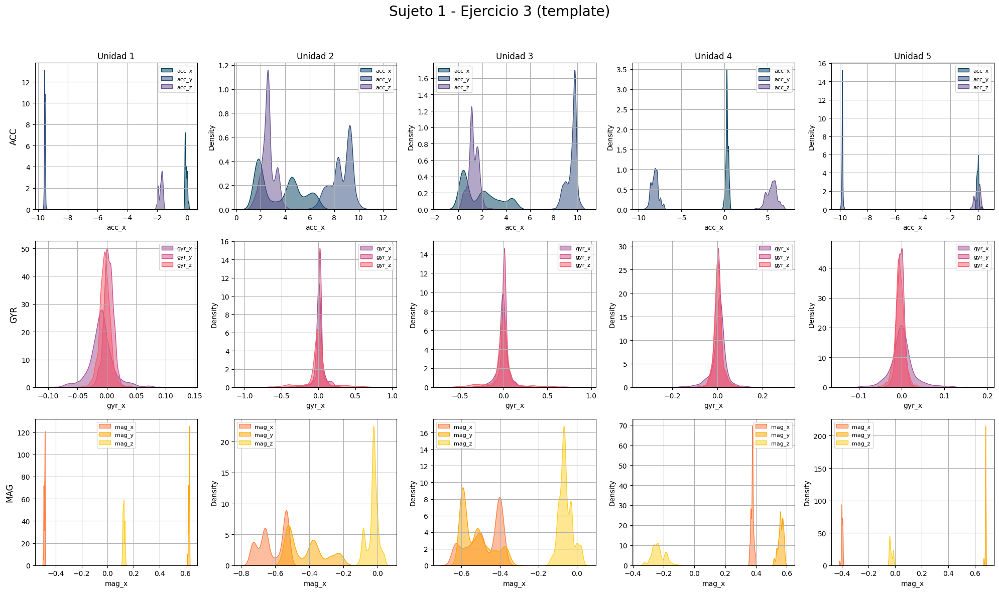

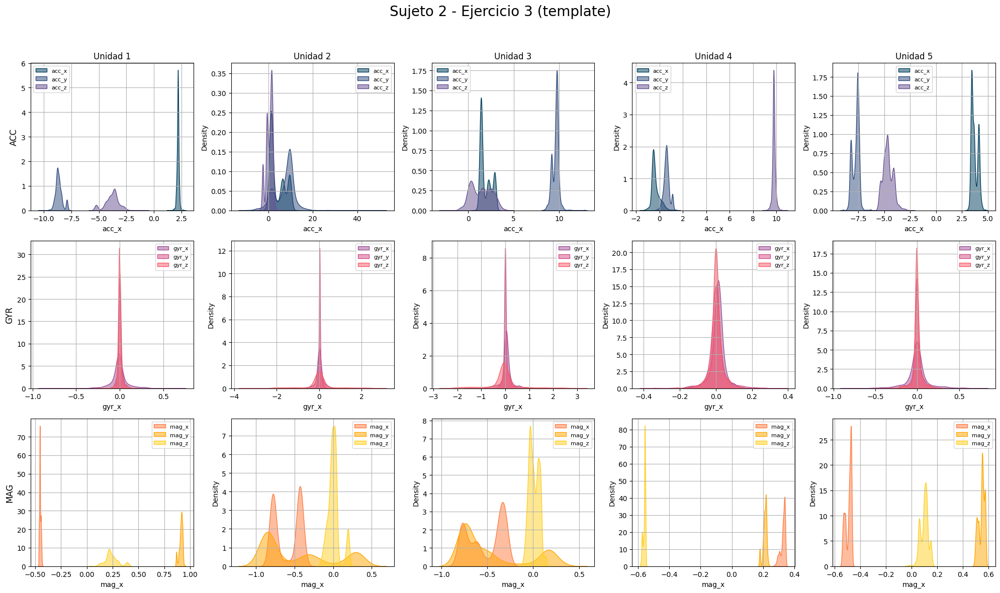

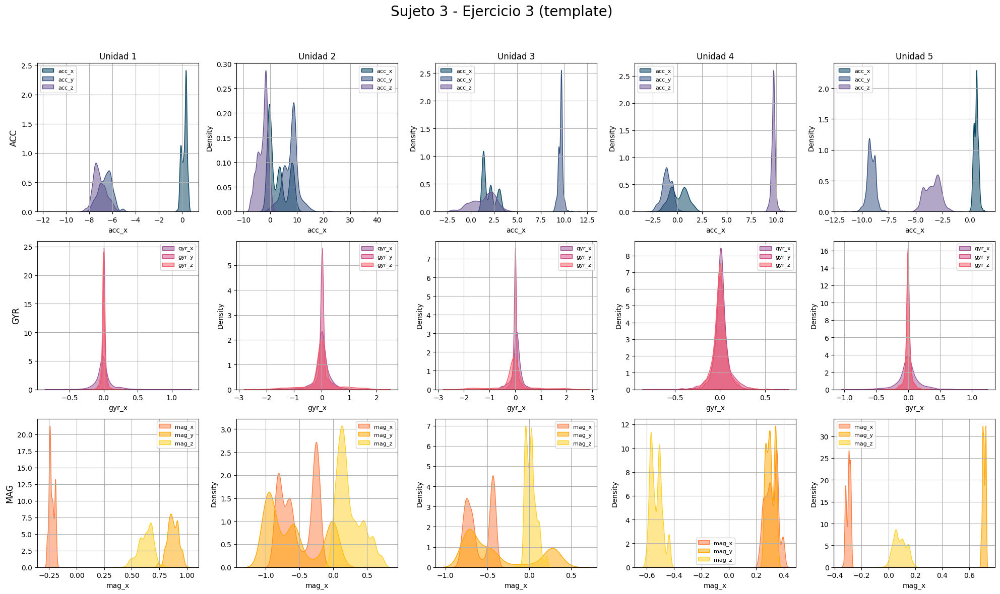

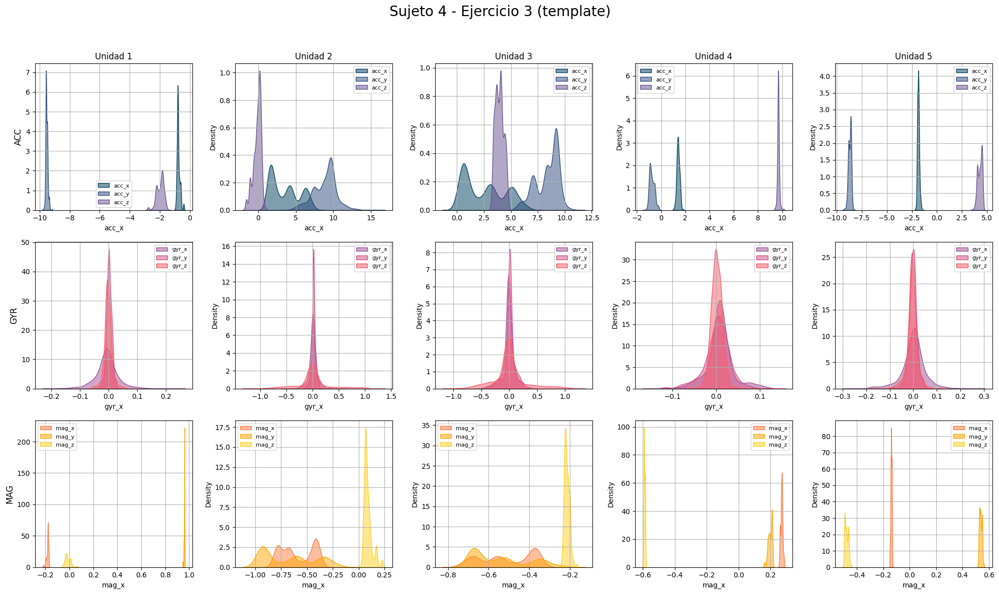

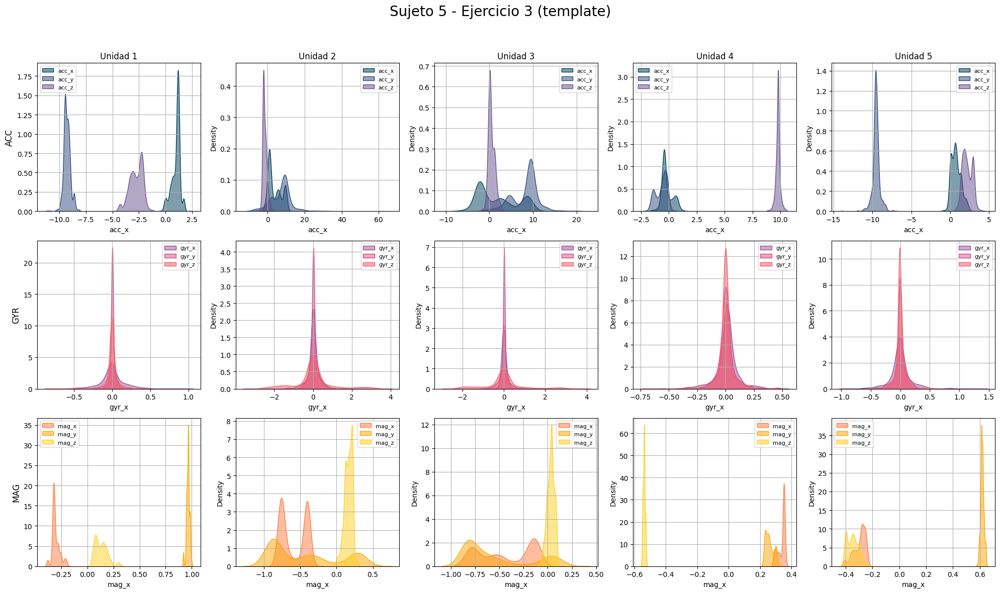

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 3, templates)

El análisis confirma que las unidades 2 y 3 son las más involucradas en el movimiento principal, mientras que las demás unidades actúan como puntos de soporte y estabilización. Este comportamiento es completamente consistente con la naturaleza del ejercicio descrito.

In [ ]:
temp = f.stats_por_unidad(3, templates)

temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.006173,0.002239,-0.003759,0.454445,-8.740137,-3.424129,-0.349173,0.83737,0.224786
Mediana,-0.009018,0.002138,-0.003915,0.036086,-9.422724,-2.356303,-0.330465,0.907531,0.131622
Desviación estándar,0.108195,0.023377,0.036051,1.006954,1.162316,2.044203,0.12665,0.139945,0.22045


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.005463,0.023552,-0.001944,3.523818,8.02174,-0.001215,-0.586082,-0.505464,0.079228
Mediana,0.006947,0.019714,-0.003611,2.771555,8.728392,0.088897,-0.625973,-0.523481,0.048867
Desviación estándar,0.251922,0.119331,0.581666,2.877375,3.605163,2.317971,0.169588,0.356637,0.139426


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.008781,0.007313,-0.019913,1.973588,9.163748,1.650512,-0.511142,-0.484654,-0.044651
Mediana,0.002618,0.004353,-0.021097,1.648724,9.565624,1.427833,-0.496226,-0.570872,-0.034433
Desviación estándar,0.21081,0.096521,0.58686,2.106246,1.43251,1.390169,0.172833,0.296314,0.095234


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.007266,0.003036,0.001286,0.248173,-2.647943,8.516944,0.329147,0.334318,-0.463428
Mediana,0.008885,0.002638,0.000463,0.24192,-0.917765,9.66997,0.338745,0.269273,-0.543905
Desviación estándar,0.059174,0.065214,0.04802,0.74981,3.530576,1.954218,0.043084,0.149026,0.148606


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.00053,-0.002466,-0.00492,0.636994,-9.039432,-0.567584,-0.338296,0.625453,-0.104378
Mediana,-0.001412,-0.002518,-0.005765,0.256263,-9.210984,-0.099232,-0.362024,0.6341,-0.028473
Desviación estándar,0.131853,0.050292,0.044114,1.781174,0.806533,3.217269,0.116869,0.071568,0.224148


El tobillo izquerdo o unidad 1 mostró un comportamiento estable durante el ejercicio, actuando como soporte. Las señales del acelerómetro presentan medias y medianas cercanas a cero, con desviaciones estándar bajas en todos los ejes, excepto ligeros ajustes en el eje z, posiblemente debido a compensaciones menores al sostener la posición. El giroscopio confirma esta estabilidad con rotaciones insignificantes y señales centradas en cero. El magnetómetro presenta señales constantes y de baja dispersión, indicando que la orientación del tobillo izquierdo permaneció fija durante todo el ejercicio. La rodilla izquierda actuó como un punto de soporte pasivo durante el ejercicio. Las señales del acelerómetro son estables, con medias cercanas a cero y desviaciones estándar bajas en todos los ejes, lo que indica que permaneció prácticamente inmóvil. Las señales del giroscopio también muestran rotaciones mínimas, confirmando su papel estático. El magnetómetro refleja una orientación estable y constante, con poca variabilidad en las señales, lo que sugiere que la rodilla izquierda no experimentó cambios significativos durante el ejercicio. El pecho, actuando como soporte general para el cuerpo, mostró actividad mínima durante el ejercicio. Las señales del acelerómetro reflejan pequeños ajustes posturales, especialmente en los ejes x y z, probablemente para mantener la estabilidad del torso mientras se realiza el movimiento. El giroscopio muestra desviaciones estándar muy bajas, lo que confirma que no hubo rotaciones significativas en esta unidad. El magnetómetro presenta señales estables y bien definidas, indicando que la orientación del torso permaneció constante a lo largo del ejercicio.


El tobillo derecho, involucrado directamente en el movimiento principal, mostró una alta actividad en el acelerómetro, particularmente en el eje z, que capturó el levantamiento y descenso de la pierna. La desviación estándar es notable en este eje, lo que refleja la variabilidad inherente al movimiento dinámico. Aunque los ejes x e y son menos activos, también registran pequeñas variaciones. Las señales del giroscopio reflejan rotaciones moderadas asociadas con el control del movimiento. El magnetómetro muestra mayor dispersión, particularmente en los ejes x y z, lo que indica cambios de orientación del tobillo durante el levantamiento y descenso. La rodilla derecha desempeñó un papel crucial en el ejercicio, como lo muestran las señales del acelerómetro, con altas medias y desviaciones estándar en los ejes x y z, que reflejan la elevación de la pierna y su mantenimiento en posición. El giroscopio indica rotaciones más evidentes en comparación con otras unidades, especialmente en el eje z, que podrían estar relacionadas con ajustes posturales para sostener la pierna. El magnetómetro muestra dispersión en sus señales, consistente con los cambios de orientación de la rodilla durante el movimiento.

### Cuarto ejercicio

```{note}
Este ejercicio consiste en acostarse sobre el lado izquierdo en una superficie plana. Desde esa posición, debes levantar la pierna derecha desde la articulación de la cadera, manteniendo tanto la rodilla derecha como la pierna izquierda completamente rectas. Luego, sostén la postura durante 5 segundos. Finalmente, regresa la pierna derecha a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en la rodilla derecha, 4 en la rodilla izquierda y 5 en el pecho.
```

![](assets/ex4.png)

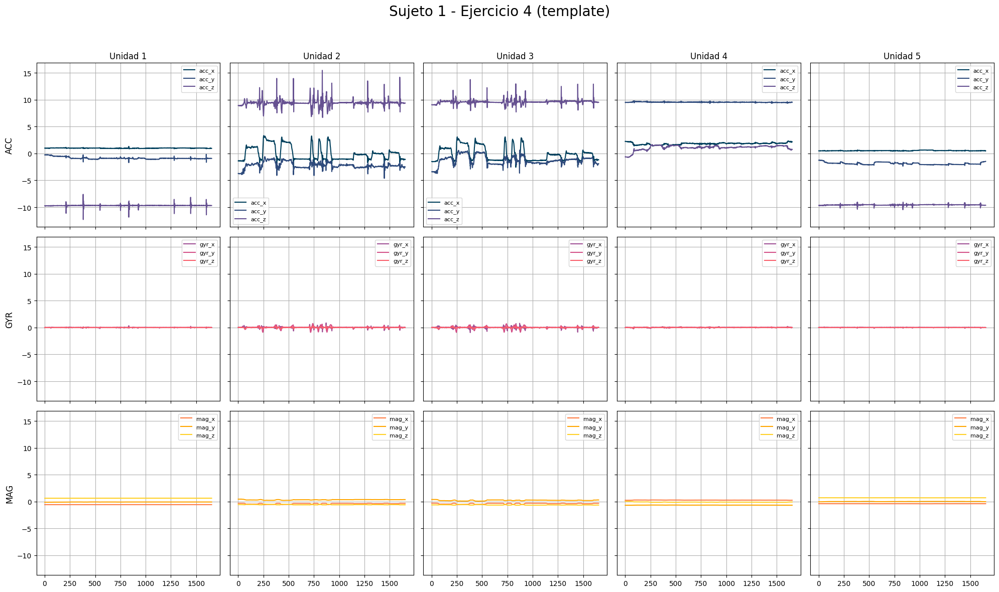

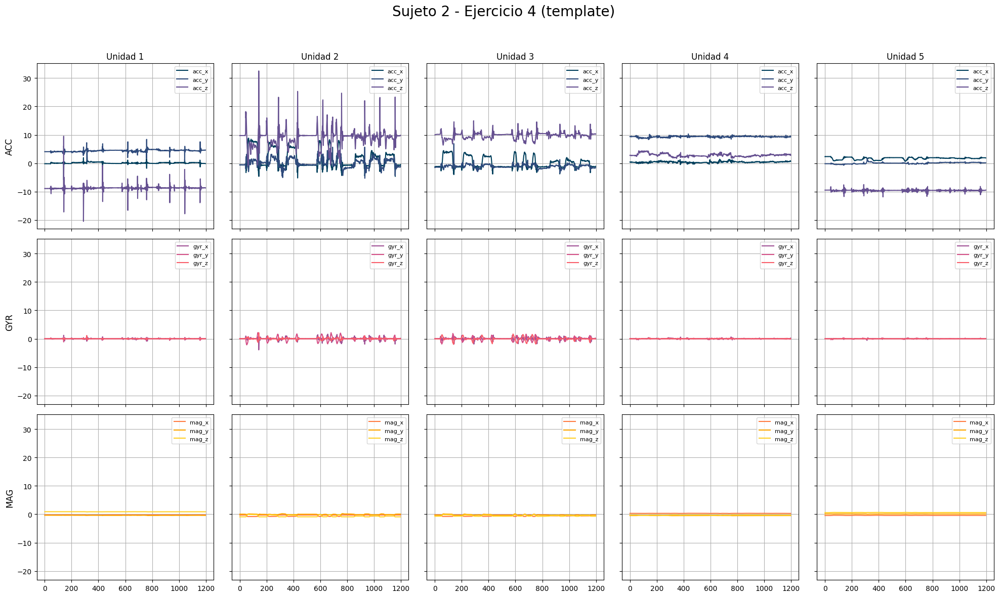

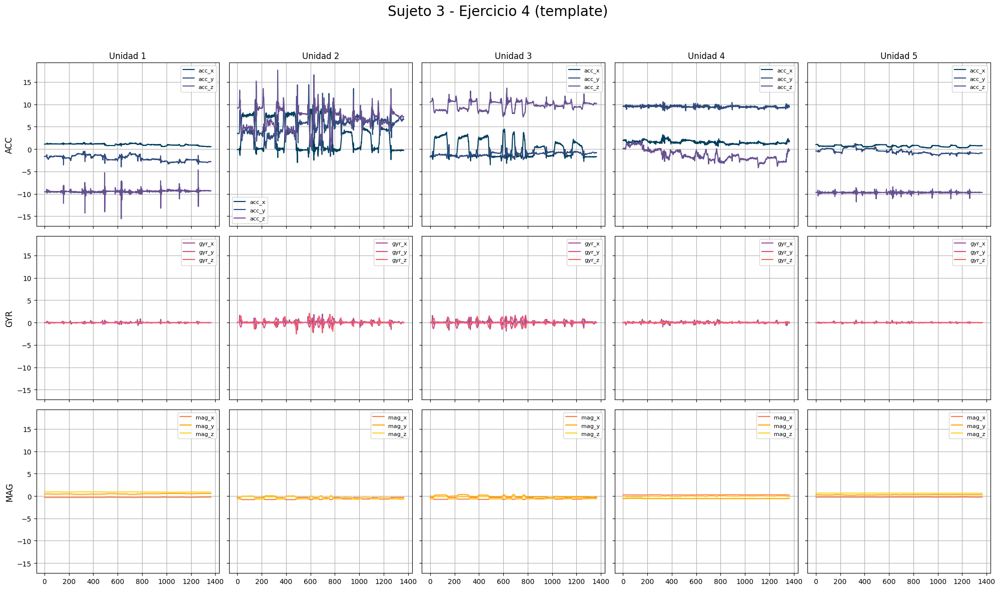

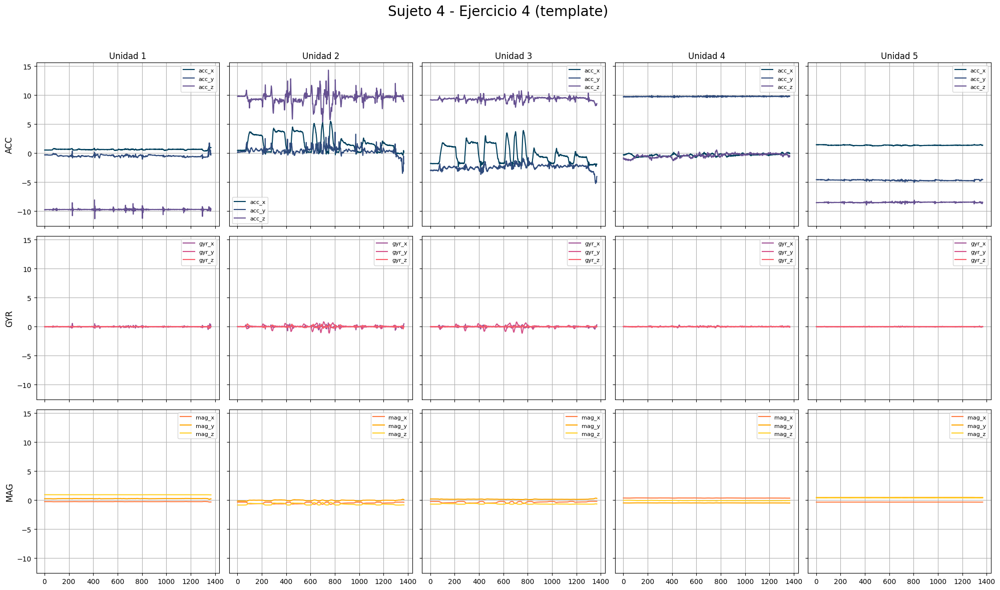

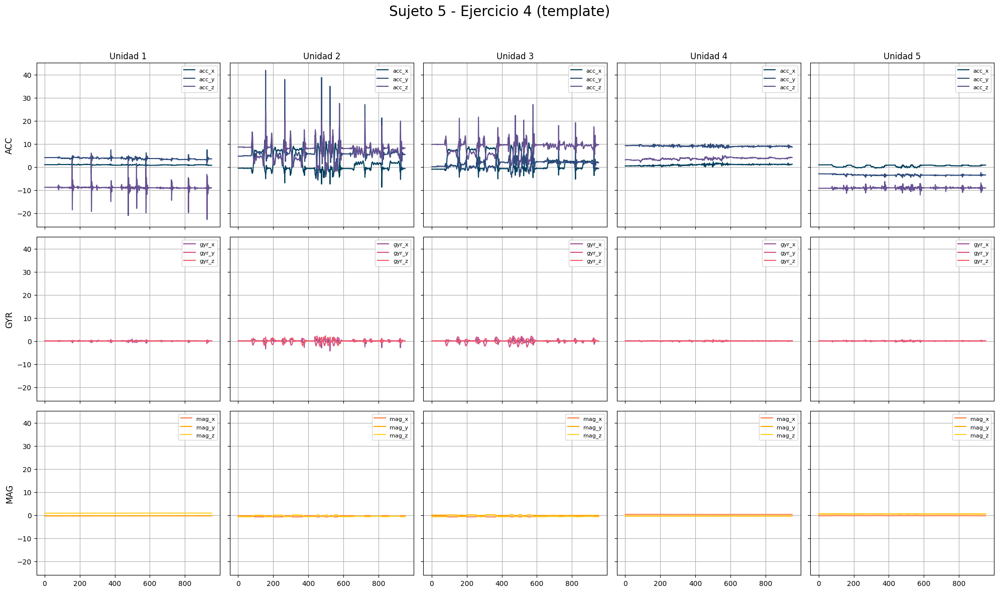

In [ ]:
f.plot_dist(1, 4, templates)
f.plot_dist(2, 4, templates)
f.plot_dist(3, 4, templates)
f.plot_dist(4, 4, templates)
f.plot_dist(5, 4, templates)

Al igual que con el ejercicio anterior, el análisis de las señales destacan una mayor actividad en las unidades 2 y 3, mientras que las demás unidades presentan menor variabilidad, consistente con su rol de soporte estático.

La unidad 2 muestra picos notables en el eje z del acelerómetro, reflejando el movimiento vertical de levantamiento y descenso de la pierna. Asimismo, en la unidad 3, se observa actividad destacada en los ejes y y z, relacionada con la estabilización y control de la pierna al mantenerla recta durante el movimiento. En contraste, las Unidades 1 y 4 (tobillo izquierdo y rodilla izquierda, respectivamente) presentan señales más estables, ya que estas partes del cuerpo permanecen mayormente inmóviles, sirviendo como soporte. Por otro lado, la unidad 5 (pecho) registra actividad baja y consistente en todos los ejes, lo cual se alinea con la expectativa de que esta parte del cuerpo permanece estática durante el ejercicio.

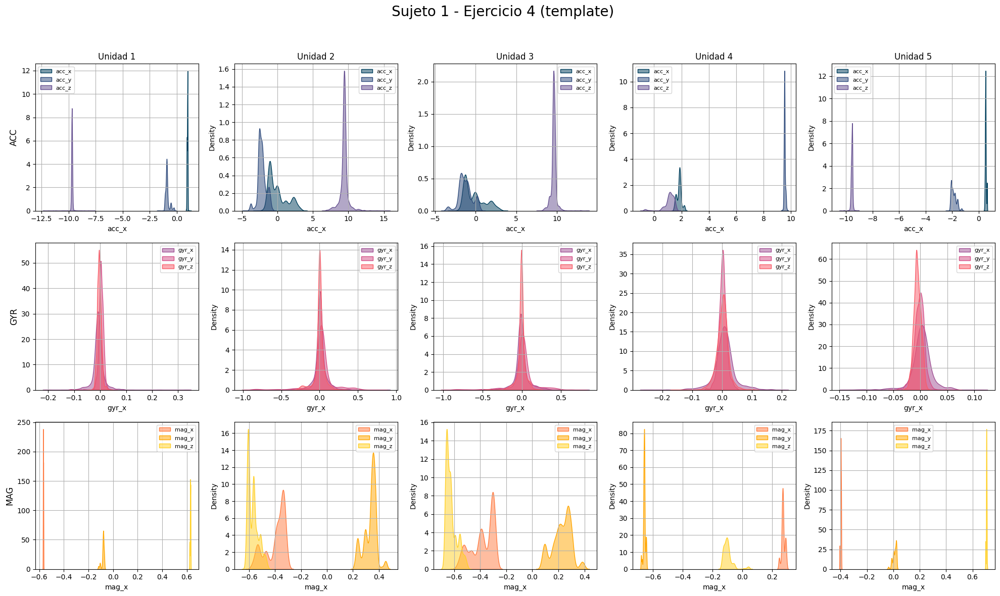

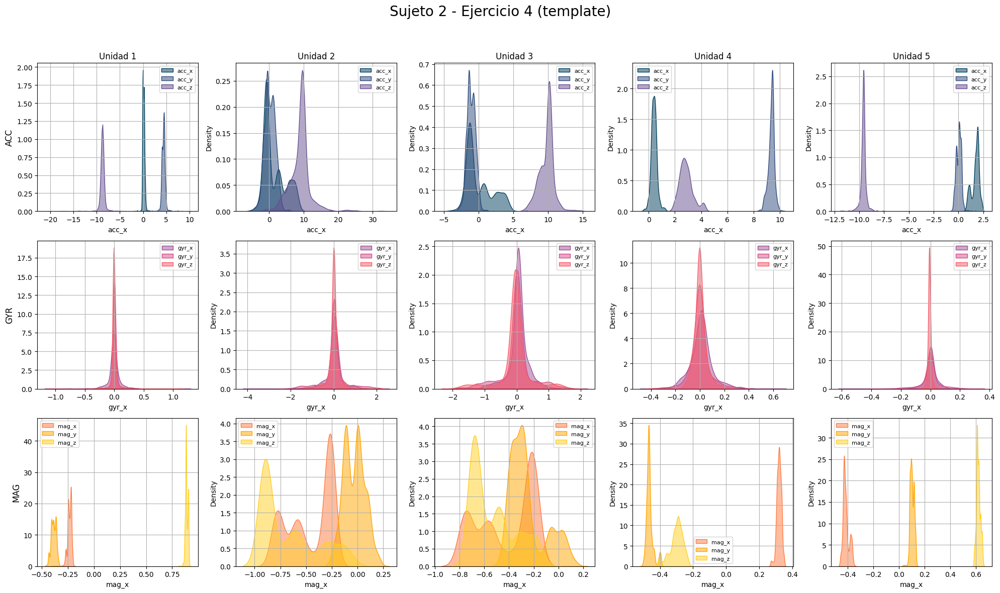

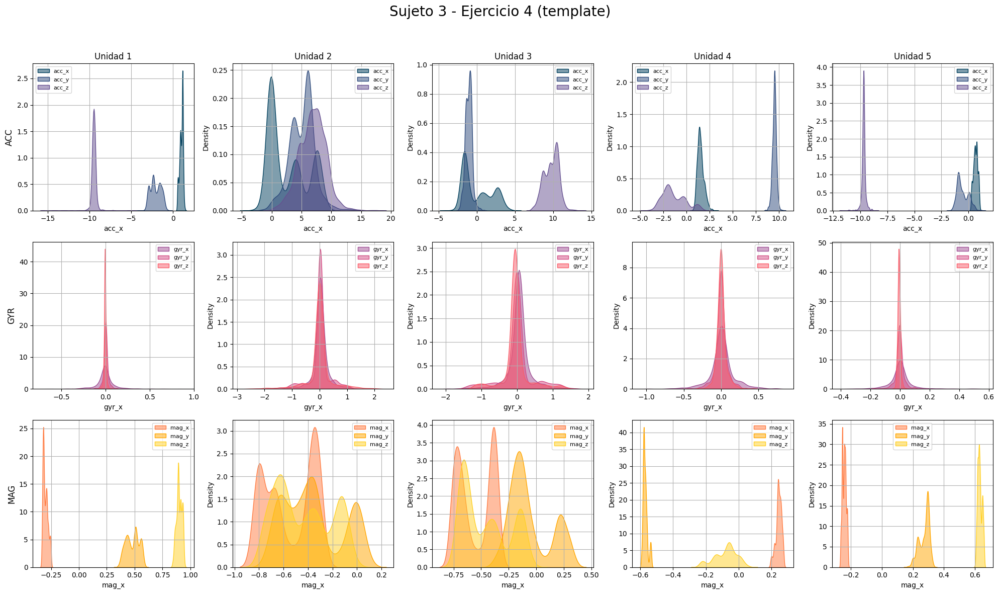

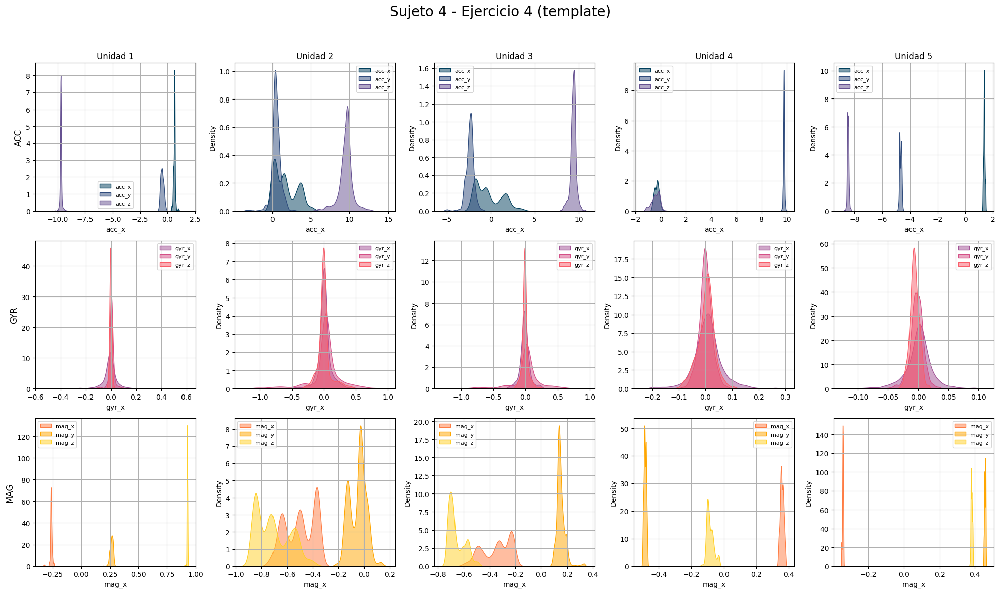

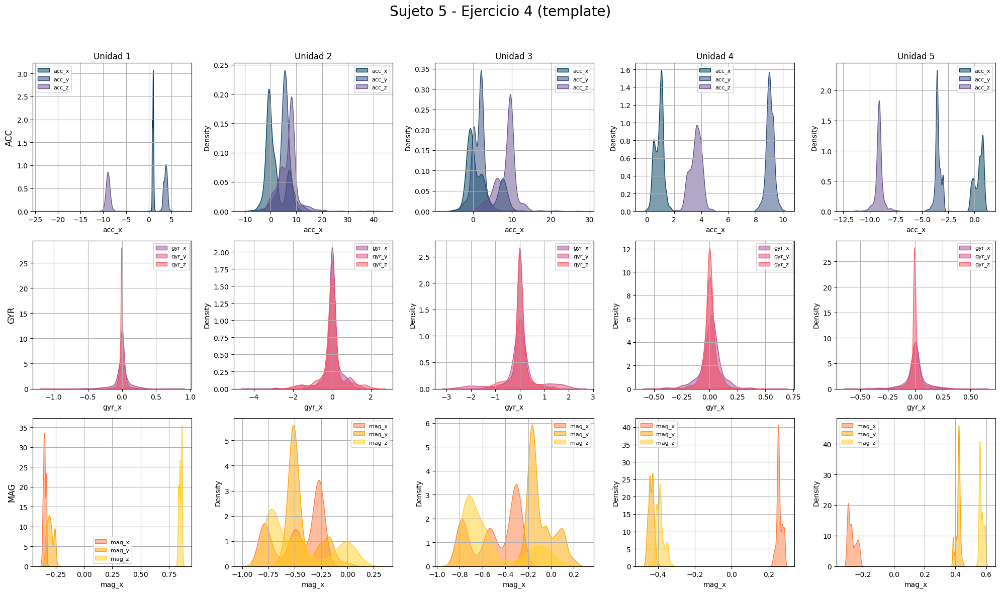

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 4, templates)

En cuanto a las unidades 1 y 4, las señales son estables y consistentes, con poca variabilidad en los acelerómetros, giroscopios y magnetómetros, estas unidades actúan como puntos de soporte pasivo, con cambios mínimos durante el ejercicio. En las unidades 2 y 3, las señales presentan mayores variaciones, especialmente en los acelerómetros y giroscopios, esto es coherente con el papel activo de estas unidades en el levantamiento y descenso controlado de la pierna derecha. La actividad en el pecho es limitada, con señales principalmente estables, reflejando su rol en la estabilización general del torso durante el ejercicio.

Aunque el patrón general de las señales es similar, hay diferencias en la amplitud y dispersión de los datos. Esto puede deberse a que algunos participantes muestran una mayor estabilidad en el movimiento o diferencias en la ejecución del molvimiento.

In [ ]:
temp = f.stats_por_unidad(4, templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.00672,0.002553,-0.004199,0.741896,0.585781,-9.376544,-0.355458,0.019857,0.827244
Mediana,-0.007088,0.00296,-0.00418,0.880537,-0.553284,-9.604019,-0.309241,-0.077301,0.881322
Desviación estándar,0.09885,0.053121,0.031459,0.377151,2.531922,0.831034,0.12884,0.323999,0.118512


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.008275,0.0174,-0.004231,1.404896,1.489271,8.416667,-0.472469,-0.070819,-0.57369
Mediana,0.007794,0.023922,-0.000988,0.245868,0.578145,9.239168,-0.403689,-0.034923,-0.600807
Desviación estándar,0.295276,0.386438,0.339342,2.754925,3.541923,2.516519,0.173854,0.31055,0.227171


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.012383,0.002397,-0.022837,0.21849,-1.031991,9.457278,-0.43543,0.015857,-0.564081
Mediana,0.002989,0.009258,-0.013935,-0.553872,-1.266548,9.560234,-0.390769,0.099936,-0.632241
Desviación estándar,0.257214,0.42937,0.308532,2.154675,1.477441,1.302125,0.173956,0.213364,0.178247


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.008181,0.001251,0.001872,0.912423,9.464533,0.946057,0.29074,-0.535961,-0.170466
Mediana,0.008889,0.001321,0.001803,1.067163,9.517756,1.092793,0.274678,-0.494388,-0.109846
Desviación estándar,0.101977,0.061402,0.047277,0.852746,0.287053,1.915765,0.044127,0.084203,0.1278


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.00102,-0.002524,-0.006182,0.927887,-2.068603,-9.308691,-0.339001,0.233786,0.586086
Mediana,0.001842,-0.002046,-0.006453,0.766468,-1.878629,-9.532468,-0.346495,0.257757,0.618777
Desviación estándar,0.057739,0.050814,0.012875,0.551801,1.763369,0.521506,0.068335,0.178952,0.114926


El tobillo izquierdo presenta una actividad mínima en todas las señales, con valores de media y mediana cercanos a cero y desviaciones estándar bajas. Esto refleja su rol pasivo como punto de soporte durante el ejercicio. Las pequeñas variaciones observadas podrían ser atribuibles a ajustes menores en la estabilidad del cuerpo. La rodilla izquierda, que sirve como soporte, tiene señales estables con poca variabilidad en todas las mediciones. Las medias y medianas son bajas, confirmando su rol estático durante el ejercicio. Las desviaciones estándar también son consistentes con la estabilidad de esta unidad. El pecho muestra señales similares a las unidades de soporte. Las desviaciones estándar son bajas en todas las mediciones, indicando estabilidad durante la ejecución del ejercicio. Pequeñas variaciones en el acelerómetro podrían deberse a ajustes posturales para mantener el equilibrio del torso.

El tobillo derecho, siendo parte del movimiento principal, muestra una actividad elevada en el acelerómetro, especialmente en el eje z, correspondiente a la elevación de la pierna derecha. El giroscopio y magnetómetro también reflejan una mayor variabilidad en comparación con las otras unidades, lo que es coherente con el movimiento dinámico del tobillo en este ejercicio. Las desviaciones estándar son particularmente altas en los acelerómetros, lo que indica un rango amplio de movimiento. La rodilla derecha, que es clave en la ejecución del ejercicio, muestra patrones similares al tobillo derecho, con altas desviaciones estándar en el acelerómetro, reflejando la dinámica del movimiento. Las señales del giroscopio presentan mayor actividad, particularmente en los ejes relacionados con la flexión y extensión. El magnetómetro muestra dispersión en las señales, reflejando cambios en la orientación de la rodilla durante el levantamiento y descenso de la pierna.



### Quinto ejercicio

```{note}
Este ejercicio consiste en acostarse boca abajo en una superficie plana. Desde esa posición, debes levantar la pierna derecha desde la articulación de la cadera, manteniendo tanto la rodilla derecha como la pierna izquierda completamente rectas. Luego, sostén la postura durante 5 segundos. Finalmente, regresa la pierna derecha a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en la rodilla derecha, 4 en la rodilla izquierda y 5 en el pecho.
```
![](assets/ex5.png)


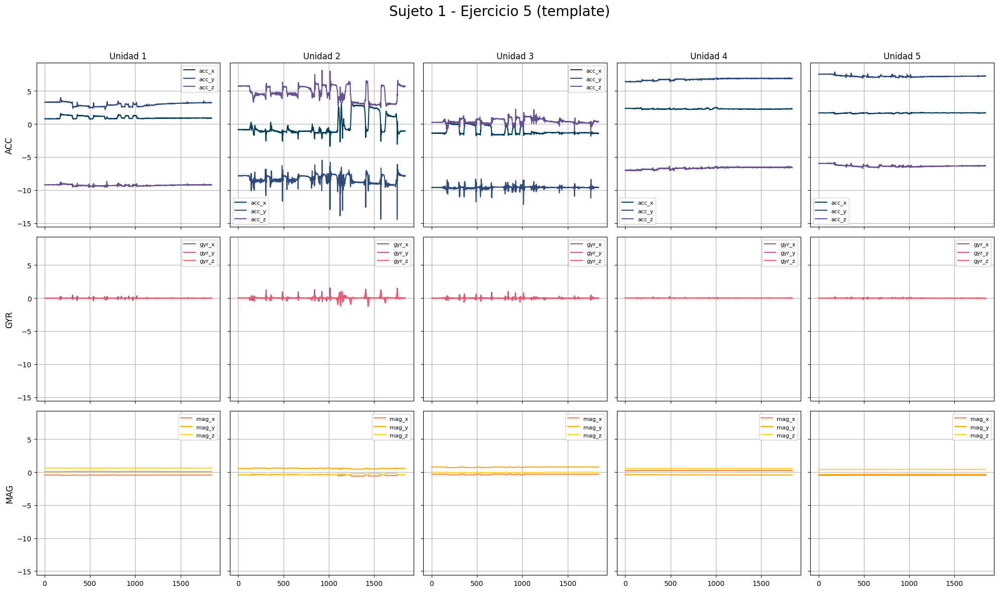

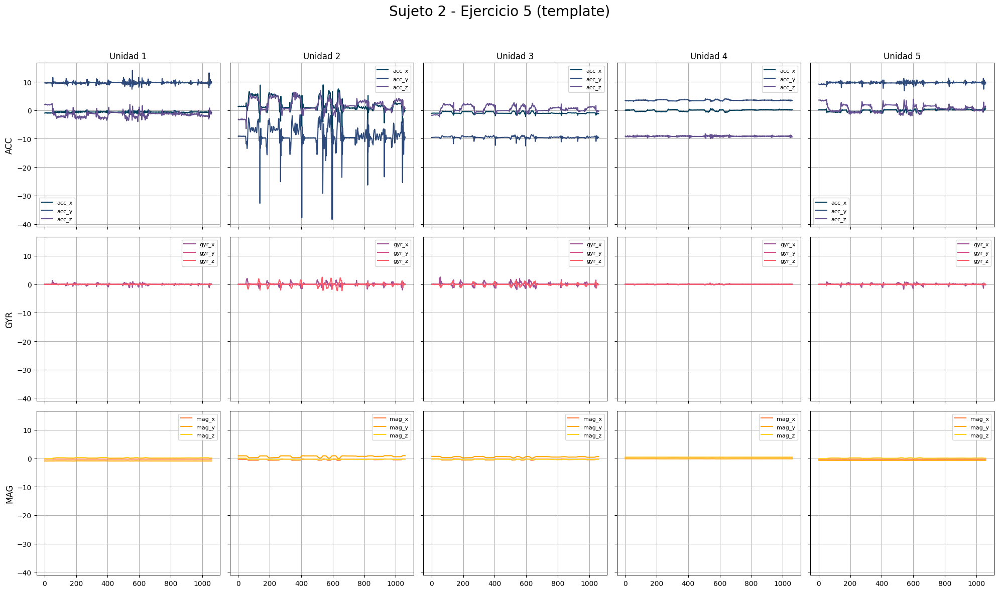

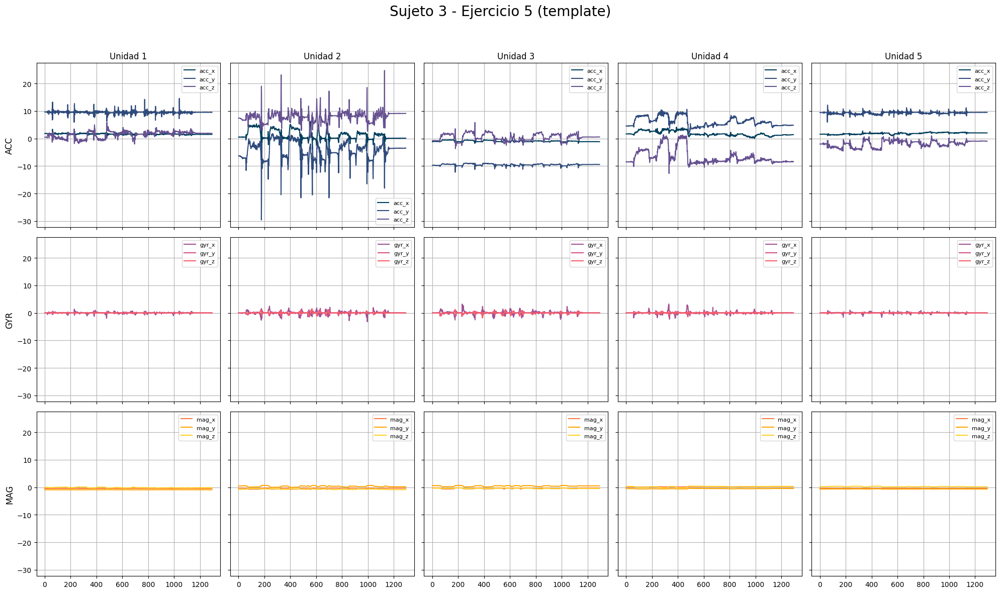

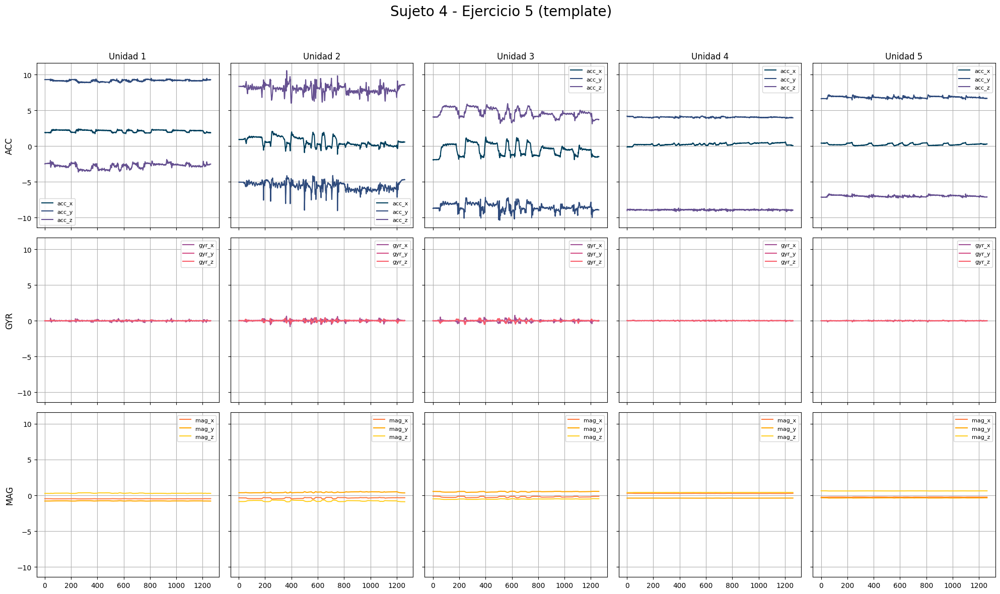

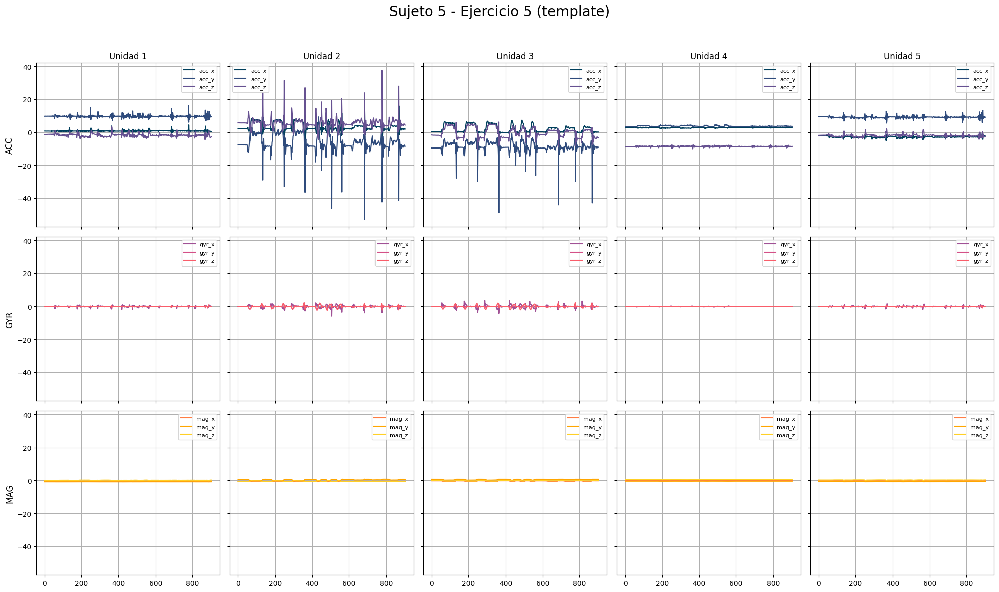

In [ ]:
f.plot_dist(1, 5, templates)
f.plot_dist(2, 5, templates)
f.plot_dist(3, 5, templates)
f.plot_dist(4, 5, templates)
f.plot_dist(5, 5, templates)


En este ejercicio, los datos reflejan un patrón claro relacionado con la naturaleza del movimiento descrito. El levantamiento de la pierna derecha desde la articulación de la cadera genera variaciones significativas en las señales del acelerómetro, particularmente en el sensor ubicado en el tobillo derecho y el sensor de la rodilla derecha, que están directamente involucrados en el movimiento activo del ejercicio. El sensor ubicado en el pecho también muestra actividad moderada en el acelerómetro, especialmente en los ejes x y y, lo que sugiere un ligero ajuste postural durante la ejecución del ejercicio. Las señales del giroscopio (GYR) son más sutiles, con una ligera variación en los sensores del tobillo derecho y la rodilla derecha, indicando pequeños movimientos rotacionales durante el levantamiento y descenso de la pierna. Las mediciones son coherentes con la descripción del ejercicio y confirman la naturaleza lineal del movimiento, con poca actividad rotacional o magnética.

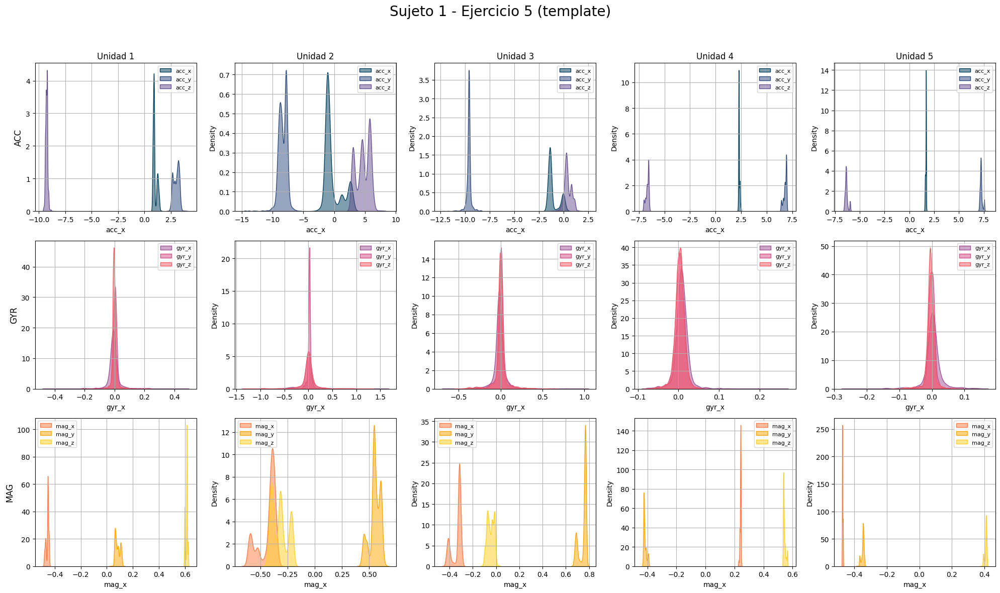

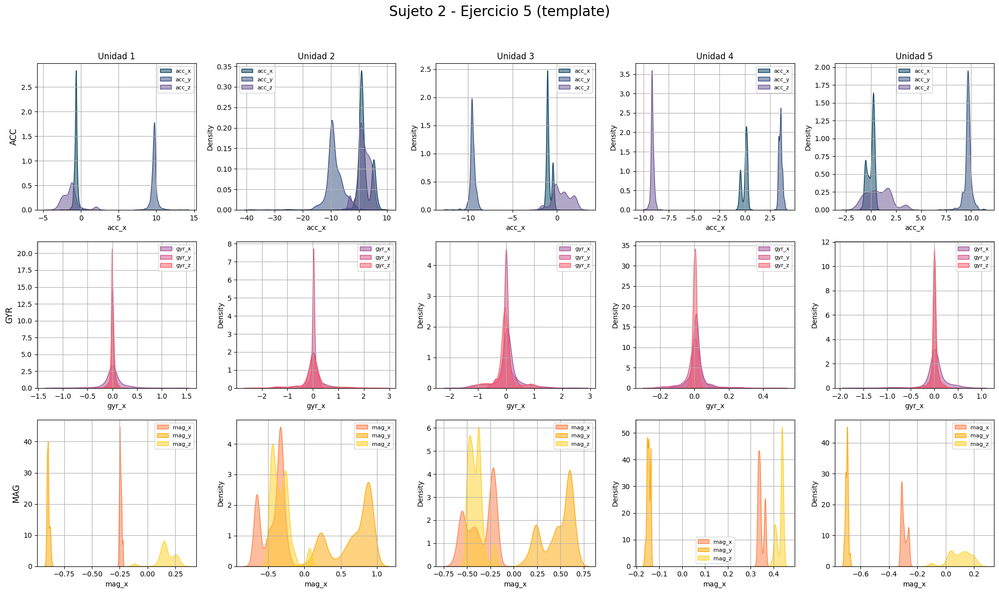

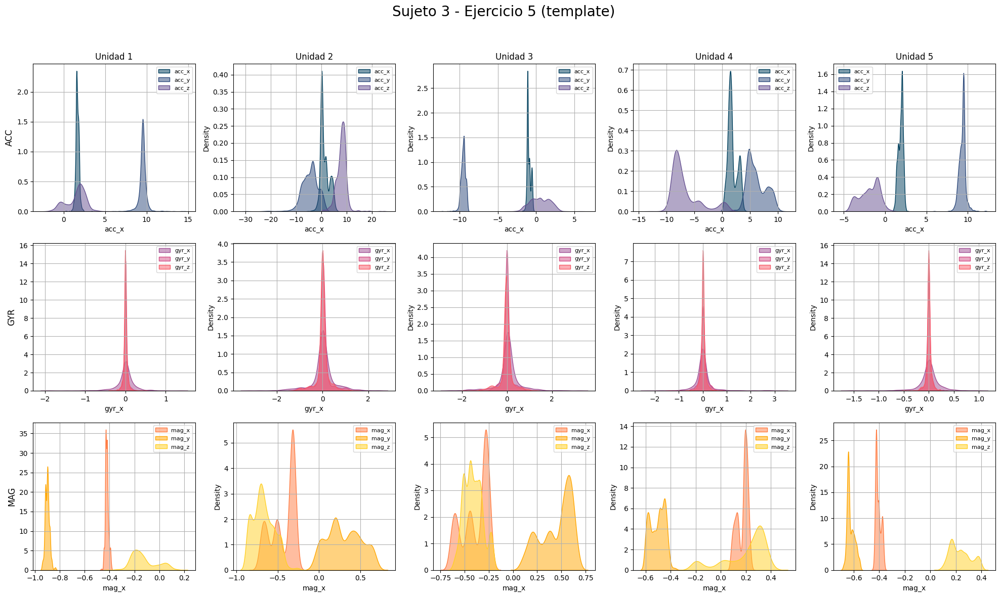

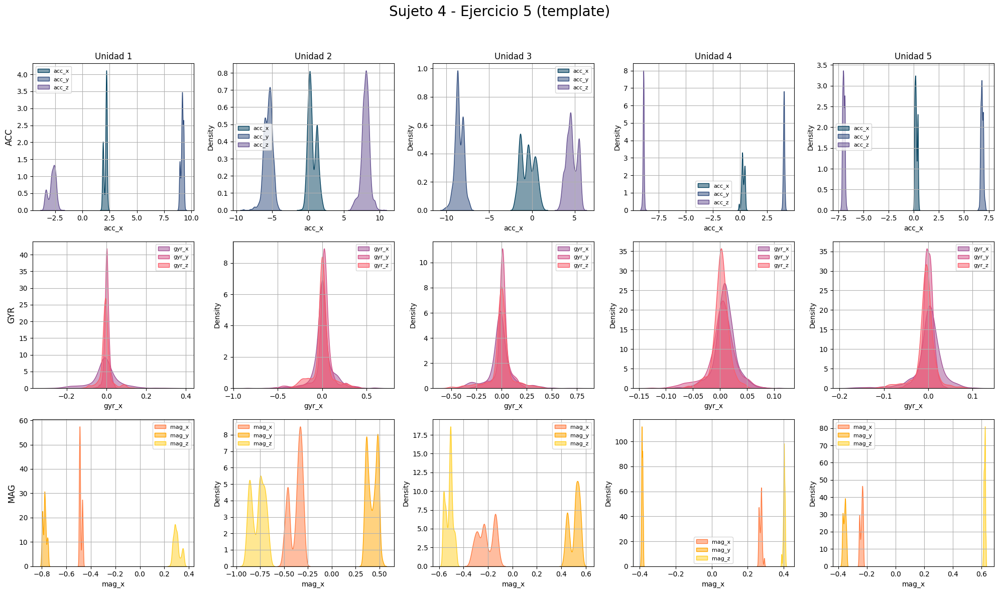

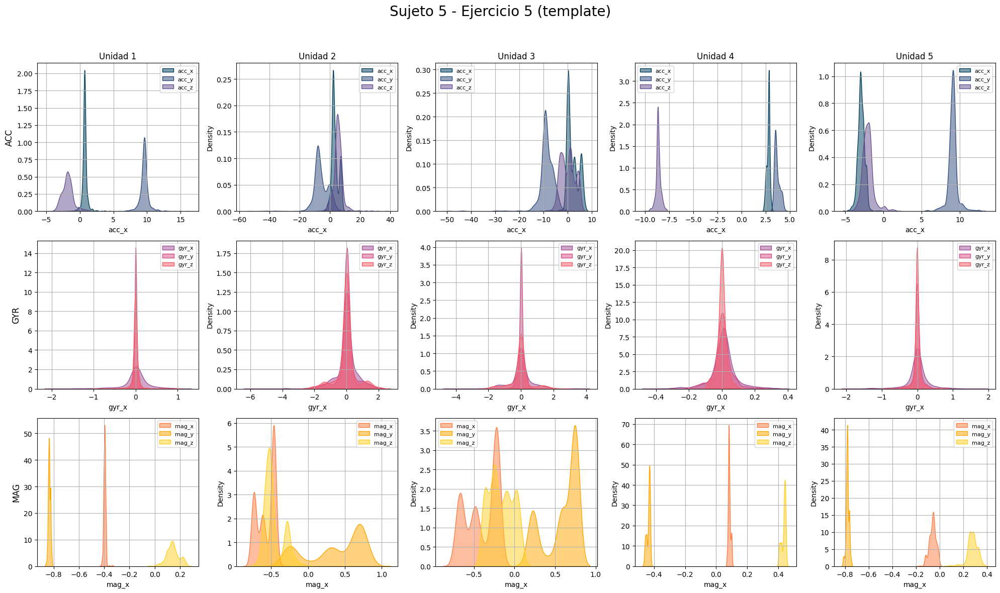

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 5, templates)

La unidad en el tobillo y rodilla izquierda, 1 y 4 respectivamente, en el acelerómetro las señales son muy estables, con densidades concentradas alrededor de valores bajos o cercanos a cero. Esto refleja el rol pasivo de estas unidades, que sirven como soporte durante el ejercicio. Las distribuciones en el giroscopio son muy estrechas y centradas en cero, indicando rotaciones insignificantes en estas áreas. Las señales en el magnetómetro tienen poca variabilidad, indicando que la orientación de estas unidades no cambió significativamente. En el pecho, o unidad 5, en el aceleróemtro las densidades son estrechas con valores bajos, indicando pequeños ajustes posturales para mantener la estabilidad del torso.

En cuanto a la unidad 2 y 3, correspondientes al tobillo y rodilla derecha, en el acelerómetro muestran las mayores variaciones. Las densidades están distribuidas en rangos más amplios, con picos que reflejan las diferentes fases del movimiento (levantamiento, sostén y descenso de la pierna). En el giroscopio, las densidades son más amplias comparadas con las unidades de soporte, indicando rotaciones moderadas en estas áreas durante el movimiento dinámico. Se observa mayor dispersión en las señales del magnetómetro, particularmente en los ejes x y z, reflejando los cambios de orientación asociados al movimiento de la pierna derecha.


In [ ]:
temp = f.stats_por_unidad(5, templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.005279,0.003121,-0.00462,1.023084,7.590599,-3.425876,-0.411113,-0.580744,0.259319
Mediana,-0.005029,0.002525,-0.004418,0.991413,9.239965,-2.488083,-0.440569,-0.822201,0.264196
Desviación estándar,0.20109,0.040485,0.049297,0.925424,2.978701,4.07216,0.080557,0.426083,0.270893


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.005182,0.020771,-0.00289,1.087619,-6.759683,5.618384,-0.443575,0.467864,-0.504911
Mediana,0.004547,0.020858,0.000458,0.629865,-7.48143,5.734184,-0.402516,0.49166,-0.467028
Desviación estándar,0.422513,0.251122,0.379147,2.087666,3.353341,2.906198,0.125747,0.241775,0.213834


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.005015,0.007174,-0.022431,-0.48243,-9.241229,1.218006,-0.338451,0.56823,-0.293228
Mediana,-0.005153,0.005002,-0.008512,-1.000873,-9.503871,0.673967,-0.311467,0.583148,-0.358073
Desviación estándar,0.429086,0.157366,0.319311,1.440524,1.43802,2.178651,0.134026,0.176422,0.203202


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T


,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.009142,0.003332,0.001911,1.471169,5.111747,-7.803397,0.228177,-0.386632,0.410379
Mediana,0.008236,0.003909,0.002249,1.818278,4.144243,-8.541441,0.241873,-0.420262,0.430445
Desviación estándar,0.202359,0.08767,0.053005,1.13055,1.605796,1.688592,0.081506,0.117189,0.142634


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.001924,-0.001757,-0.005493,0.485463,8.241637,-3.78197,-0.324297,-0.525536,0.34504
Mediana,0.002787,-0.001636,-0.005024,0.462983,8.315906,-3.904922,-0.318202,-0.571898,0.37907
Desviación estándar,0.202543,0.065825,0.058565,1.604969,1.225901,3.015104,0.140856,0.175624,0.17945


La actividad en el tobillo izquierdo es baja, con valores de media y mediana cercanos a cero en la mayoría de las variables. Esto refleja su rol estático como soporte durante el ejercicio. Sin embargo, las desviaciones estándar en el acelerómetro sugieren pequeños ajustes en la estabilidad del pie izquierdo. La rodilla izquierda presenta señales mayormente estables con bajas variaciones. Las desviaciones estándar son menores en comparación con las unidades activas, confirmando su rol como punto de soporte. Sin embargo, los valores del acelerómetro en el eje y muestran ligeros cambios relacionados con la estabilidad postural. El pecho, que proporciona estabilidad general al torso, muestra señales consistentes con un rol estático. Las desviaciones estándar en el acelerómetro reflejan ajustes menores del torso para mantener el equilibrio, mientras que las señales del giroscopio y magnetómetro indican cambios mínimos en la rotación y orientación.

El tobillo derecho, que participa activamente en el levantamiento de la pierna derecha, muestra altos valores de media y desviación estándar en el acelerómetro, especialmente en los ejes x y z. Esto corresponde al movimiento dinámico de la pierna. Las señales del magnetómetro y giroscopio también presentan variaciones, indicando cambios en la orientación y rotación del tobillo durante el ejercicio. La rodilla derecha, siendo una articulación clave en el movimiento, refleja una actividad significativa en el acelerómetro, con altos valores de media y desviaciones estándar en los ejes x y z. Las señales del giroscopio muestran rotaciones moderadas, mientras que el magnetómetro indica cambios consistentes en la orientación de esta unidad durante el movimiento.

### Sexto ejercicio

```{note}
Este ejercicio consiste en sentarse en una silla sosteniendo un peso de 1 kg en la mano derecha. Desde esa posición, extiende el brazo derecho al frente del cuerpo, justo por encima de la rodilla derecha, con la palma de la mano orientada hacia arriba. Luego, flexiona la articulación del codo para levantar el peso hasta que el antebrazo quede perpendicular al muslo. Mantén esta posición durante 5 segundos. Finalmente, regresa el brazo a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en la rodilla derecha, 2 en la muñeca derecha, 3 en el codo derecho, 4 en el hombro derecho y 5 en el pecho.
```
![](assets/ex6.png)

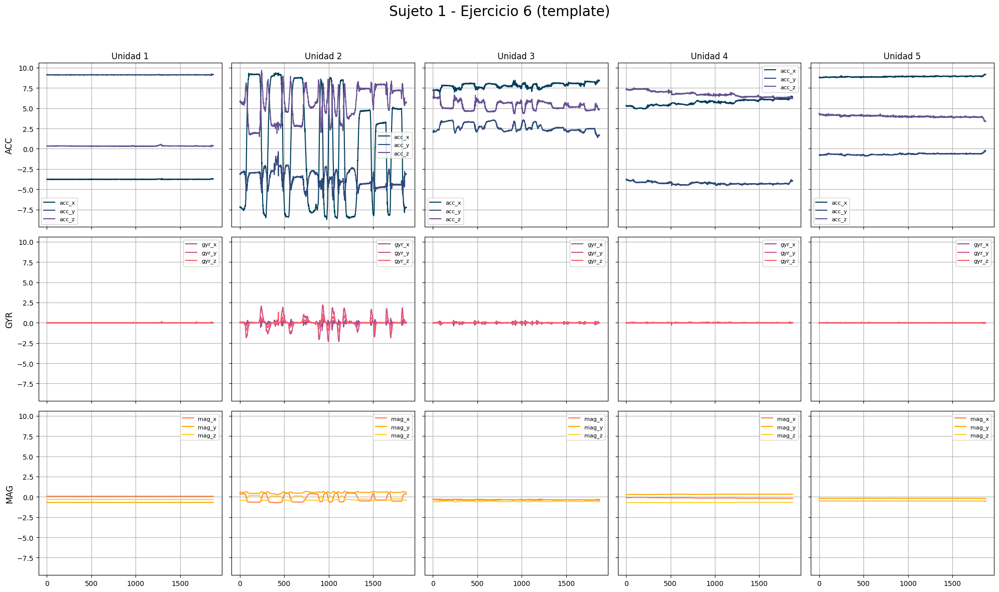

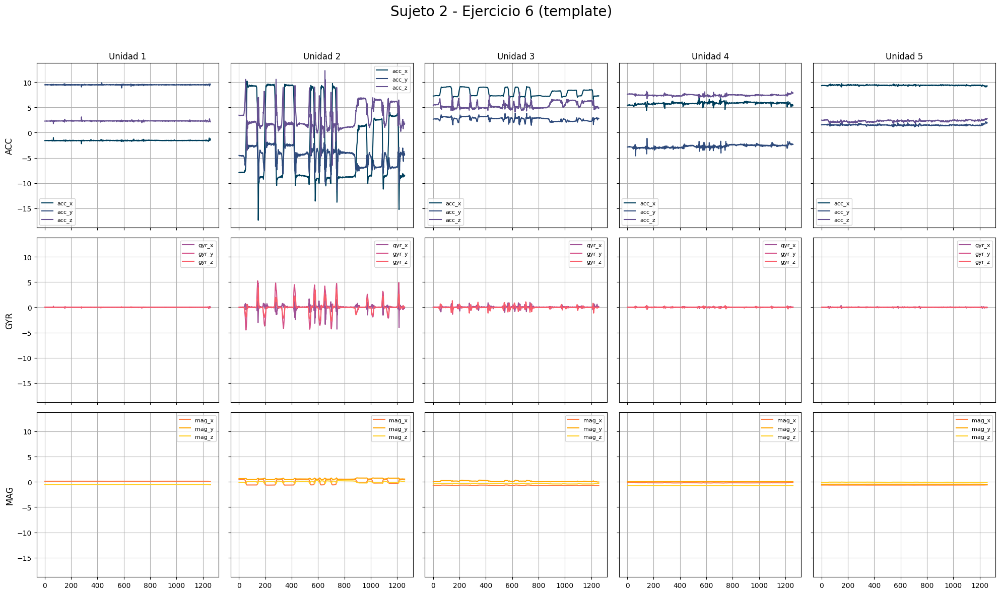

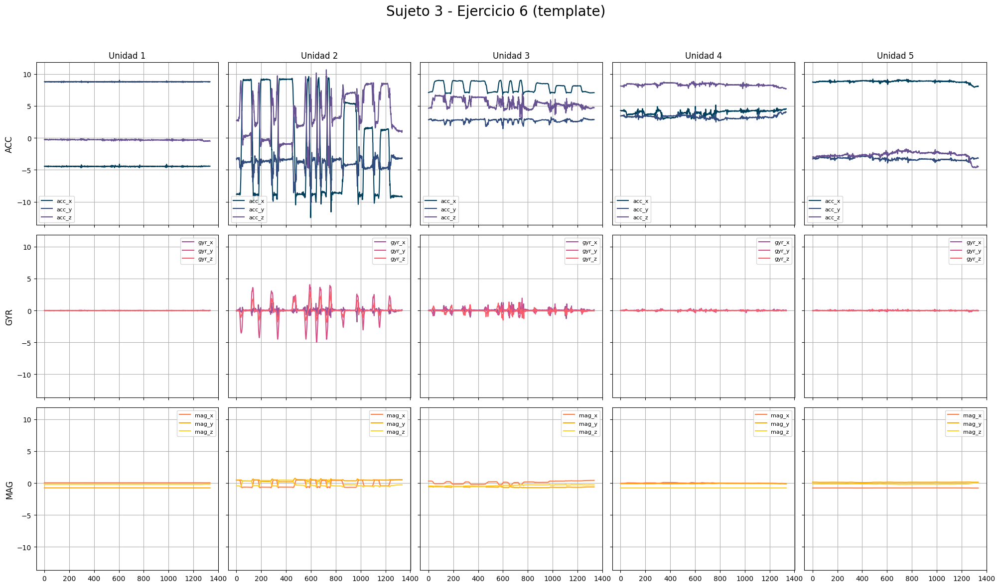

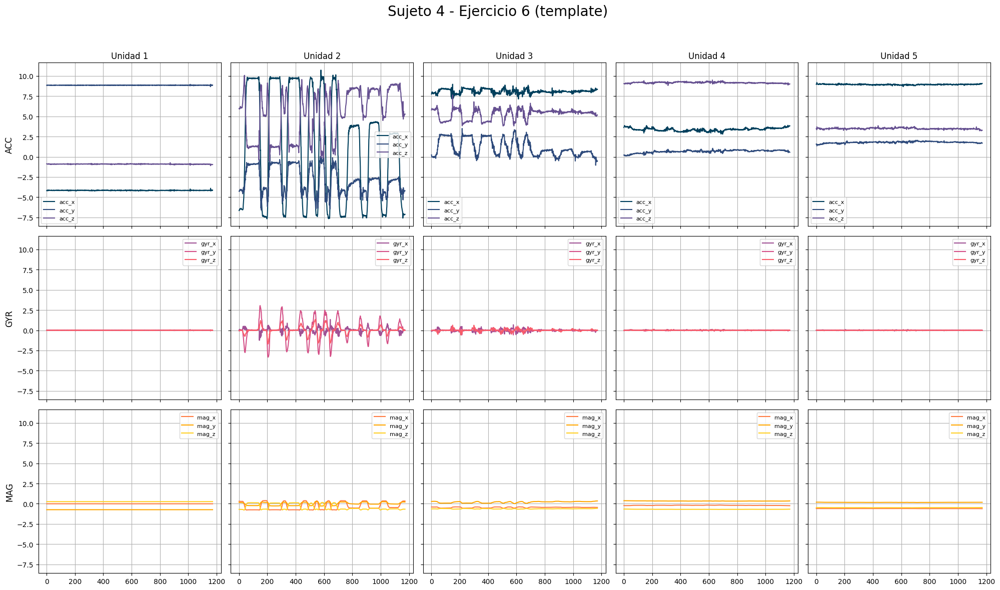

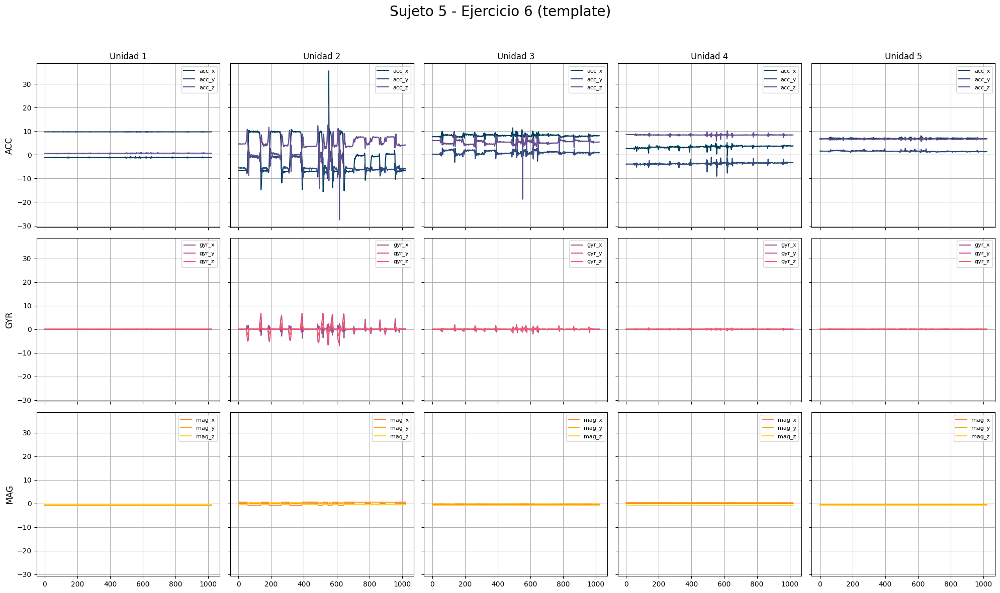

In [ ]:
f.plot_dist(1, 6, templates)
f.plot_dist(2, 6, templates)
f.plot_dist(3, 6, templates)
f.plot_dist(4, 6, templates)
f.plot_dist(5, 6, templates)

La muñeca derecha (sensor 2) y el codo derecho (sensor 3) muestran la mayor actividad, ya que son las partes directamente responsables de levantar y sostener el peso. En el acelerómetro, se observan variaciones significativas en los ejes x, y y z de estas unidades, probablemente durante la flexión y extensión del codo para realizar el movimiento. El sensor en el hombro derecho (unidad 4) registra actividad moderada, reflejando un posible ajuste postural para estabilizar el brazo mientras se realiza el levantamiento del peso. En contraste, el sensor en la rodilla derecha (unidad 1) y el sensor ubicado en el pecho (unidad 5) muestran señales más estables, como era de esperarse, ya que estas áreas del cuerpo permanecen mayormente inmóviles durante el ejercicio.

Las señales del giroscopio (GYR) reflejan rotaciones asociadas con el movimiento de flexión y extensión en la muñeca derecha y el codo derecho, mientras que las demás unidades presentan cambios mínimos, consistentes con sus roles secundarios en el movimiento. En cuanto al magnetómetro (MAG), las señales permanecen estables en todas las unidades, indicando que no hubo cambios significativos en la orientación magnética del cuerpo durante la ejecución del ejercicio.

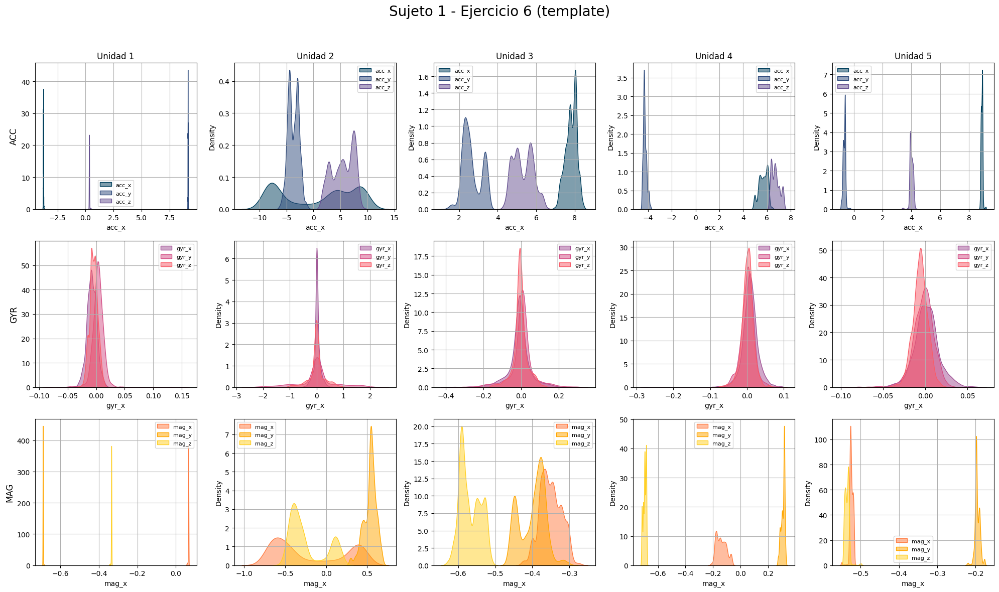

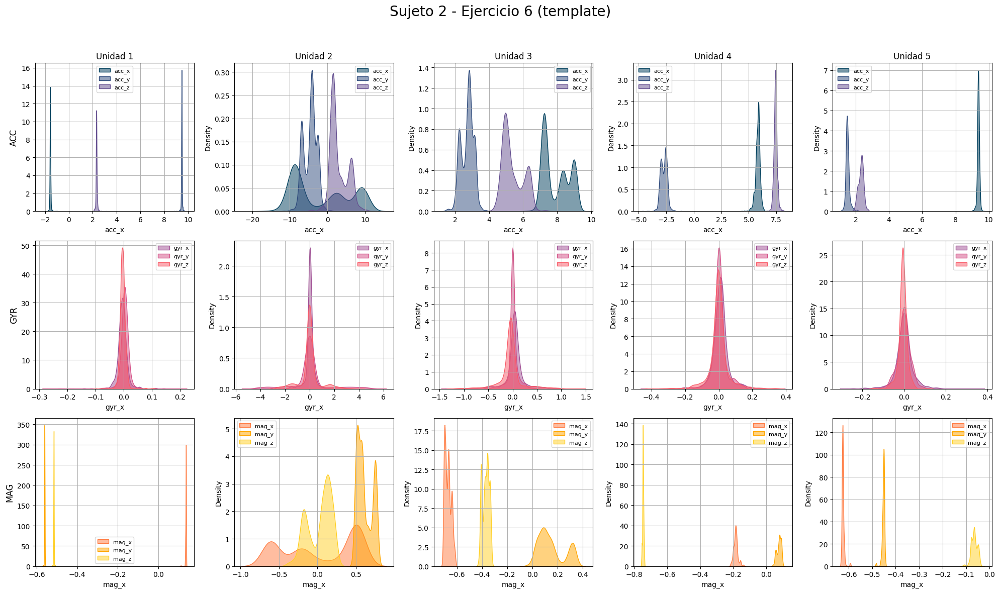

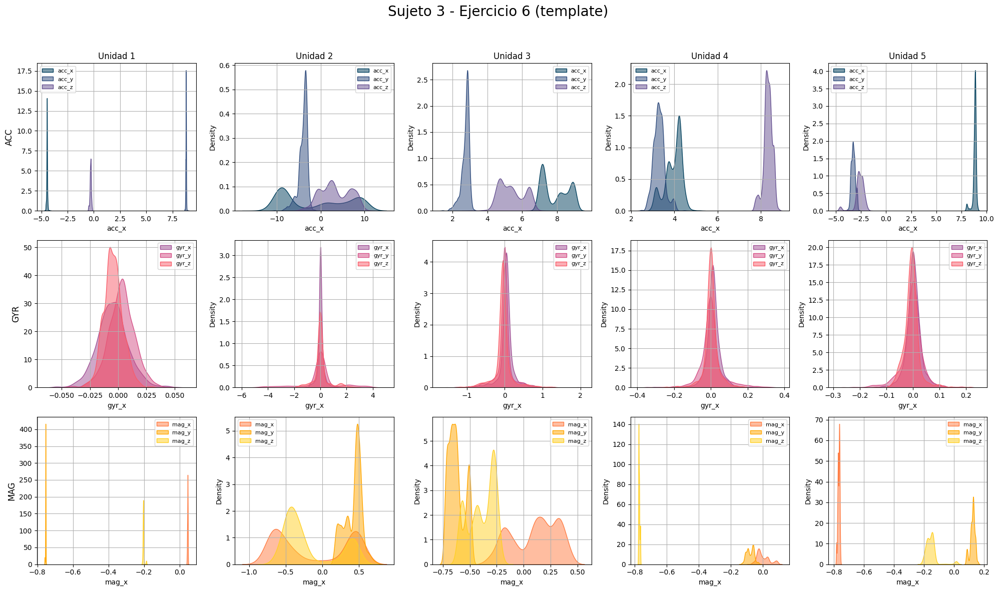

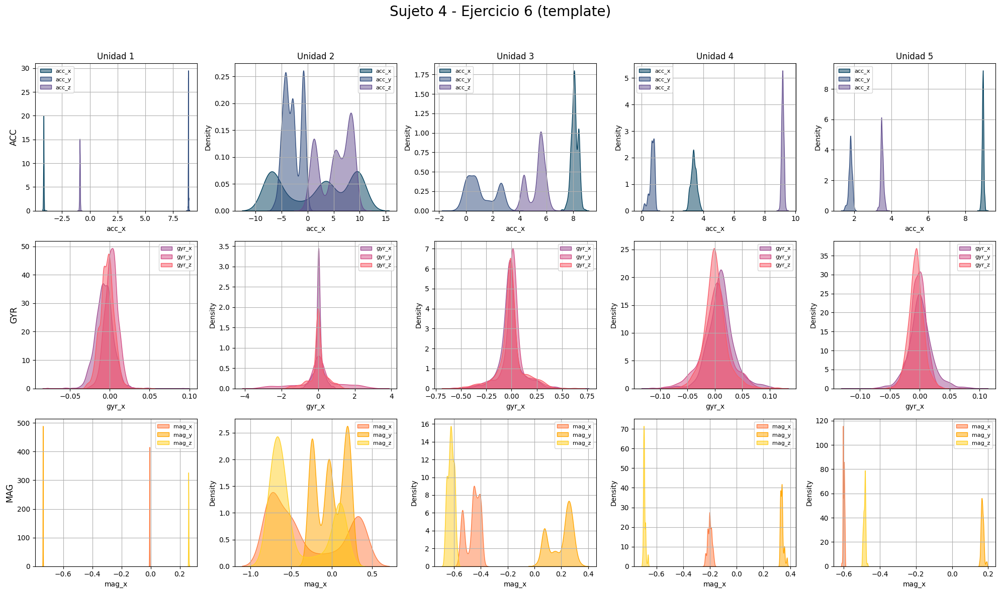

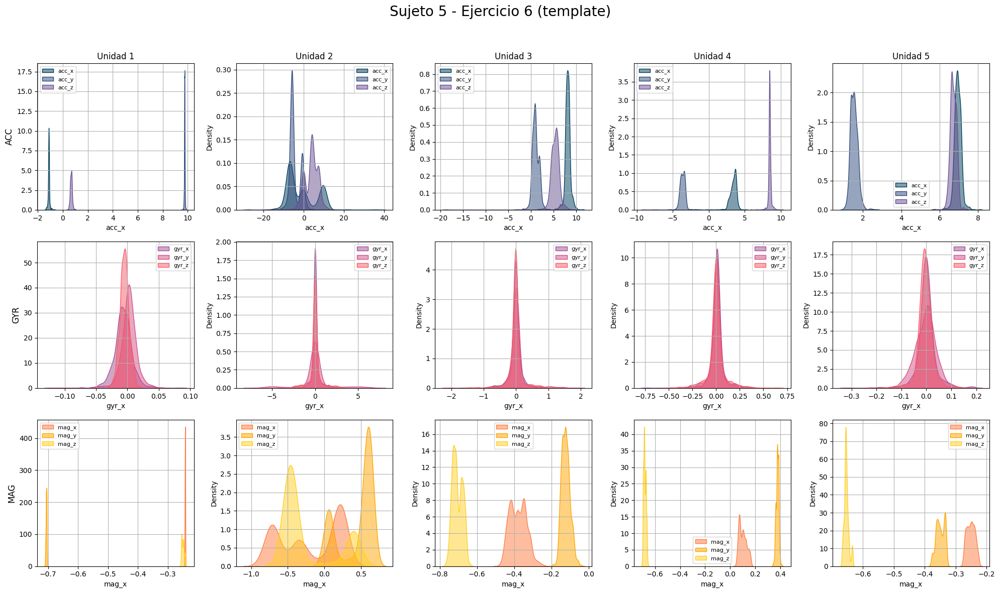

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 6, templates)

En la unidad 1, la rodilla derecha, la densidad muestra valores consistentes y relativamente bajos para la aceleración y el giroscopio, reflejando la estabilidad de la rodilla durante el ejercicio. La actividad mínima detectada podría ser atribuida a ligeros ajustes posturales para mantener el equilibrio mientras el peso es levantado. en cambio, en la unidad 2 correspondiente a la muñeca derecha los gráficos de densidad de aceleración muestran picos marcados, especialmente en el eje relacionado con el movimiento del peso. El giroscopio también refleja movimientos significativos debido a la flexión y extensión de la muñeca mientras el peso es elevado y bajado.

En la unidad 3, las densidades del giroscopio y la aceleración presentan mayores picos en comparación con otras unidades, particularmente en los ejes que corresponden a la flexión del codo. Esto es esperado ya que el codo es la articulación principal involucrada en la elevación del peso. La densidad del sensor en el hombro muestra actividad moderada en la aceleración y el giroscopio, ya que el hombro actúa como un punto de soporte y estabilización. Aunque no es la articulación principal en el movimiento, contribuye al control del brazo durante el ejercicio. Los sensores en los pechos de los sujetos reflejan valores consistentes en densidad, con poca variación. Esto sugiere que el torso permanece relativamente estable durante el ejercicio, sirviendo como base para soportar los movimientos del brazo derecho.

In [ ]:
temp = f.stats_por_unidad(6, templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.00641,0.002639,-0.004336,-3.155471,9.166457,0.40957,0.015087,-0.68991,-0.225097
Mediana,-0.007123,0.003085,-0.004544,-3.76827,9.11919,0.322591,0.047056,-0.704754,-0.25359
Desviación estándar,0.013693,0.014544,0.00878,1.320111,0.339182,1.052692,0.118046,0.066384,0.246963


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.013973,0.014549,0.008332,-0.323018,-3.939196,4.268121,-0.157171,0.417063,-0.210452
Mediana,0.013839,0.017547,-0.004969,0.087091,-3.979781,4.440175,-0.275294,0.514258,-0.304451
Desviación estándar,0.342458,1.286044,0.610766,7.291134,1.74581,3.011699,0.470071,0.251827,0.325595


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.008773,0.001103,-0.022868,7.948316,2.157286,5.346815,-0.344198,-0.193236,-0.526148
Mediana,0.005054,0.004754,-0.017975,7.988181,2.484572,5.370817,-0.377626,-0.149425,-0.571428
Desviación estándar,0.17331,0.182378,0.196991,0.574066,0.981924,0.728668,0.269337,0.322517,0.137485


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.009814,0.001281,-0.000172,4.603562,-1.500985,7.868454,-0.094222,0.202929,-0.718557
Mediana,0.009267,0.001608,-0.000086,4.295979,-2.848831,8.133631,-0.145975,0.307016,-0.700132
Desviación estándar,0.045825,0.050692,0.051855,1.133673,2.93723,0.920767,0.112621,0.173569,0.035407


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.00053,-0.00295,-0.006363,8.676247,-0.012468,2.673841,-0.563762,-0.139771,-0.379351
Mediana,0.000233,-0.001195,-0.005931,8.909928,1.316466,3.505467,-0.598405,-0.196216,-0.487122
Desviación estándar,0.031226,0.030019,0.022449,0.773182,1.910766,2.979359,0.157404,0.23828,0.223165


La unidad ubicada en la rodilla derecha muestra variaciones relativamente bajas en las estadísticas de aceleración (ejes acc_x, acc_y, acc_z) y giroscopio (ejes gyr_x, gyr_y, gyr_z). Esto refleja que la rodilla permanece estable durante el ejercicio, actuando principalmente como soporte. La aceleración en acc_z muestra ligeras fluctuaciones, probablemente relacionadas con el ajuste postural al sostener el peso. En esta unidad, la actividad es más pronunciada, como lo indican las medias y desviaciones estándar más altas en los ejes de aceleración, especialmente en acc_x y acc_z, y en los ejes del giroscopio (gyr_x, gyr_y). Esto es consistente con la biomecánica del movimiento, ya que la muñeca está directamente involucrada en la elevación y el control del peso.

El codo derecho presenta mayores valores de aceleración en el eje acc_x, reflejando su rol como punto clave para la flexión y extensión del brazo. Las desviaciones estándar en el giroscopio (gyr_x, gyr_y) son moderadas, indicando movimientos controlados durante la flexión y la pausa al mantener el peso perpendicular al muslo. El hombro muestra variaciones moderadas en aceleración y giroscopio. Las estadísticas en acc_x y acc_y indican que el hombro actúa como estabilizador durante el movimiento, especialmente para controlar la posición del brazo y el peso sostenido. Las desviaciones estándar más bajas en comparación con la muñeca y el codo reflejan movimientos más suaves. La unidad del pecho registra valores consistentes con poca variabilidad en aceleración y giroscopio, lo que confirma que el torso permanece relativamente inmóvil. Este patrón es esperado, ya que el torso sirve como base para estabilizar el cuerpo durante el ejercicio.

### Séptimo ejercicio

```{note}
Este ejercicio consiste en permanecer de pie, con la espalda recta, sosteniendo un peso de 1 kg en la mano derecha, con el brazo colgando recto hacia abajo. Desde esa posición, eleva el peso hacia el lado derecho desde la articulación del hombro hasta alcanzar una posición horizontal, manteniendo el codo completamente recto. Luego, mantén esta posición durante 5 segundos. Finalmente, regresa el brazo a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en la rodilla derecha, 2 en la muñeca derecha, 3 en el codo derecho, 4 en el hombro derecho y 5 en el pecho.
```

![](assets/ex7.png)

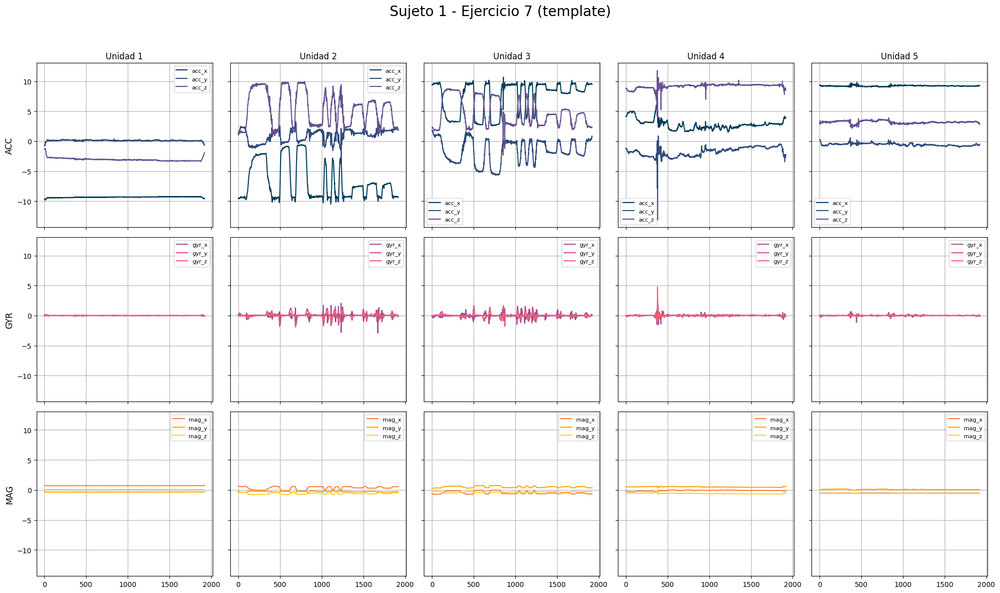

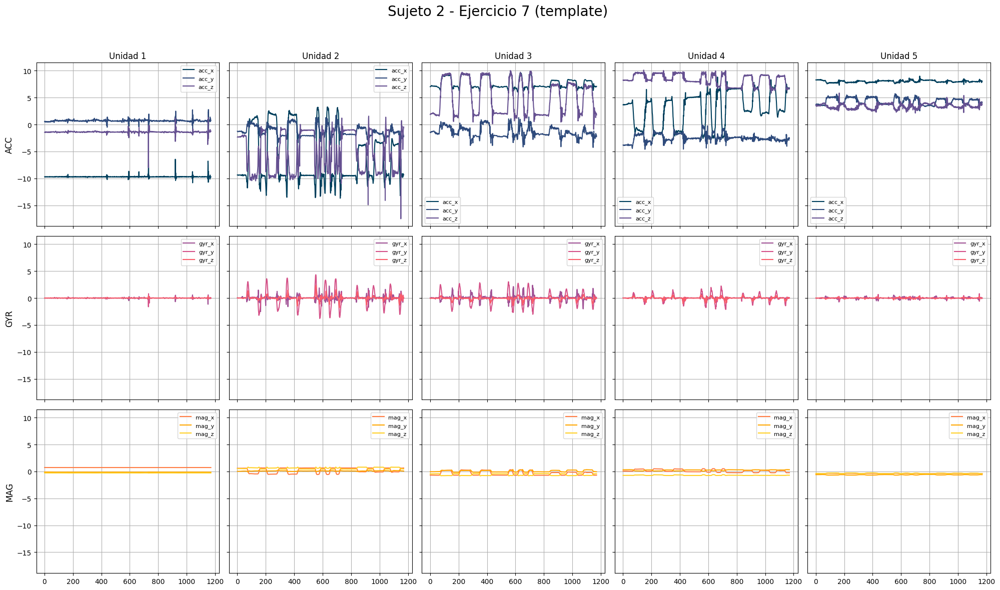

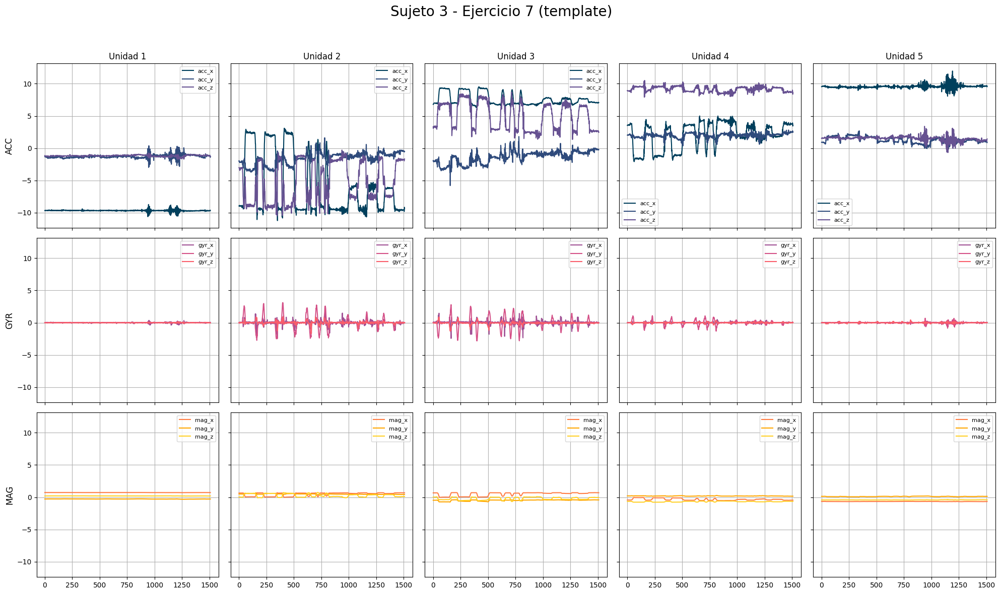

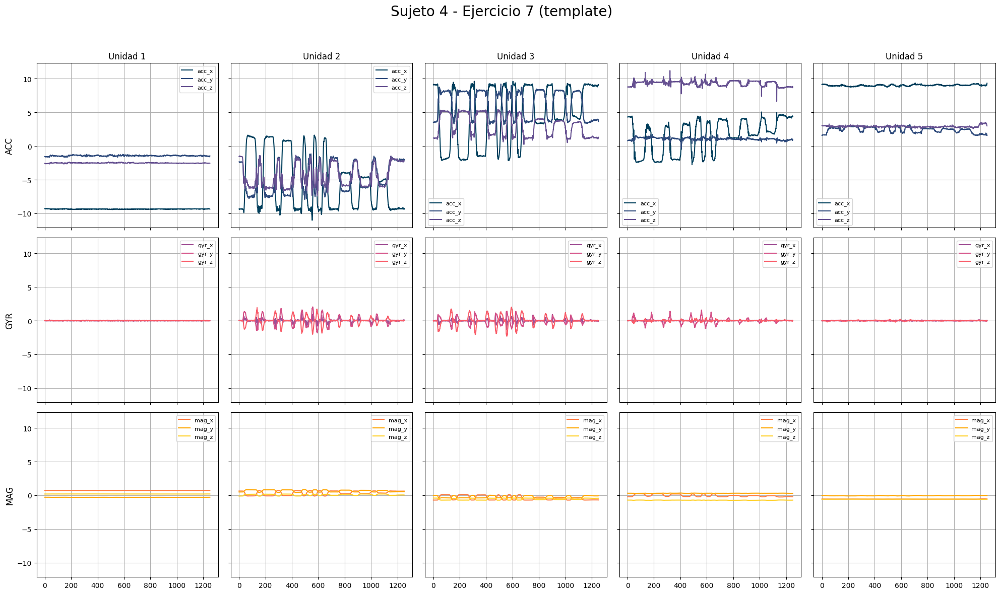

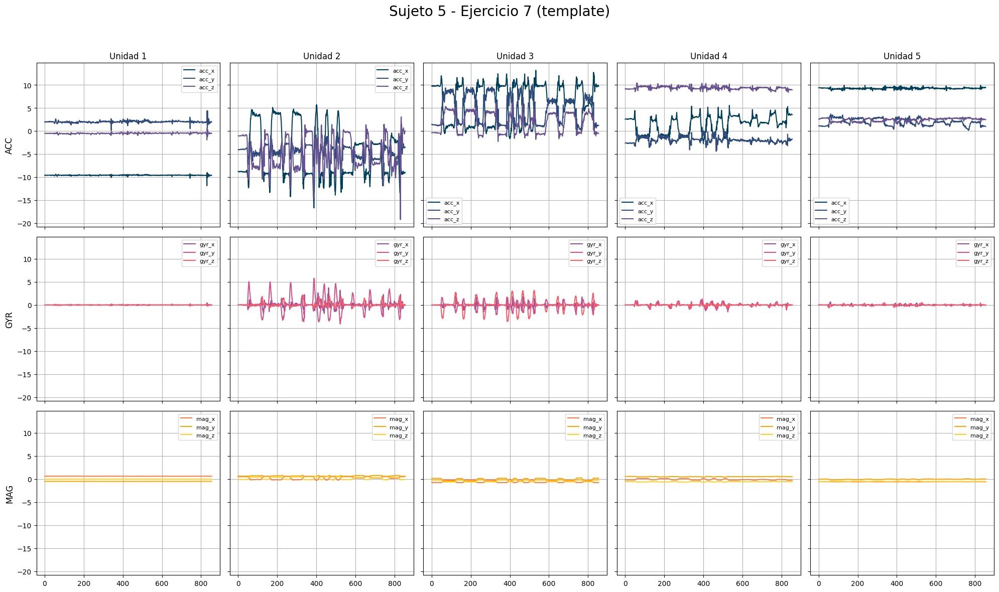

In [ ]:
f.plot_dist(1, 7, templates)
f.plot_dist(2, 7, templates)
f.plot_dist(3, 7, templates)
f.plot_dist(4, 7, templates)
f.plot_dist(5, 7, templates)

La mayor actividad se observa en las señales del sensor ubicado en el hombro derecho (unidad 4) y en el sensor de la muñeca derecha (unidad 2), que son las partes del cuerpo más involucradas en el movimiento. En el acelerómetro, se observan picos significativos en los ejes x, y y z, debido probablemente a la elevación y descenso del peso. El sensor en el codo derecho (unidad 3) también muestra actividad, aunque de menor magnitud, probablemente debido al papel estabilizador del codo durante el ejercicio. Por otro lado, las señales del sensor en la rodilla derecha (unidad 1) y del sensor en el pecho (unidad 5) permanecen más estables, lo que refleja la relativa inmovilidad de estas partes del cuerpo que actúan como puntos de soporte. Las señales del giroscopio (GYR) reflejan rotaciones en el hombro derecho y la muñeca derecha, indicando el movimiento de rotación asociado al levantamiento lateral del peso.

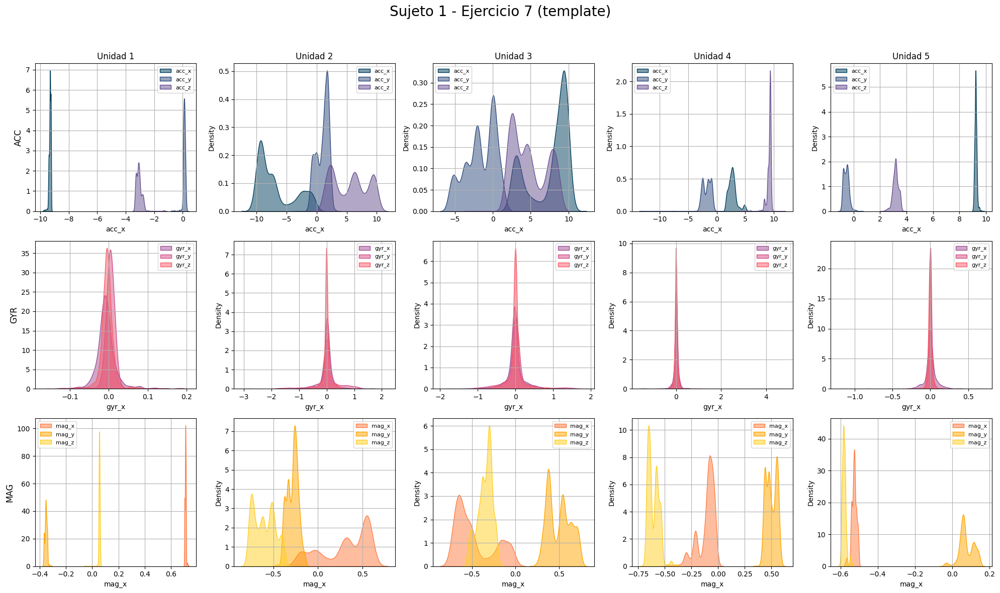

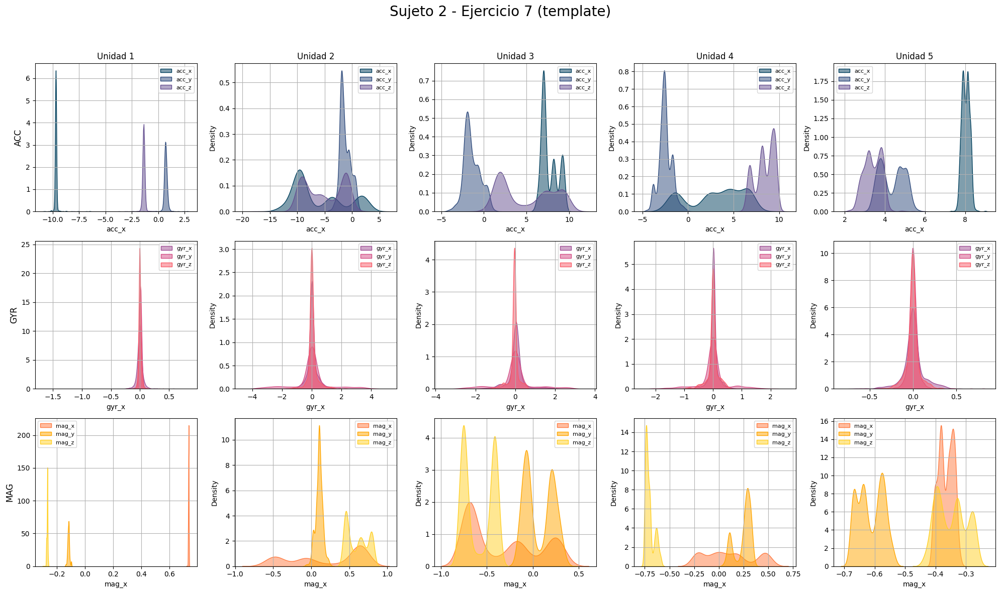

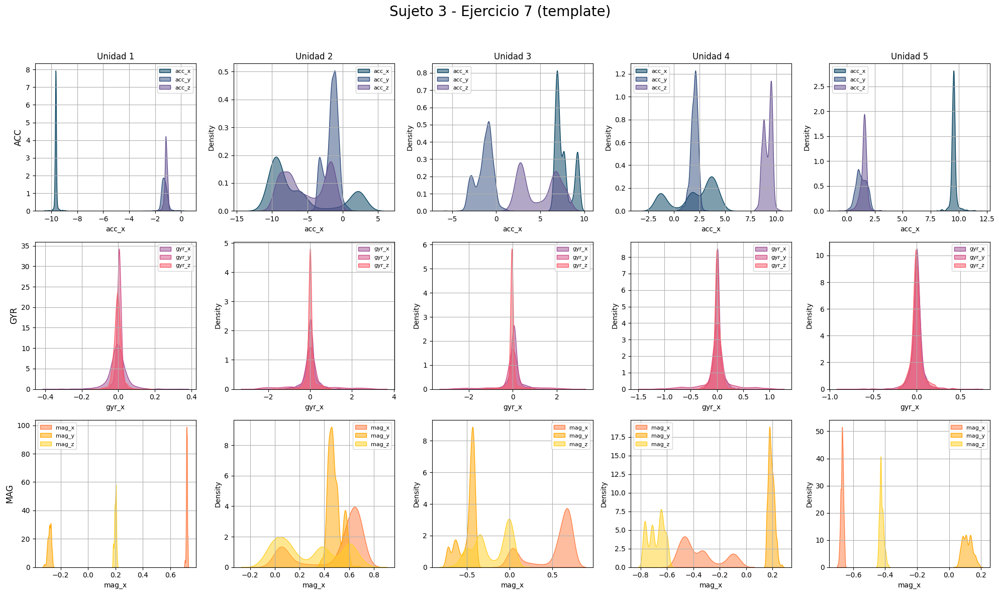

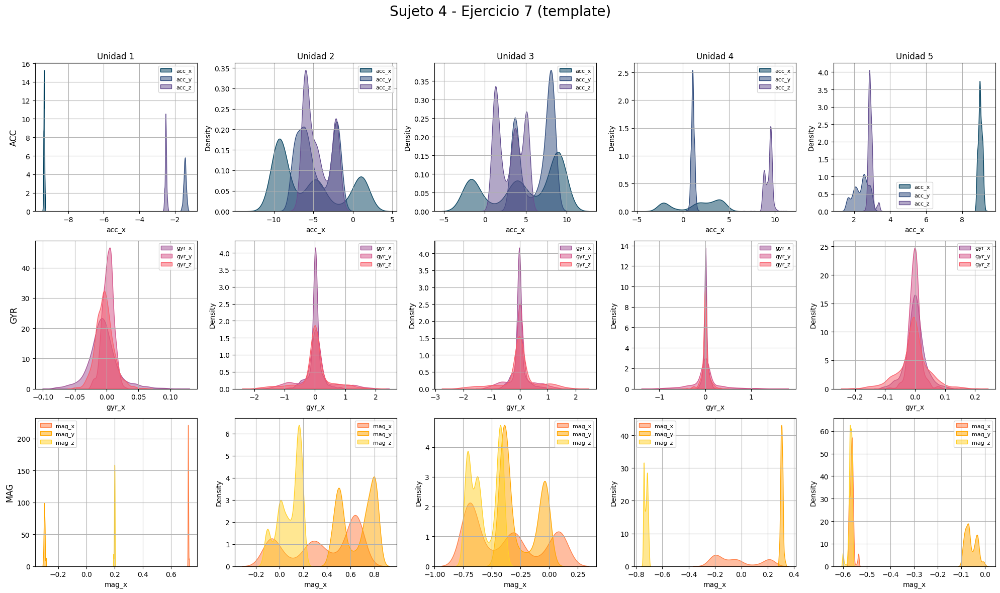

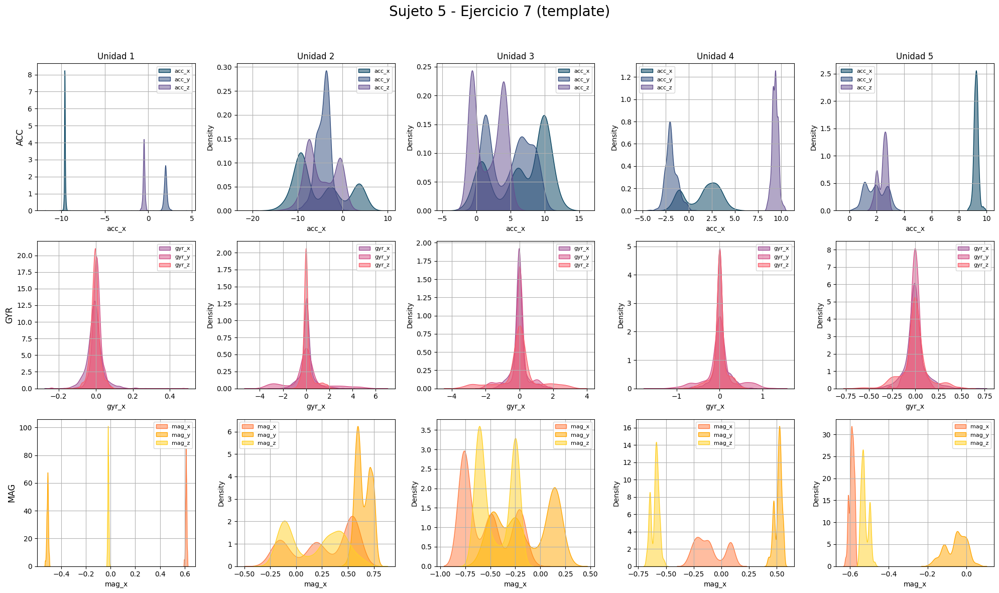

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 7, templates)

En la unidad ubicada en la rodilla derecha (Unidad 1), las distribuciones de aceleración muestran poca actividad significativa en los ejes X e Y, mientras que el eje Z presenta ligeros picos que indican un movimiento limitado en esta articulación. Los datos giroscópicos son bastante estables y están centrados cerca de cero, lo que sugiere que no hay cambios angulares destacados en la rodilla. Por otro lado, los datos magnéticos presentan variabilidad en los tres ejes, probablemente debido a interferencias locales o pequeñas oscilaciones. En la muñeca derecha (Unidad 2), las señales capturadas muestran mayor variabilidad, especialmente en los datos de aceleración en los ejes X e Y, lo cual es consistente con el movimiento dinámico del brazo al levantar el peso. Los giroscopios en esta unidad registran amplitudes más amplias, con picos que reflejan el movimiento angular durante la elevación lateral del peso. Los datos magnéticos en esta unidad presentan múltiples picos, lo que podría estar relacionado con cambios en la orientación de la muñeca o influencias externas.

La unidad en el codo derecho (Unidad 3) registra señales de aceleración moderadas, particularmente en el eje X, que reflejan el movimiento del antebrazo al elevar el peso. Los datos giroscópicos son estables pero con amplitudes ligeramente más pronunciadas que las de la muñeca, lo que sugiere rotaciones controladas en la articulación del codo. En cuanto a los datos magnéticos, estos muestran variaciones menores, indicando una menor influencia de factores externos en esta región. En el hombro derecho (Unidad 4), las señales de aceleración tienen mayores amplitudes en los ejes X e Y, lo que refleja el esfuerzo principal del movimiento al elevar el peso desde el brazo completo. Los giroscopios en esta unidad muestran variaciones más amplias que en las otras unidades, lo cual es consistente con la rotación del brazo desde el hombro. Los datos magnéticos permanecen relativamente consistentes, con menos interferencias o variaciones notables en comparación con las otras unidades. Finalmente, en el pecho (Unidad 5), las señales registradas son las más estables. Los datos de aceleración tienen picos mínimos, reflejando que el torso se mantiene mayormente fijo durante el ejercicio, con solo ajustes menores para mantener el equilibrio. Los giroscopios y magnetómetros en esta unidad muestran patrones muy constantes, con variaciones mínimas en todos los ejes, lo que confirma que esta región del cuerpo sirve como un punto de estabilización durante la actividad.

In [ ]:
temp = f.stats_por_unidad(7, templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.006352,0.00324,-0.004106,-9.507729,-0.153401,-1.915493,0.705842,-0.305663,0.047561
Mediana,-0.007615,0.003721,-0.004731,-9.558949,0.078569,-1.457858,0.718734,-0.299566,0.055668
Desviación estándar,0.047173,0.033883,0.021083,0.203584,1.168574,0.947428,0.037718,0.111458,0.165604


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.009636,0.019932,0.019329,-6.048496,-1.746921,-1.937823,0.333589,0.249347,0.033068
Mediana,0.012185,0.015362,-0.003162,-8.25685,-1.543523,-2.250226,0.484319,0.433321,0.090237
Desviación estándar,0.356765,0.921224,0.344534,4.363761,2.54679,5.560788,0.327867,0.39314,0.469187


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.003847,-0.002223,-0.032706,6.911483,0.777201,4.167826,-0.219414,-0.022529,-0.412515
Mediana,-0.002448,0.004328,-0.02044,7.605083,-0.502968,3.762884,-0.327799,-0.051311,-0.410213
Desviación estándar,0.340051,0.615397,0.519892,2.964919,3.827233,2.564482,0.486165,0.407831,0.207675


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.010715,0.000831,-0.003731,2.284755,-0.536776,9.072403,-0.112617,0.3509,-0.66198
Mediana,0.007633,0.00195,-0.001571,2.613412,-1.073372,9.26909,-0.103998,0.312675,-0.658145
Desviación estándar,0.131752,0.329636,0.132663,2.142963,1.894524,0.644724,0.215235,0.140619,0.067722


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.000099,-0.001522,-0.006125,9.045885,1.5824,2.689593,-0.546129,-0.077742,-0.495297
Mediana,-0.00125,-0.000685,-0.005812,9.18758,1.613175,2.890089,-0.560387,0.022544,-0.539902
Desviación estándar,0.089455,0.061952,0.074413,0.534683,1.738648,0.762124,0.099032,0.258189,0.093525


En la unidad 1 (rodilla derecha), las señales de aceleración (acc_x, acc_y y acc_z) presentan valores bajos, siendo acc_z la más destacada debido a la influencia gravitacional. Los giroscopios (gyr_x, gyr_y y gyr_z) muestran rotación mínima, mientras que los magnetómetros registran valores bajos y estables, indicando poca variabilidad. En la unidad 2 (muñeca derecha), acc_x y acc_y reflejan mayor actividad, correspondiente al movimiento dinámico del brazo al levantar el peso. Los giroscopios muestran valores elevados, especialmente en gyr_y y gyr_z, indicando rotación en diferentes planos. Los magnetómetros presentan variabilidad, posiblemente debido a cambios en la orientación de la muñeca. En la unidad 3 (codo derecho), las señales de aceleración son moderadas, especialmente en acc_x y acc_y, indicando movimiento del antebrazo en el plano horizontal. Los giroscopios tienen amplitudes similares a las de la unidad 2, reflejando su rol complementario. Los magnetómetros son consistentes, con mínima variación.

En la unidad 4 (hombro derecho), acc_x y acc_y muestran las mayores amplitudes, ya que esta articulación lidera el movimiento. Los giroscopios registran los valores más altos, reflejando el esfuerzo y la rotación en el hombro. Los magnetómetros, aunque estables, muestran ligeras variaciones por cambios de orientación. Finalmente, en la unidad 5 (pecho), las señales de aceleración son bajas y constantes, indicando un torso principalmente estático con pequeños ajustes para mantener el equilibrio. Los giroscopios registran rotación insignificante, y los magnetómetros muestran valores uniformes, con poca influencia externa.

### Octavo ejercicio
```{note}
Este ejercicio consiste en acostarse boca abajo sobre una superficie plana y elevada, dejando el brazo derecho colgando por el lado desde el codo. Desde esa posición, eleva el antebrazo derecho hasta extender completamente el codo. Mantén esta posición durante 5 segundos. Finalmente, regresa el brazo a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en la rodilla derecha, 2 en la muñeca derecha, 3 en el codo derecho, 4 en el hombro derecho y 5 en el pecho.
```
![](assets/ex8.png)

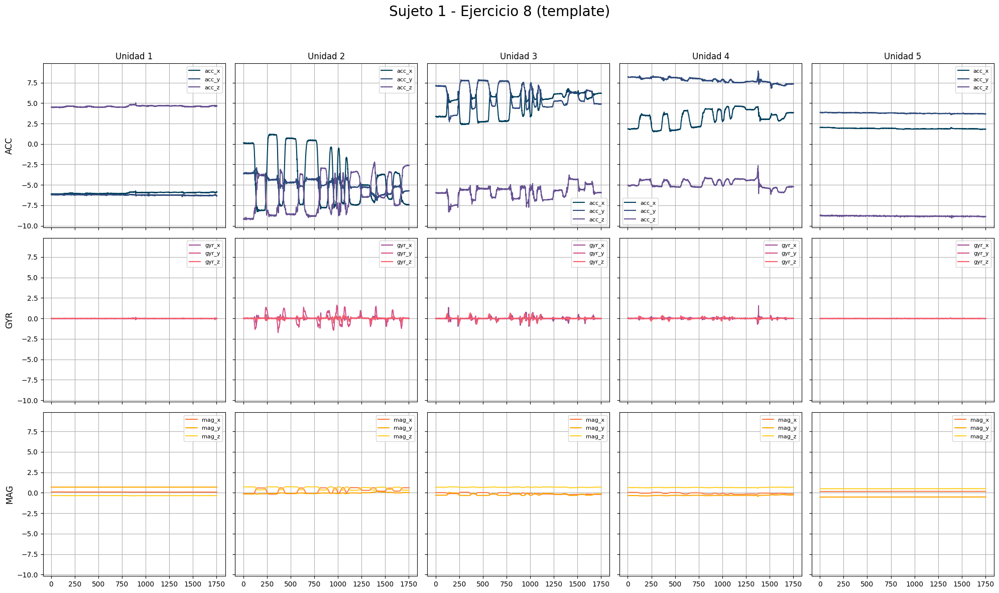

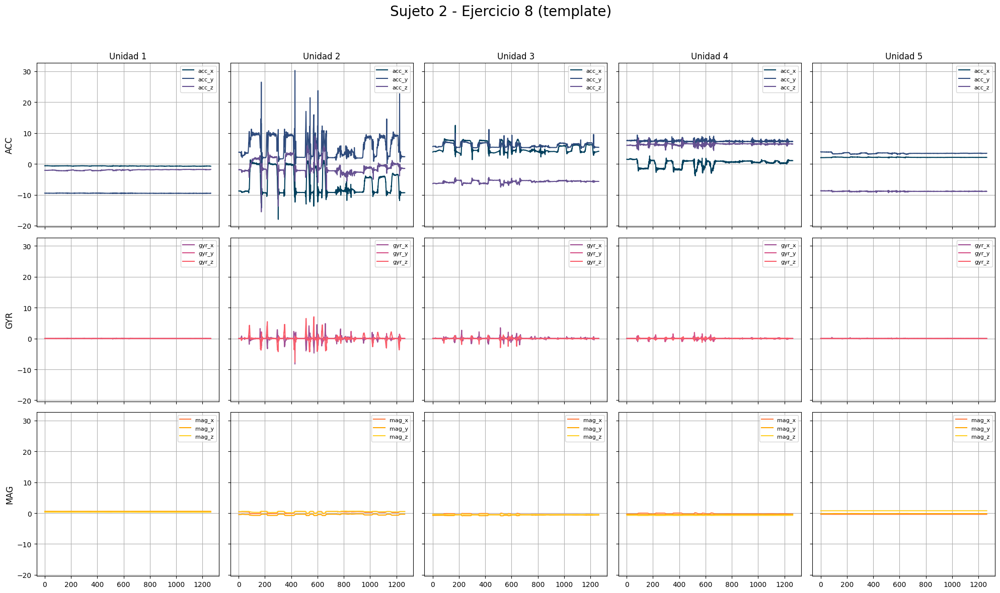

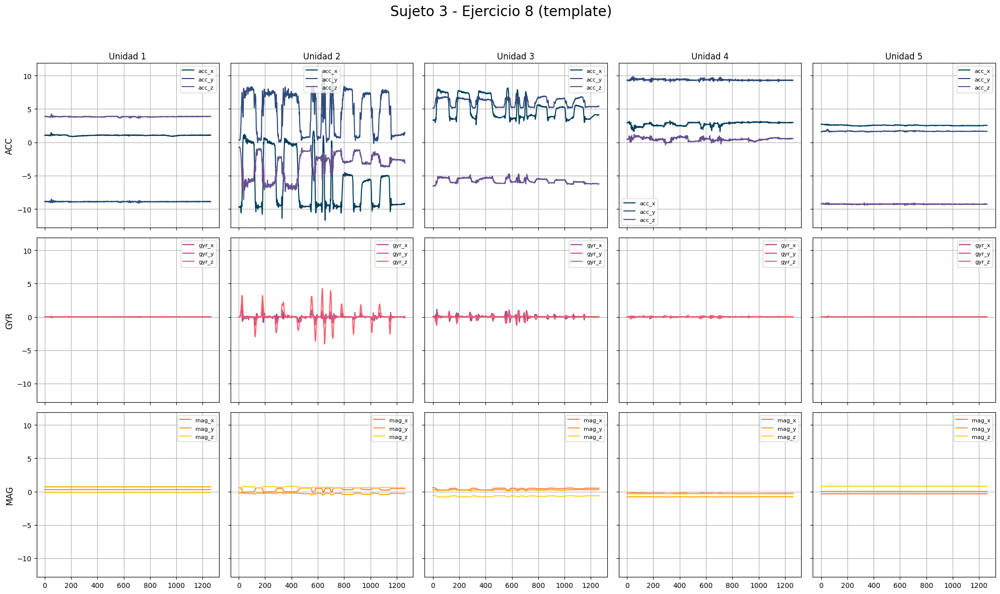

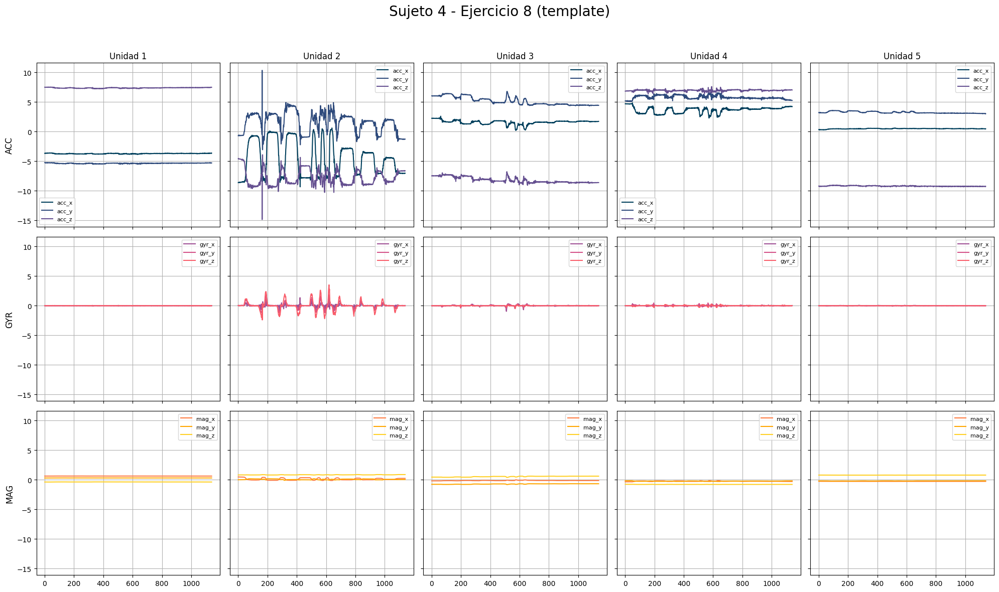

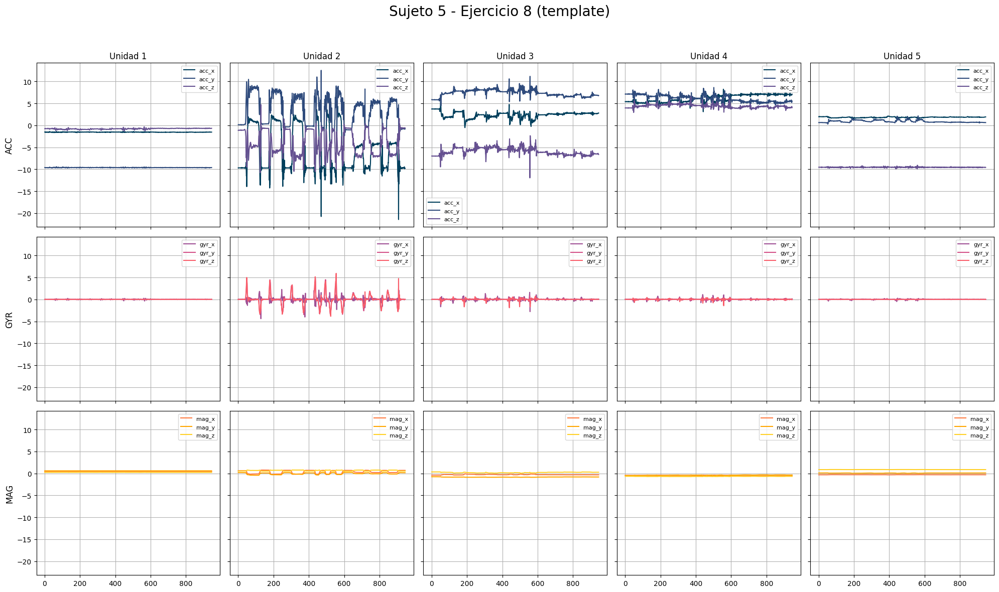

In [ ]:
f.plot_dist(1, 8, templates)
f.plot_dist(2, 8, templates)
f.plot_dist(3, 8, templates)
f.plot_dist(4, 8, templates)
f.plot_dist(5, 8, templates)

Los sensores muestran un patrón de actividad concentrado principalmente en la muñeca derecha (sensor 2) y el codo derecho (sensor 3), ya que estas áreas están directamente involucradas en el levantamiento del antebrazo. En el acelerómetro, se observan picos significativos en los ejes x, y y z de estas unidades durante la fase de elevación y descenso del antebrazo. La muñeca derecha registra las mayores variaciones debido a su rol principal en la dinámica del movimiento. El hombro derecho (sensor 4) presenta una actividad moderada, reflejando su papel estabilizador durante el ejercicio, mientras que las señales de la rodilla derecha (sensor 1) y el pecho (sensor 5) son más estables, lo cual coincide con su papel de soporte en la postura. Las señales del giroscopio (GYR) muestran cambios notables en las unidades de la muñeca derecha y el codo derecho, reflejando las rotaciones asociadas al movimiento de flexión y extensión. Por el contrario, el hombro derecho, la rodilla derecha y el pecho mantienen señales más uniformes en el giroscopio, consistentes con su menor participación en el movimiento dinámico.

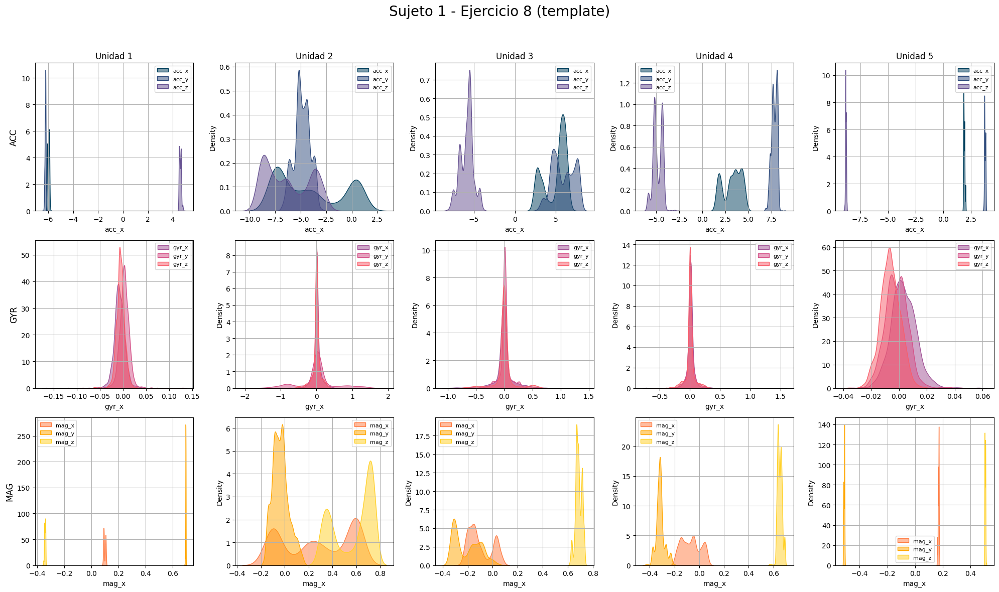

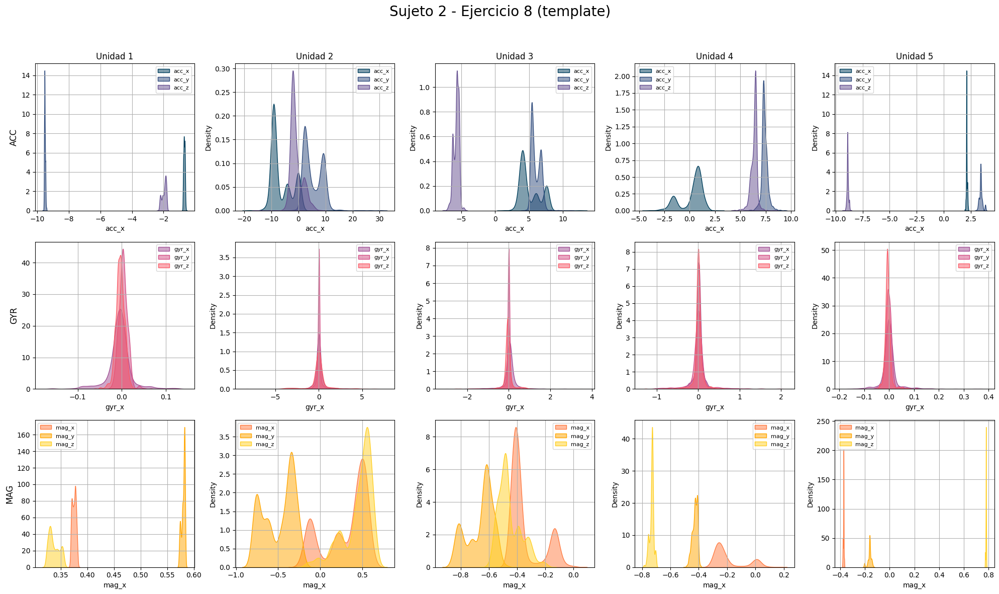

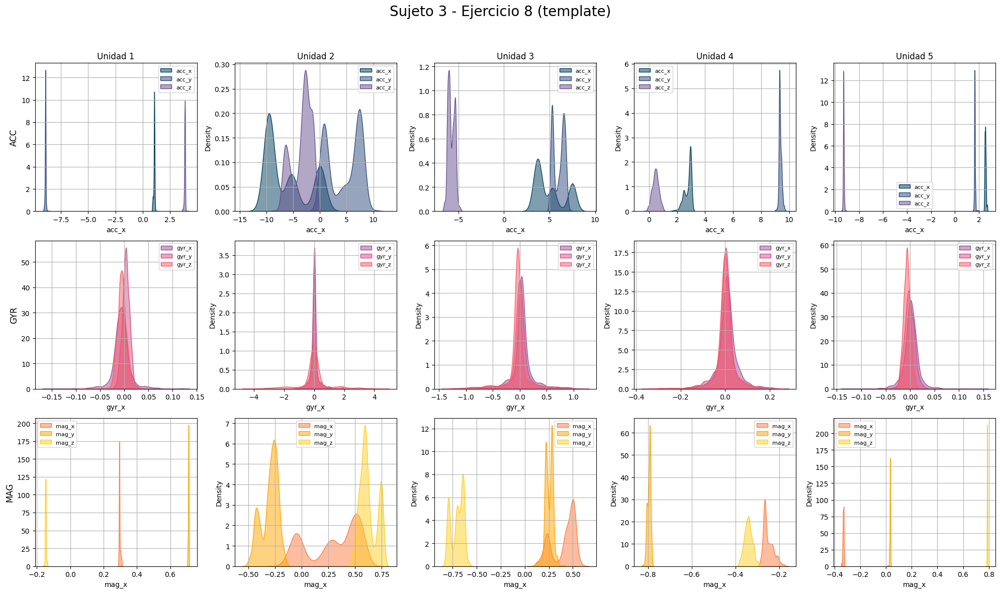

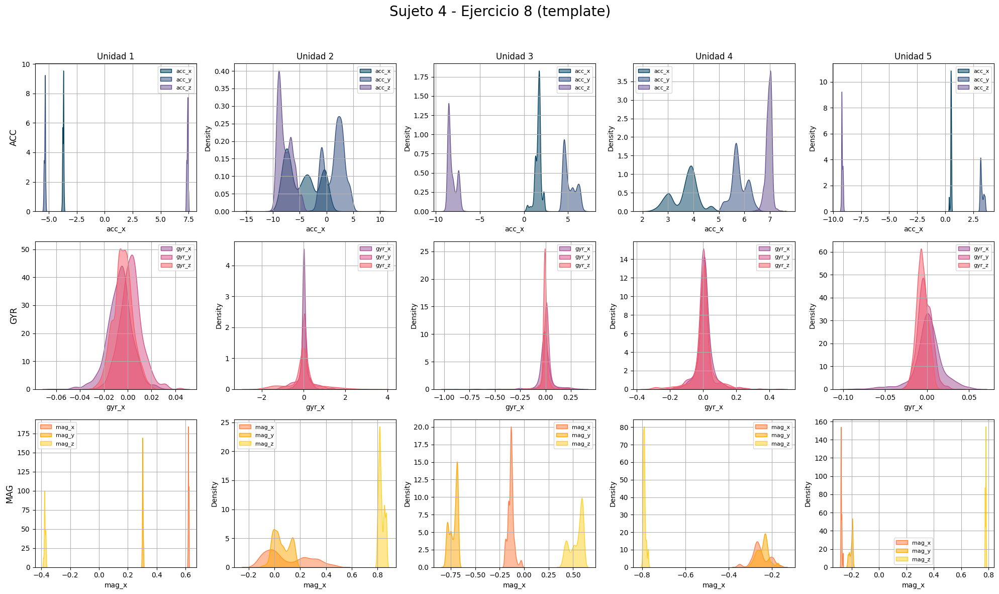

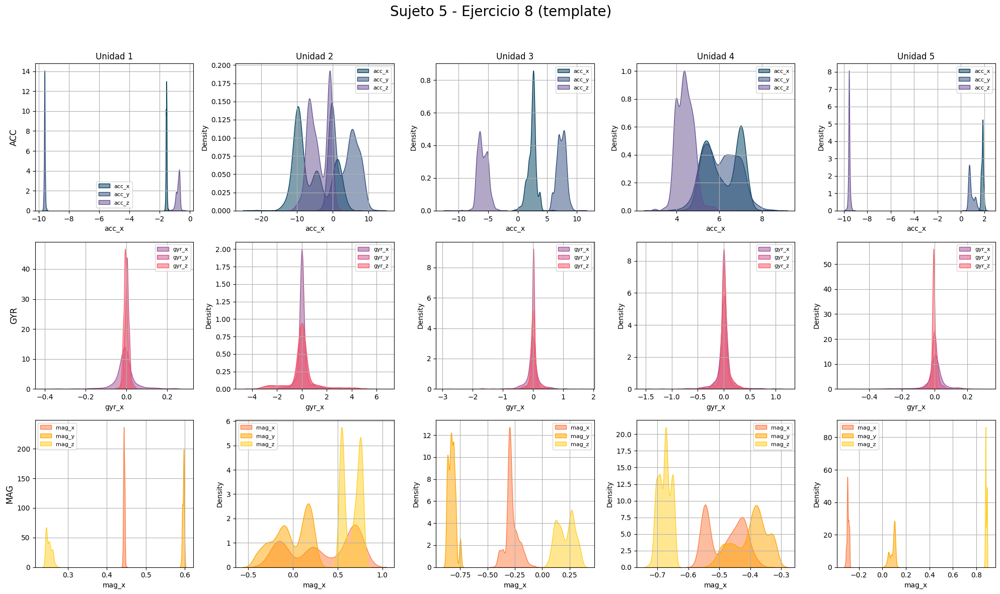

In [ ]:
for i in range(1,6):
    f.plot_dens(i, 8, templates)

En la unidad 1, situada en la rodilla derecha, se observa una actividad mínima en los ejes de aceleración, con señales casi uniformes debido a la estabilidad de esta zona durante el ejercicio. Los giroscopios muestran valores muy bajos, reflejando una ausencia de rotación significativa en esta articulación. Los magnetómetros mantienen una señal constante y de baja amplitud, indicando una orientación estable respecto al campo magnético. La unidad 2, ubicada en la muñeca derecha, registra mayor variabilidad en los ejes de aceleración y giroscopio, especialmente en los ejes acc_x y gyr_y, lo que refleja la participación dinámica de la muñeca al guiar el movimiento del antebrazo. Los datos de magnetómetros presentan variaciones moderadas, probablemente debido a los cambios de orientación del brazo durante el movimiento. En la unidad 3, correspondiente al codo derecho, las señales de aceleración y giroscopio son más prominentes, especialmente en acc_y y gyr_x, lo que indica que esta articulación desempeña un papel clave en la ejecución del movimiento de extensión. Los valores de los magnetómetros son relativamente estables, sugiriendo que los cambios de orientación en esta articulación son controlados.

La unidad 4, en el hombro derecho, muestra las mayores amplitudes en las señales de aceleración y giroscopio, reflejando el esfuerzo necesario para estabilizar el brazo durante el movimiento. Los datos de magnetómetros presentan ligeras oscilaciones, que pueden estar relacionadas con la inclinación y rotación del torso para mantener el equilibrio. En la unidad 5, situada en el pecho, los datos son notablemente estables, con valores bajos en los sensores de aceleración y giroscopio, lo que refleja una postura mayormente fija del torso. Los valores de magnetómetros son uniformes, indicando poca variación en la orientación general de esta zona durante el ejercicio.

In [ ]:
temp = f.stats_por_unidad(8, templates)
temp[temp['Unidad'] == 1].drop(columns=['Unidad']).T

,0,1,2,3,4,5,6,7,8
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,-0.006729,0.003053,-0.004709,-2.477218,-7.761472,2.841368,0.336844,0.59012,-0.087028
Mediana,-0.007057,0.002935,-0.004696,-1.572966,-8.888831,3.867282,0.370594,0.598221,-0.150041
Desviación estándar,0.027586,0.010253,0.009434,2.623855,1.752079,3.360902,0.180465,0.144007,0.294411


In [ ]:
temp[temp['Unidad'] == 2].drop(columns=['Unidad']).T

,9,10,11,12,13,14,15,16,17
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.00655,0.012348,-0.00444,-5.288699,1.389301,-4.551438,0.263941,-0.160267,0.614444
Mediana,0.005064,0.019046,-0.002882,-6.093561,1.807768,-4.44317,0.278497,-0.092782,0.624035
Desviación estándar,0.410286,0.569317,0.878341,3.877869,4.812106,3.176277,0.278065,0.238205,0.176909


In [ ]:
temp[temp['Unidad'] == 3].drop(columns=['Unidad']).T

,18,19,20,21,22,23,24,25,26
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.008155,0.002918,-0.023111,4.004659,6.015762,-6.261269,-0.081797,-0.390076,0.086488
Mediana,-0.000442,0.00577,-0.01309,3.804028,6.01802,-5.971709,-0.142645,-0.56624,0.267618
Desviación estándar,0.23971,0.146244,0.201976,1.920927,1.10863,1.092,0.274944,0.399466,0.56771


In [ ]:
temp[temp['Unidad'] == 4].drop(columns=['Unidad']).T

,27,28,29,30,31,32,33,34,35
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.009251,0.00327,0.001539,3.034807,7.414803,1.908391,-0.222025,-0.432212,-0.275867
Mediana,0.009246,0.002818,0.002027,3.010411,7.46921,3.98754,-0.242438,-0.377045,-0.653728
Desviación estándar,0.092693,0.126716,0.090867,1.944991,1.285933,4.747749,0.148394,0.193606,0.591629


In [ ]:
temp[temp['Unidad'] == 5].drop(columns=['Unidad']).T

,36,37,38,39,40,41,42,43,44
Variable,gyr_x,gyr_y,gyr_z,acc_x,acc_y,acc_z,mag_x,mag_y,mag_z
Media,0.00174,-0.002004,-0.006203,1.804484,2.759582,-9.10019,-0.186721,-0.191049,0.720421
Mediana,0.001841,-0.002315,-0.006405,1.91706,3.282683,-9.119206,-0.289404,-0.166308,0.779461
Desviación estándar,0.032391,0.014694,0.008577,0.664062,1.091608,0.269776,0.221256,0.223595,0.137617


En la unidad 1, ubicada en la rodilla derecha, los datos de aceleración presentan una baja actividad promedio, lo que refleja el rol estático de esta articulación durante el ejercicio. Los giroscopios también indican mínimos movimientos rotacionales. Los valores del magnetómetro son bajos y estables, evidenciando una orientación constante.

La unidad 2, posicionada en la muñeca derecha, muestra un aumento en la actividad de aceleración, especialmente en los ejes acc_x y acc_y, reflejando el movimiento dinámico del brazo al levantar el antebrazo. Los datos de giroscopios también destacan, con mayor variabilidad en los ejes gyr_y y gyr_z, indicando rotaciones propias del movimiento de la muñeca. Los magnetómetros presentan oscilaciones, coherentes con los cambios de orientación durante el ejercicio. En la unidad 3, correspondiente al codo derecho, se registran valores más prominentes de aceleración en los ejes acc_x y acc_y, indicando su participación activa en el movimiento de extensión. Los giroscopios reflejan moderada actividad rotacional en el eje gyr_x, mientras que los magnetómetros mantienen valores consistentes, sugiriendo un control estable del codo. La unidad 4, situada en el hombro derecho, registra las mayores amplitudes de aceleración, especialmente en los ejes acc_x y acc_y, lo que refleja el papel estabilizador del hombro durante el ejercicio. Los giroscopios presentan una mayor actividad, evidenciando rotaciones significativas. Los magnetómetros muestran ligeras oscilaciones, coherentes con el esfuerzo de estabilización.

La unidad 5, colocada en el pecho, refleja una estabilidad general con bajas amplitudes en los sensores de aceleración y giroscopios, confirmando que el torso se mantiene mayormente fijo. Los valores de los magnetómetros son consistentes y de baja variabilidad, indicando una orientación estable durante la actividad.

## Correlación

Por lo extenso que podría tornarse el análisis, se limitó a un solo sujeto, tres ejercicios y las unidades correspondientes al movimiento principal.

### Ejercicio uno: unidad 2 y 3

Este ejercicio consiste en sentarse en una superficie plana y elevada. Desde esa posición, debes levantar la pierna derecha manteniéndola completamente recta. Luego, sostén esa postura durante 5 segundos, asegurándote de que la rodilla derecha permanezca extendida. Finalmente, baja la pierna con control y regresa a la posición inicial. Al ser un ejercicio de piernas, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en rodilla derecha, 4 en rodilla izquierda y 5 en pecho.


<Figure size 2000x2000 with 0 Axes>

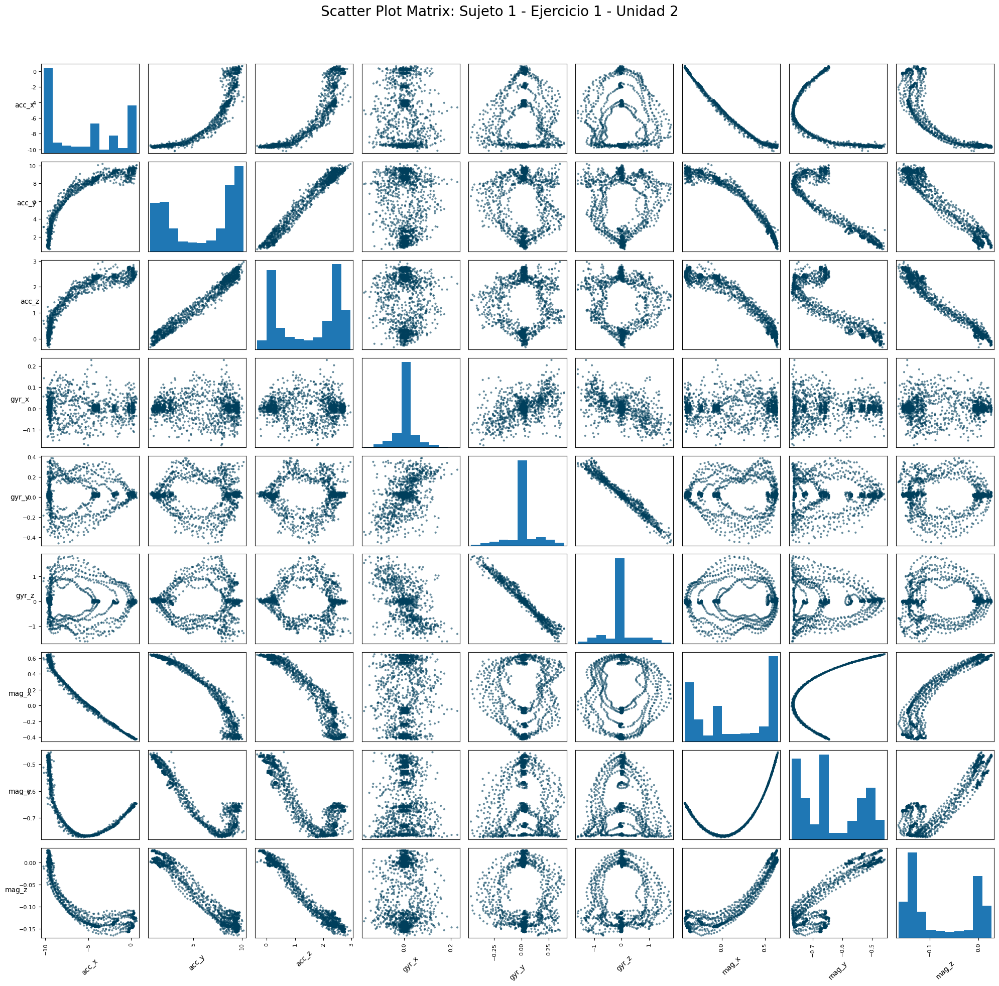

In [ ]:
f.plot_scatter(1, 1, 2, templates)

Se pueden notar la correlación directa existente entre los diferentes ejes del acelerómetro, además de una correlación negativa entre el magnetómetro. Pasa algo muy curioso con el giroscopio y las demás variables y es que los gráficos tienen patrones simétricos que podrían indicar una relación cíclica u oscilatoria entre las variables. Las zonas más densas (con puntos agrupados) reflejan momentos de menor cambio, probablemente durante el tiempo que la pierna se mantiene recta: levantada, sostenida o en reposo.

<Figure size 2000x2000 with 0 Axes>

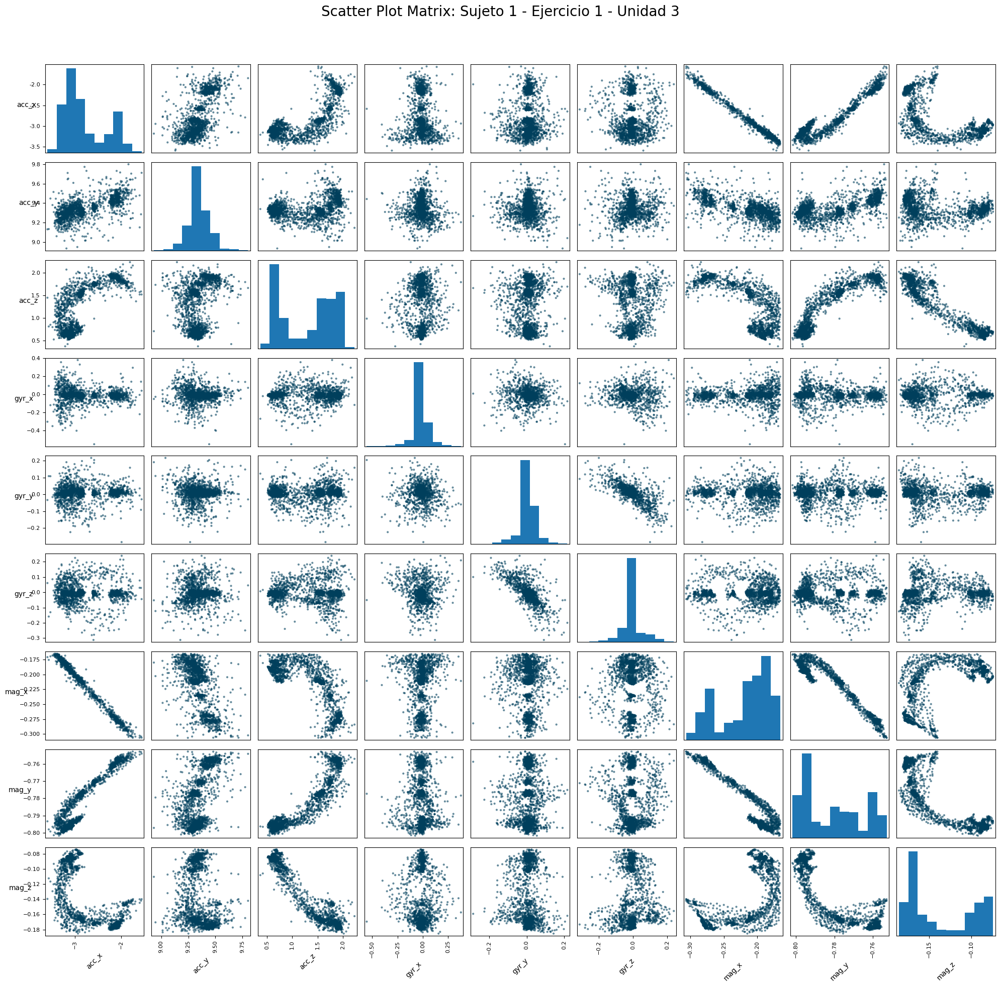

In [ ]:
f.plot_scatter(1, 1, 3, templates)

Este corresponde a la correlación entre las variables asociadas al sensor de la rodilla, estas presentan patrones menos obvios, pero que están presentes. La fuerte concentración en el centro para el magnetómetro y giroscopio sugiere que la orientación y rotación del sensor son relativamente estables en la mayoría de los momentos. Sin embargo, hay una dispersión significativa en algunos gráficos como gyr_x con mag_y lo que puede indicar que en ciertos puntos del ejercicio (levantamiento o descenso de la pierna) hay una interacción más notable entre la orientación magnética y las rotaciones.

### Ejercicio dos: unidad 5

Este ejercicio consiste en sentarse erguido en un taburete con los brazos colgando hacia abajo. Desde esa posición, inclinar el torso hacia adelante a un ángulo de 30°, manteniendo la postura durante 5 segundos. Finalmente, regresa a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en la rodilla derecha, 2 en la muñeca derecha, 3 en el codo derecho, 4 en el hombro derecho y 5 en el pecho.


<Figure size 2000x2000 with 0 Axes>

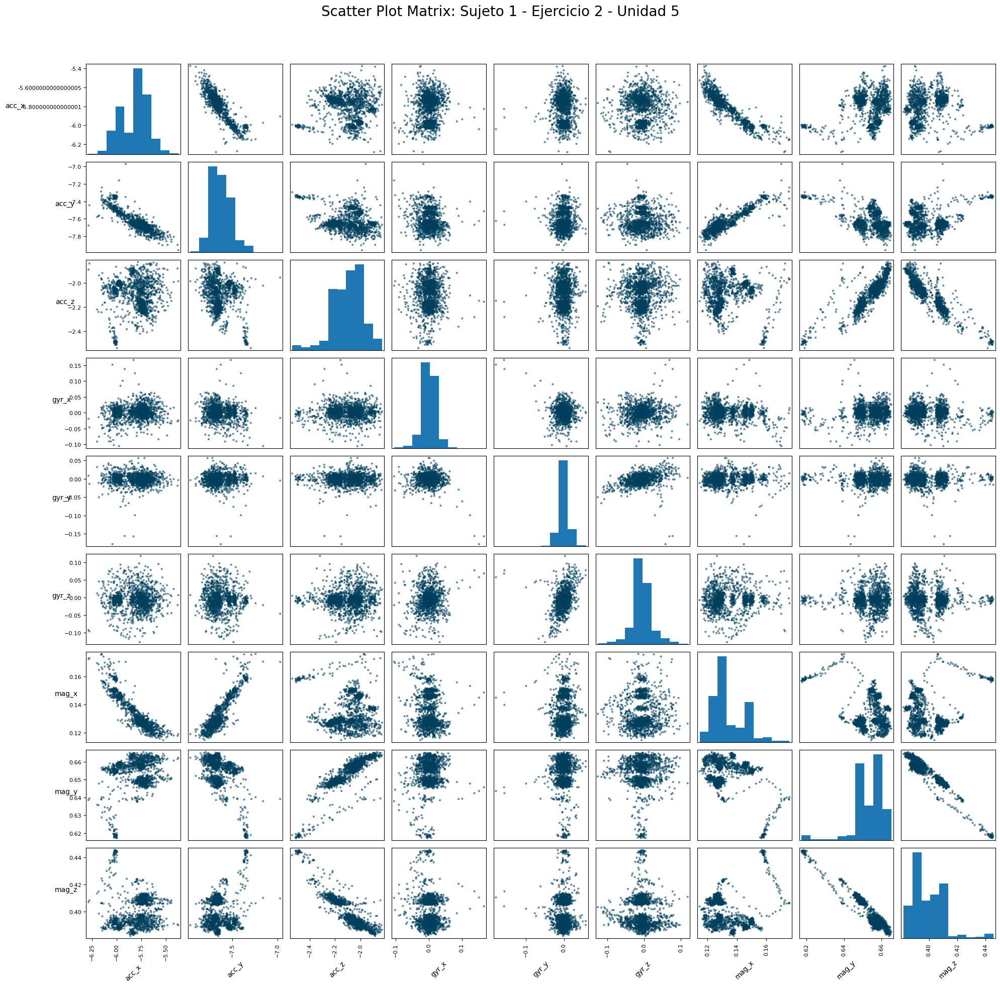

In [ ]:
f.plot_scatter(1, 2, 5, templates)

Las variables del magnetómetro (mag_x, mag_y, mag_z) presentan patrones más dispersos, con cierta correlación lineal con los datos del acelerómetro, especialmente en acc_x y acc_y. Esto indica que la orientación del pecho respecto al campo magnético cambia de manera consistente durante el movimiento de inclinación y retorno. Las relaciones entre las variables del giroscopio y el magnetómetro son más dispersas y tienen una acumulación significativa cerca de cero, especialmente en gyr_x y gyr_y. Esto sugiere que las rotaciones del torso son suaves y limitadas durante el ejercicio, particularmente al mantener la postura. Las rotaciones (giroscopio) son limitadas, lo que es consistente con la estabilidad esperada en este ejercicio. El magnetómetro complementa al acelerómetro al proporcionar información sobre la orientación relativa del torso respecto al campo magnético.

### Ejercicio cinco: unidad 2 y 3

Este ejercicio consiste en acostarse boca abajo en una superficie plana. Desde esa posición, debes levantar la pierna derecha desde la articulación de la cadera, manteniendo tanto la rodilla derecha como la pierna izquierda completamente rectas. Luego, sostén la postura durante 5 segundos. Finalmente, regresa la pierna derecha a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en la rodilla derecha, 4 en la rodilla izquierda y 5 en el pecho.

<Figure size 2000x2000 with 0 Axes>

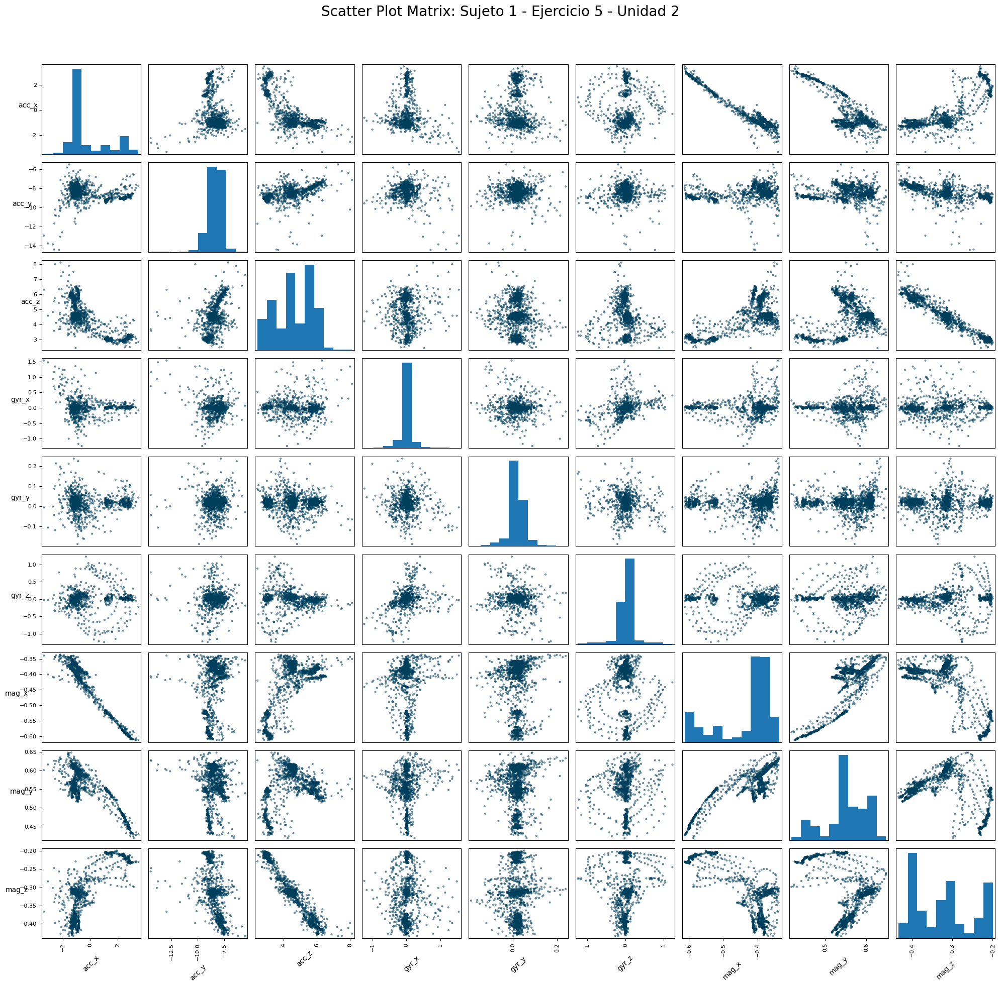

In [ ]:
f.plot_scatter(1,5,2,templates)

Se observa una correlación inversa entre acc_x y acc_z, lo que podría reflejar la interacción entre la aceleración gravitacional y la dinámica del movimiento al levantar y bajar la pierna derecha. La dispersión más centrada en gyr_y y gyr_z indica que las rotaciones son mínimas en estos ejes, lo cual es esperable si el tobillo permanece relativamente estable mientras la pierna se eleva y baja. Los patrones dispersos entre gyr_x y acc_x sugieren que ambos están fuertemente influenciados por el movimiento principal de la pierna. Las relaciones entre mag_x, mag_y, y mag_z son más consistentes, indicando un cambio gradual de orientación a medida que la pierna se mueve hacia arriba y vuelve a la posición inicial.

<Figure size 2000x2000 with 0 Axes>

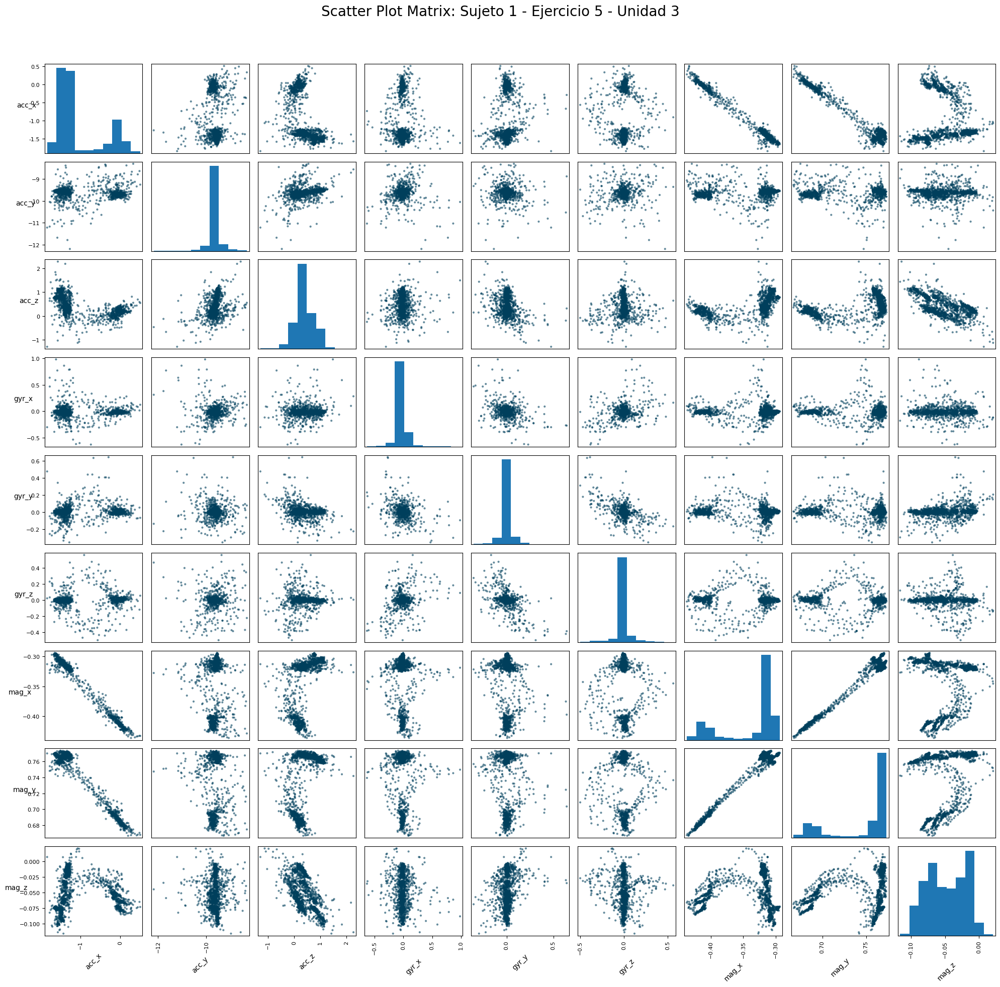

In [ ]:
f.plot_scatter(1,5,3,templates)

acc_y muestra una menor correlación con los otros ejes, probablemente porque captura movimientos laterales o ajustes mínimos en la posición de la rodilla. Los sensores gyr_x y gyr_z muestran mayor dispersión, sugiriendo que estos ejes registran rotaciones más significativas, posiblemente relacionadas con los ajustes de la rodilla al iniciar o terminar el movimiento. La relación entre gyr_x y acc_x refleja una interacción dinámica significativa, ya que ambos ejes están alineados con el movimiento principal de la pierna.Los patrones inclinados entre los datos del acelerómetro y giroscopio reflejan la sincronización entre la aceleración lineal y las rotaciones en la articulación de la rodilla.  Nuevamente se aprecian patrones cíclicos entre gyr_z y mag_x y mag_y.


## Descomposición estacional

La descomposición estacional es un método que permite modelar los factores estacionales de una serie temporal. Se utiliza para descomponer una serie temporal en sus componentes de tendencia, estacional y resto. La estacionalidad es la repetición de variaciones en una variable cada cierto período, que suele ser igual o menor a un año. Los fenómenos estacionales pueden ocurrir diariamente en una hora determinada, todos los días, o en un mes determinado a cada año.

Debido a lo extenso que resultaría el análisis si se considerase cada uno de las combinaciones entre sujetos, ejercicios y unidad, se decidió fijar la descomposición a un sujeto y un ejercicios: el primero, el número de unidades se mantuvo.

#### Ejercicio tomado

- **Primero:** Este ejercicio consiste en sentarse en una superficie plana y elevada. Desde esa posición, debes levantar la pierna derecha manteniéndola completamente recta. Luego, sostén esa postura durante 5 segundos, asegurándote de que la rodilla derecha permanezca extendida. Finalmente, baja la pierna con control y regresa a la posición inicial. Al ser un ejercicio de piernas, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en rodilla derecha, 4 en rodilla izquierda y 5 en pecho.


In [ ]:
def temp_decompose(sujeto, ejercicio, unidad, variable_set, freq=30):
    """
    Genera la descomposición temporal para las variables asociadas (x, y, z) de un sujeto, ejercicio y unidad.

    Parámetros:
    sujeto (int): Número del sujeto.
    ejercicio (int): Número del ejercicio.
    unidad (int): Número de la unidad.
    variable_set (str): Puede ser 'gyr', 'acc' o 'mag'.
    freq (int): Frecuencia esperada de estacionalidad (por defecto 30).

    Retorna:
    None. Muestra las gráficas de descomposición temporal.
    """
    key = f's{sujeto}e{ejercicio}u{unidad}'
    if key not in templates:
        print(f"Datos para la clave {key} no encontrados.")
        return

    data = templates[key]
    variables = [f"{variable_set}_x", f"{variable_set}_y", f"{variable_set}_z"]

    fig, axes = plt.subplots(4, 3, figsize=(18, 12), sharex=True)
    fig.suptitle(f"Descomposición Temporal - Sujeto {sujeto}, Ejercicio {ejercicio}, Unidad {unidad}, Variables: {variable_set}", fontsize=18)

    for i, var in enumerate(variables):
        if var not in data.columns:
            print(f"Variable {var} no encontrada en los datos.")
            continue
        decomposition = seasonal_decompose(data[var], model='additive', period=freq, extrapolate_trend='freq')

        axes[0, i].plot(decomposition.observed, label='Observado', color='purple')
        axes[0, i].set_title(f"{var} - Observado", fontsize=12)
        axes[0, i].legend()

        axes[1, i].plot(decomposition.trend, label='Tendencia', color='orange')
        axes[1, i].set_title(f"{var} - Tendencia", fontsize=12)
        axes[1, i].legend()

        axes[2, i].plot(decomposition.seasonal, label='Estacionalidad', color='green')
        axes[2, i].set_title(f"{var} - Estacionalidad", fontsize=12)
        axes[2, i].legend()

        axes[3, i].plot(decomposition.resid, label='Residuo', color='red')
        axes[3, i].set_title(f"{var} - Residuo", fontsize=12)
        axes[3, i].legend()

    plt.tight_layout(rect=[0, 0, 1, 0.94])
    plt.show()

#### Primer ejercicio y sujeto uno

##### Unidad 1

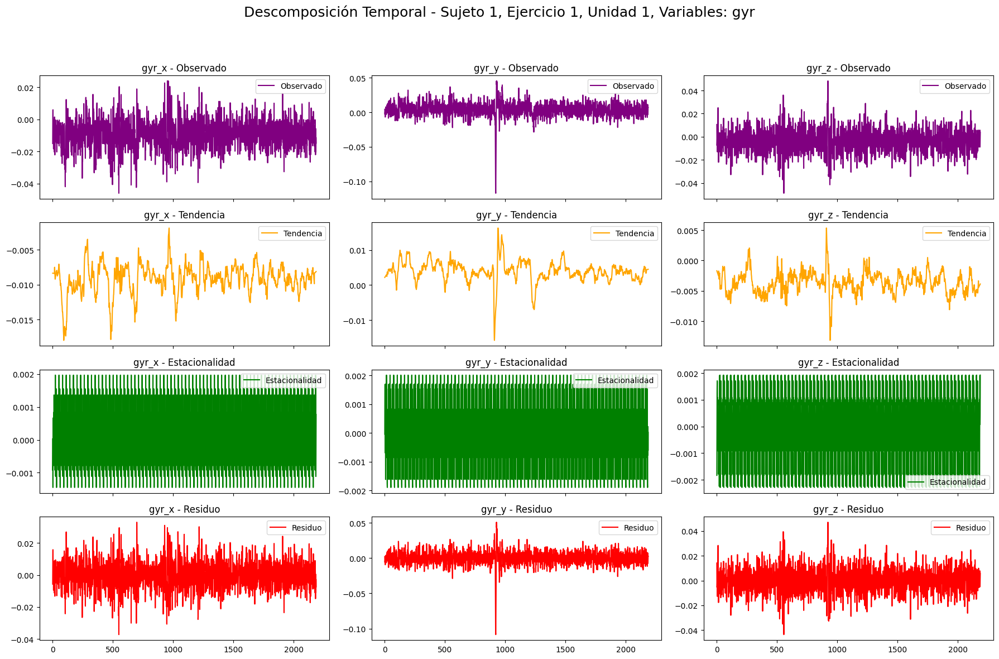

In [ ]:
temp_decompose(1,1,1, 'gyr')

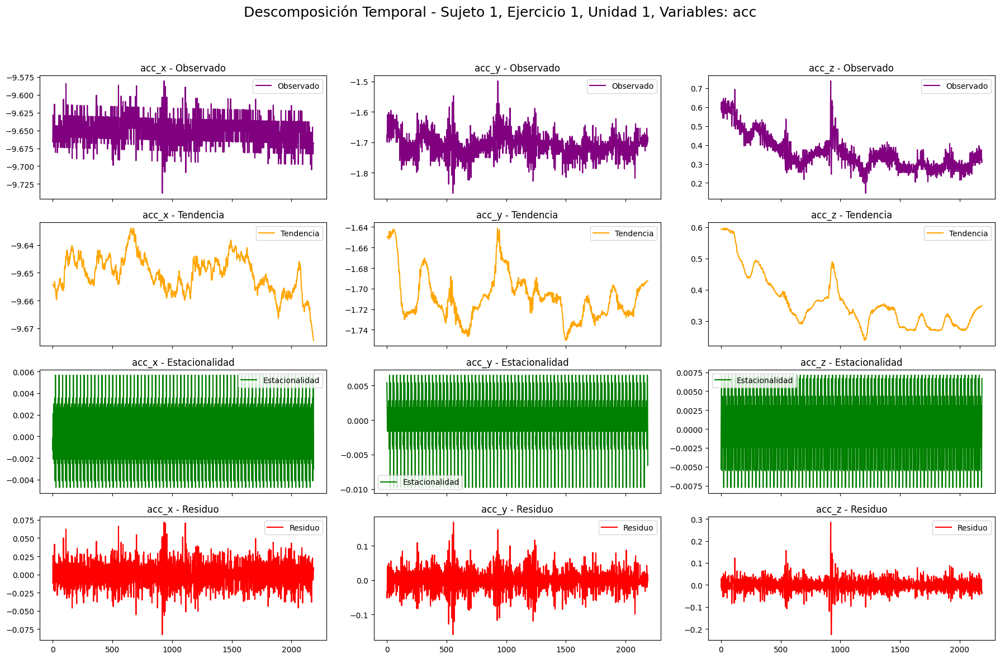

In [ ]:
temp_decompose(1,1,1, 'acc')

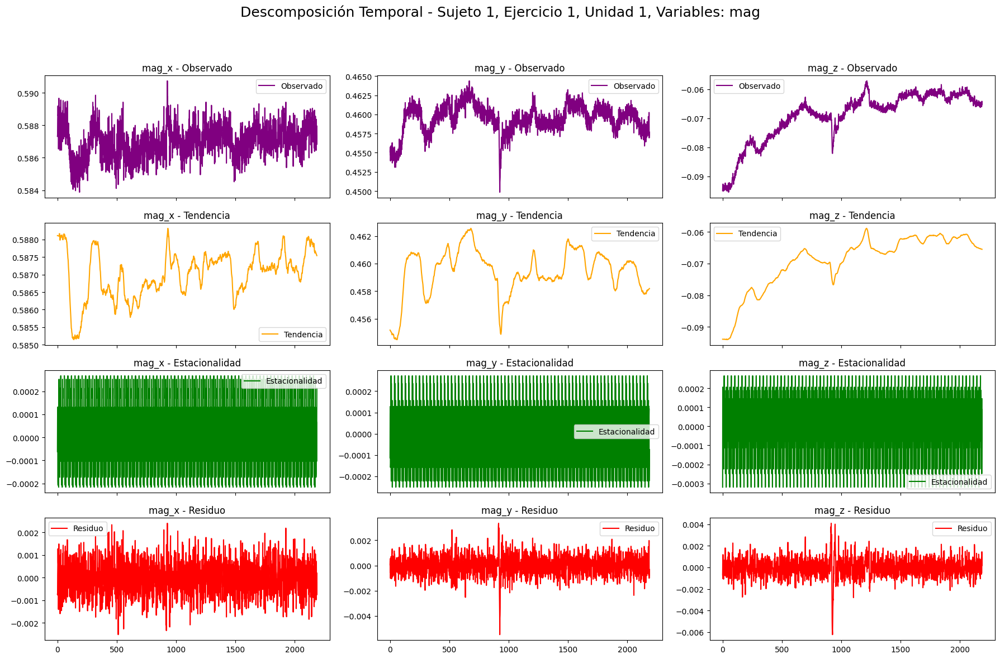

In [ ]:
temp_decompose(1,1,1, 'mag')

Para cada componente, las gráficas se muestran para las dimensiones x, y y z, que representan los ejes tridimensionales de los sensores (acc, gyr, mag). Esto permite analizar cómo el movimiento de la pierna derecha afecta a la señal en diferentes direcciones. La unidad 1 (ubicada en el tobillo izquierdo) es clave para capturar los movimientos compensatorios mientras la pierna derecha se eleva y sostiene la posición. Las variaciones en las gráficas de tendencia y estacionalidad reflejan ajustes específicos del tobillo durante el ejercicio.

- En el componente **tendencial** de cada sensor, el *giroscopio* muestra fluctuaciones constantes, lo que sugiere movimientos repetitivos del tobillo en el eje x. Esto podría estar relacionado con el balanceo lateral o ajustes durante el levantamiento de la pierna derecha, los picos abruptos en las tendencias (gyr_y y gyr_z) podrían coincidir con transiciones importantes en el ejercicio, como cuando se sostiene o baja la pierna derecha. Para el *acelerómetro*, la tendencia de acc_x muestra una disminución gradual hacia el final del ejercicio. Esto sugiere una reducción constante de la aceleración en el eje x, la señal acc_y presenta picos pronunciados a lo largo del ejercicio, indicando variaciones en la aceleración en el plano vertical y en el eje z, la tendencia muestra variaciones significativas al inicio, seguidas de un patrón más estable con pequeñas oscilaciones hacia el final. Por último, para el *magnetómetro*, la tendencia en mag_x muestra fluctuaciones iniciales y luego un patrón oscilatorio con pequeñas variaciones a lo largo del tiempo, la señal mag_y presenta picos pronunciados y descensos bruscos, lo que indica ajustes significativos en la orientación en el eje y, en mag_z, la tendencia muestra un incremento inicial pronunciado, seguido de una estabilización con oscilaciones menores hacia el final.

- Componentes **estacionales** y **residuales**
    - **gyr**: La estacionalidad de gyr_x refleja un patrón regular y repetitivo con picos y valles constantes, en gyr_y sucede algo similar pero con una amplitud distinta, y la estacionalidad en gyr_z también muestra un patrón repetitivo, con oscilaciones más pequeñas comparadas con gyr_x y gyr_y. Esto puede deberse a un menor impacto del movimiento en el eje z. En cuanto a los residuos de gyr_x muestran fluctuaciones que no son explicadas por la tendencia ni la estacionalidad. Estas variaciones podrían reflejar movimientos aleatorios o ruido en la señal, en gyr_y incluyen un evento atípico cerca del índice 1000 que está presente también el en magnetómetro, y en gyr_z también presentan fluctuaciones consistentes, aunque sin anomalías evidentes.

    - **acc**: La estacionalidad es clara en los tres ejes, mostrando patrones cíclicos consistentes con el movimiento repetitivo del ejercicio. Los residuos reflejan principalmente ruido o pequeñas variaciones en los movimientos del tobillo, con un pico significativo, lo que podría indicar un movimiento abrupto o una anomalía durante el ejercicio.

    - **mag**: La estacionalidad es clara en los tres ejes, mostrando patrones cíclicos consistentes con el movimiento repetitivo del ejercicio. Los residuos reflejan principalmente ruido o pequeñas variaciones en los movimientos del tobillo, con picos significativos en y y z, justo en el mismo momento, lo que podría indicar un movimiento abrupto o una anomalía durante el ejercicio.


##### Unidad 2

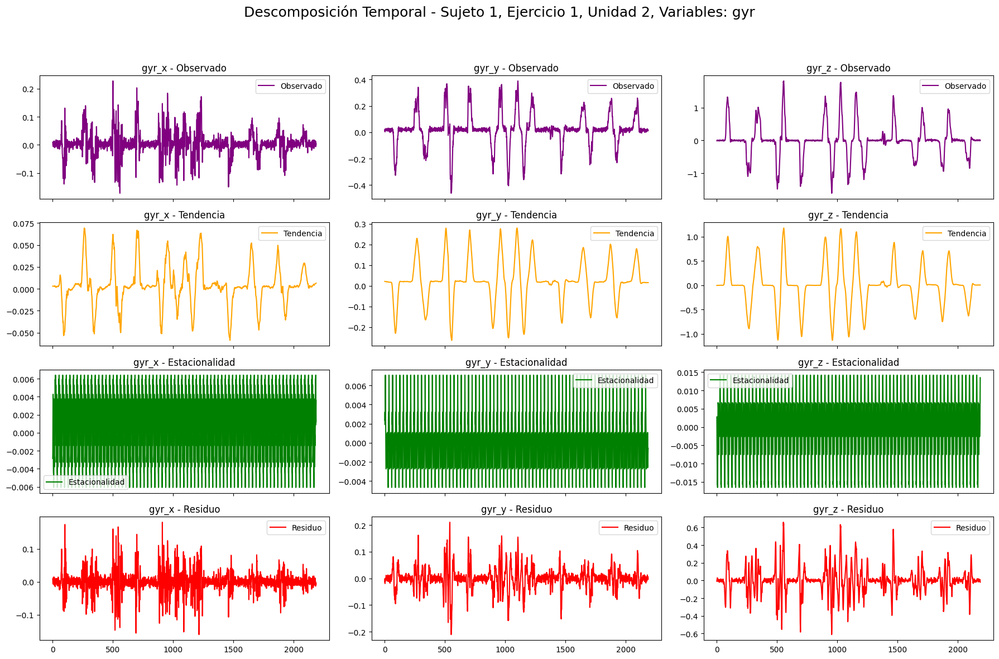

In [ ]:
temp_decompose(1,1,2, 'gyr')

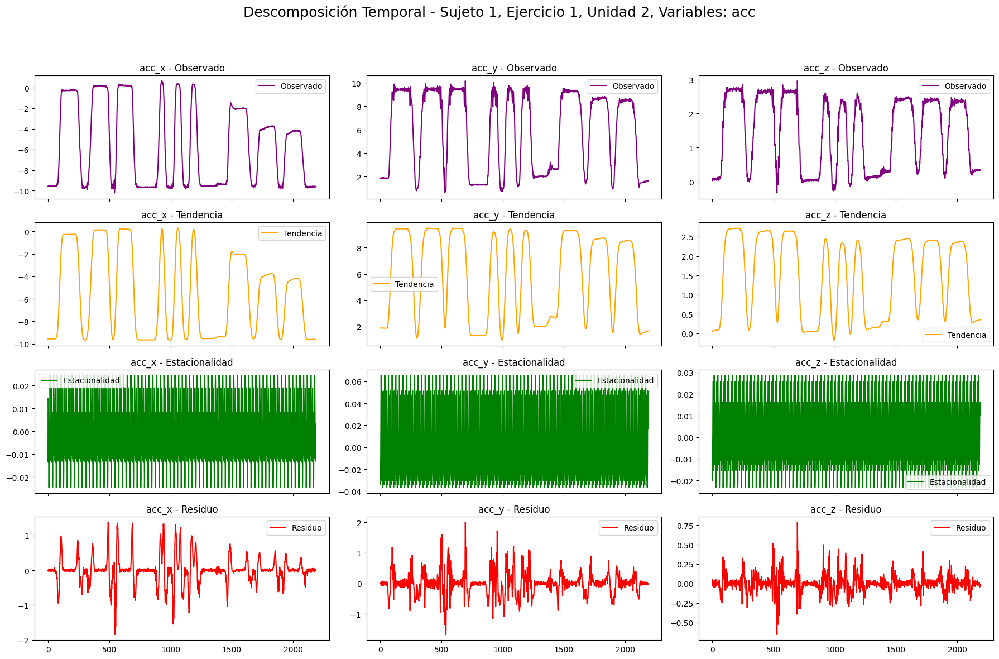

In [ ]:
temp_decompose(1,1,2, 'acc')

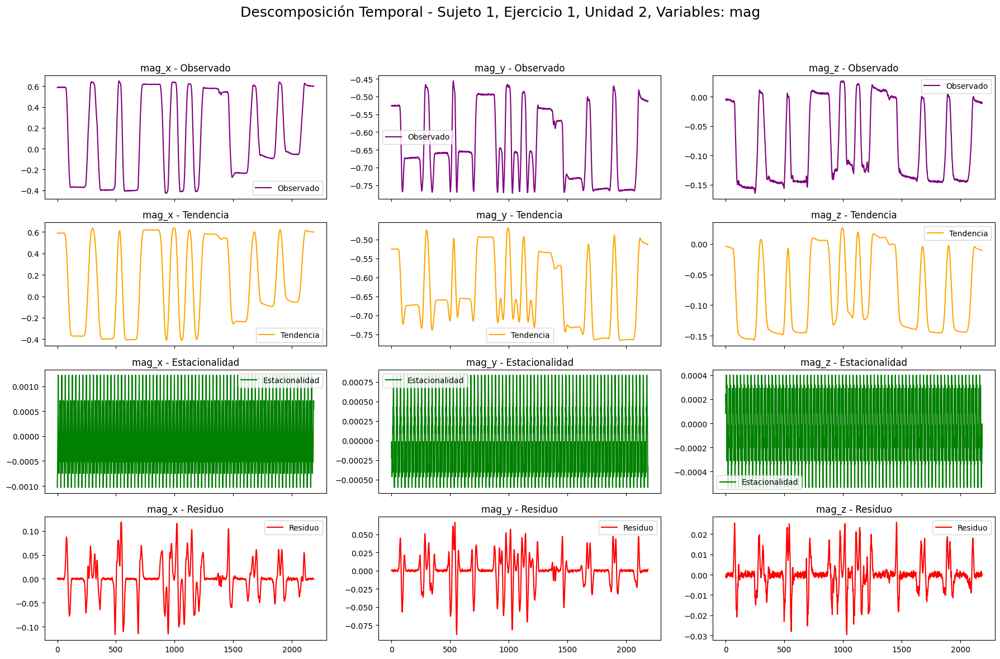

In [ ]:
temp_decompose(1,1,2, 'mag')

- **Giroscopio**
    - **Componente tendencial:** en los ejes `gyr_x`, `gyr_y` y `gyr_z`, las tendencias muestran picos regulares y repetitivos. Esto indica movimientos consistentes y cíclicos asociados con el levantamiento de la pierna derecha, donde el tobillo derecho lidera el movimiento. Los picos son más claros y presentan menor variación en `gyr_z`, lo cual sugiere un mayor rango de movimiento rotacional en este eje.   
    - **Componente estacional:** las gráficas muestran patrones altamente repetitivos, lo que confirma la naturaleza periódica del movimiento. La estacionalidad es más notoria en `gyr_z`, que parece capturar mejor las variaciones rítmicas del ejercicio.
    - **Componente residual:** los residuos en `gyr_x` y `gyr_y` tienen valores pequeños pero con algunas variaciones más marcadas, posiblemente asociadas a ligeros ajustes o inconsistencias durante el movimiento. En `gyr_z`, los residuos son mayores, lo que podría indicar microvariaciones o desajustes en el rango de movimiento del tobillo derecho.

- **Acelerómetro**
    - **Componente tendencial:** en los ejes `acc_x`, `acc_y` y `acc_z`, las tendencias muestran picos abruptos y definidos, lo que sugiere una transición marcada entre el inicio, el levantamiento de la pierna y su retorno a la posición inicial. Este comportamiento es consistente con la dinámica del ejercicio donde la aceleración en los tres ejes está influenciada por el control del movimiento.  
    En `acc_x`, los picos negativos reflejan el descenso controlado, mientras que en `acc_y` y `acc_z`, los valores positivos indican la elevación de la pierna.  
    - **Componente estacional:** las gráficas presentan oscilaciones cíclicas muy pronunciadas y repetitivas, indicando la naturaleza periódica del ejercicio. El eje `acc_y` destaca por capturar patrones de mayor amplitud, posiblemente relacionados con el movimiento vertical del tobillo.  
    - **Componente residual:** los residuos muestran oscilaciones significativas en todos los ejes (`acc_x`, `acc_y`, `acc_z`), con mayores variaciones en `acc_x`. Esto podría ser el resultado de microajustes al estabilizar la pierna o desbalances momentáneos durante el movimiento. Los residuos más controlados en `acc_y` y `acc_z` indican una mayor consistencia en esos ejes.  

- **Magnetómetro**
    - **Componente tendencial:** en `mag_x`, `mag_y` y `mag_z`, las tendencias presentan oscilaciones marcadas y regulares, lo que indica cambios consistentes en la orientación del tobillo derecho en relación con el campo magnético terrestre. En particular, `mag_x` y `mag_y` tienen variaciones significativas que reflejan la orientación horizontal y vertical durante el levantamiento y descenso de la pierna.  
    En `mag_z`, los picos son más constantes y con menor amplitud, sugiriendo una estabilidad relativa en este eje, probablemente influida por la naturaleza del movimiento hacia arriba y hacia abajo.  

    - **Componente estacional:** las gráficas muestran patrones cíclicos con alta repetitividad, lo que confirma que el magnetómetro captura la periodicidad del ejercicio. `mag_x` y `mag_y` tienen amplitudes mayores, lo que indica que el movimiento en estos ejes está más influenciado por las variaciones cíclicas del tobillo.  

    - **Componente residual:** los residuos tienen oscilaciones más marcadas en `mag_x` y `mag_y`, lo que sugiere pequeñas inconsistencias o ajustes durante la ejecución del movimiento. En `mag_z`, los residuos son más estables, reflejando una menor influencia de variaciones externas o desbalances en este eje específico.  


##### Unidad 3

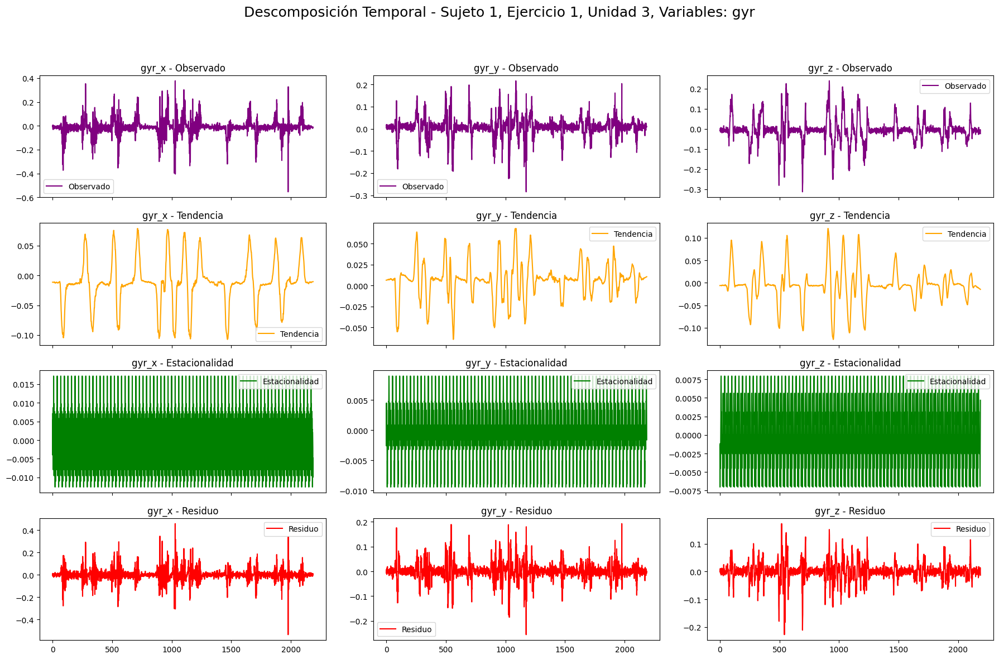

In [ ]:
temp_decompose(1,1,3, 'gyr')

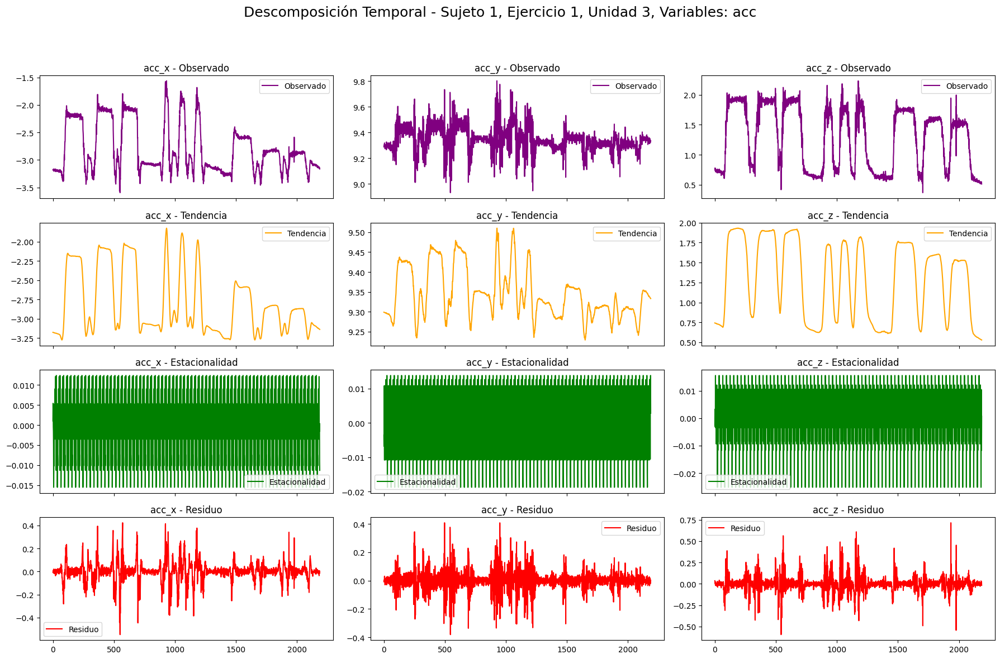

In [ ]:
temp_decompose(1,1,3, 'acc')

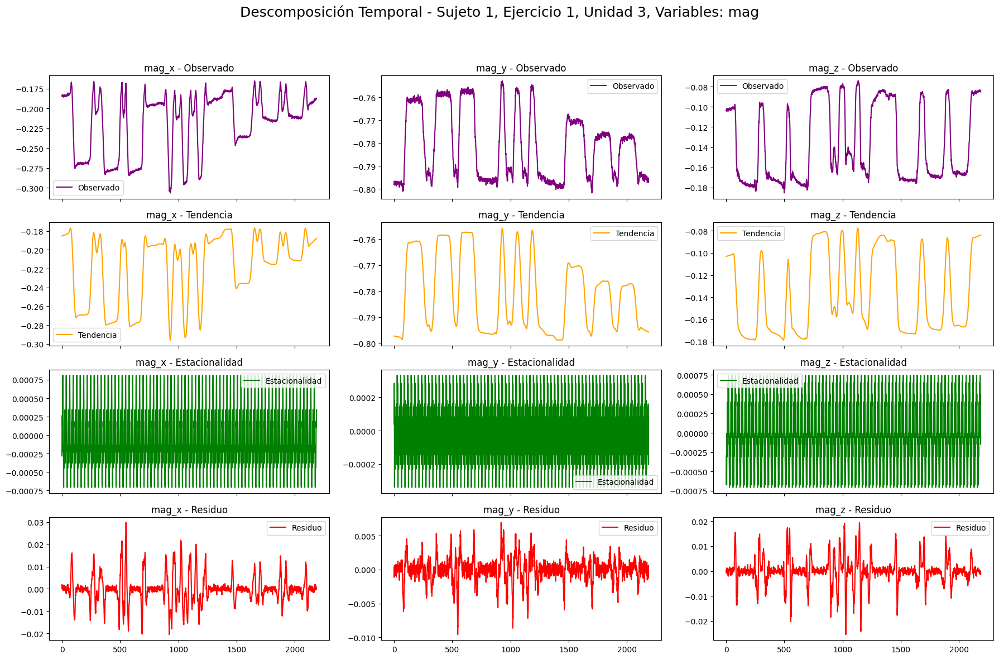

In [ ]:
temp_decompose(1,1,3, 'mag')

Esta corresponde a la rodilla derecha, por lo que tal como se esperaba, los componentes siguen una distribución similar a la encontrada en la unidad 2 o tobillo derecho, dado que es la articulación principal que guía el movimiento de flexión y extensión de la pierna. La periodicidad del ejercicio es evidente en los componentes estacionales, mientras que las tendencias reflejan los ciclos completos de movimiento

##### Unidad 4

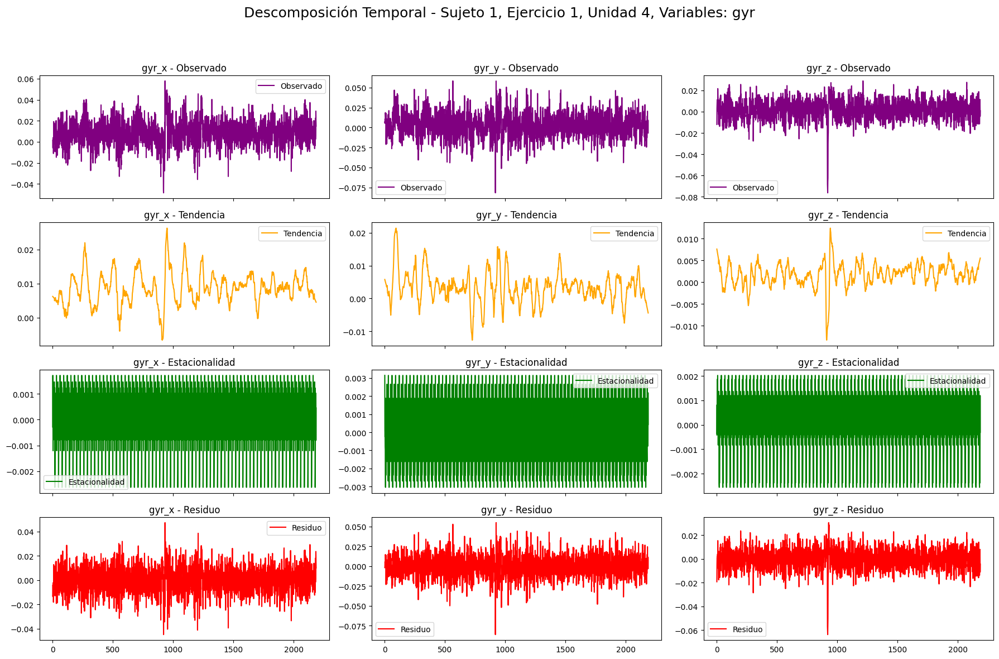

In [ ]:
temp_decompose(1,1,4, 'gyr')

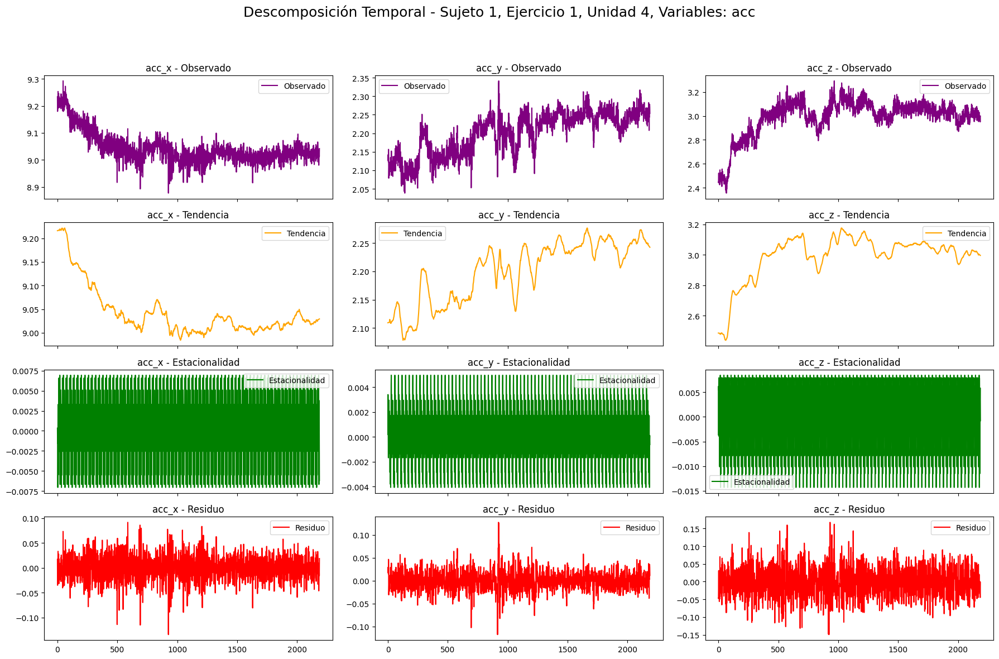

In [ ]:
temp_decompose(1,1,4, 'acc')

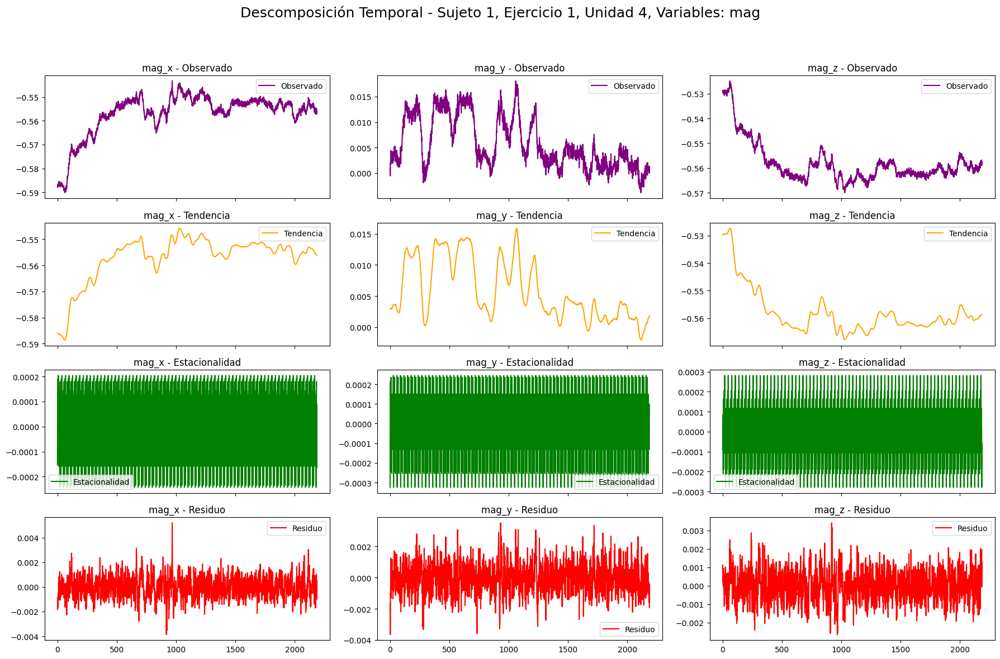

In [ ]:
temp_decompose(1,1,4, 'mag')

##### Unidad 5

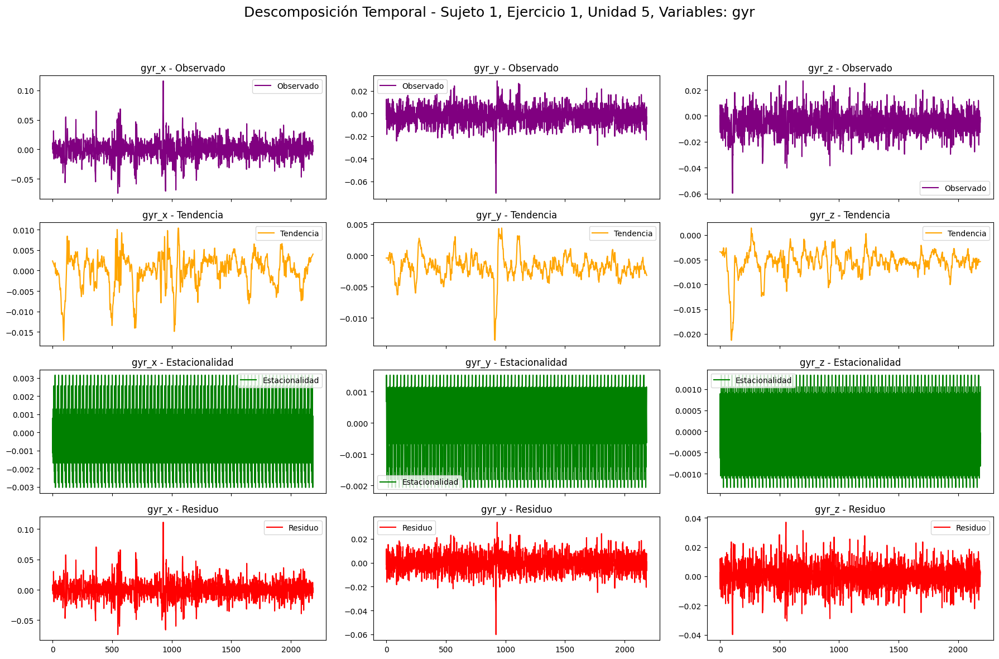

In [ ]:
temp_decompose(1,1,5, 'gyr')

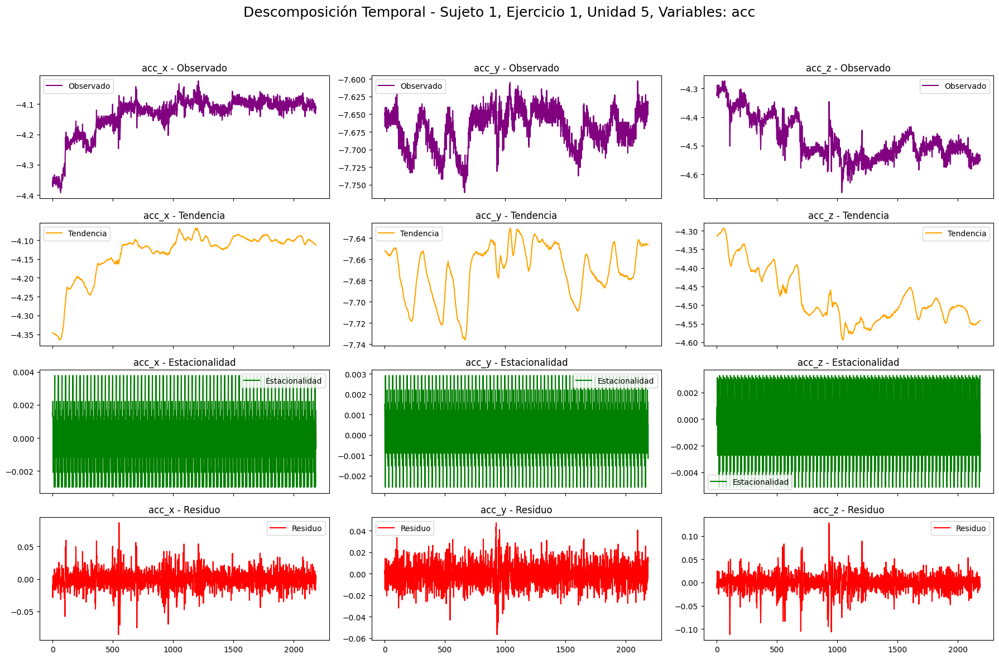

In [ ]:
temp_decompose(1,1,5, 'acc')

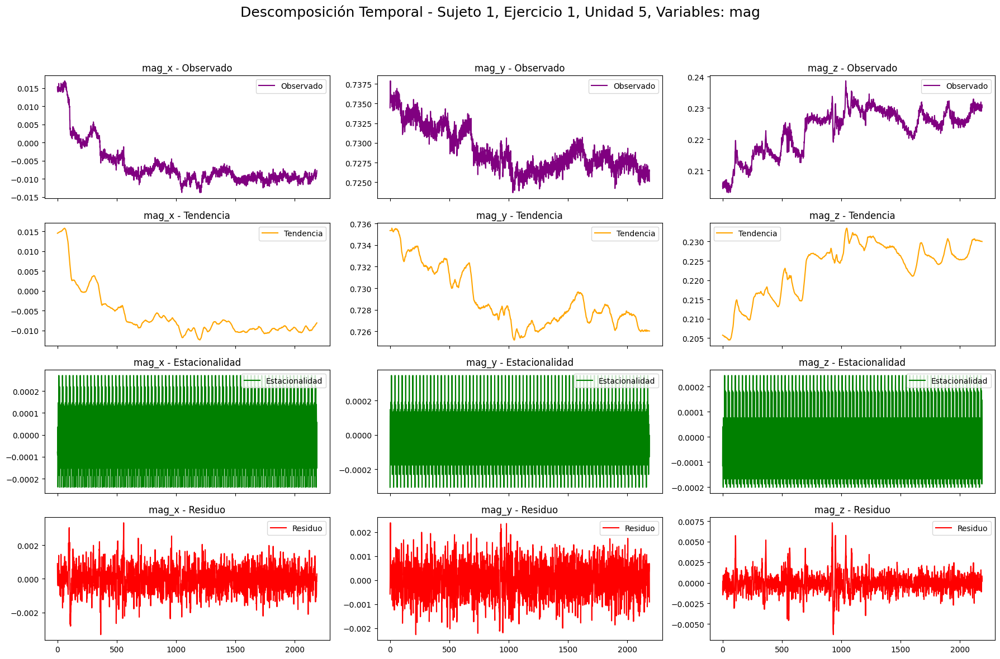

In [ ]:
temp_decompose(1,1,5, 'mag')

Tanto la unidad 4 como la 5 no se encuentran directamente relacionados con la ejecución del ejercicio.

La rodilla izquierda juega un rol secundario en este ejercicio, ya que sirve principalmente como soporte mientras la pierna derecha realiza el movimiento. Sin embargo, su actividad refleja ajustes menores para mantener la estabilidad y equilibrio del cuerpo. La unidad ubicada en el pecho registra el comportamiento del torso, que juega un rol clave en la estabilización y mantenimiento del equilibrio durante el ejercicio.



#### Test de Dickey - Fuller

El **Test de Dickey-Fuller** (o prueba de Dickey-Fuller) es una prueba estadística ampliamente utilizada en series temporales para verificar si una serie es **estacionaria**. En términos simples, se utiliza para evaluar si una serie tiene una raíz unitaria, lo cual implica que la serie no es estacionaria.
##### ¿Qué significa "estacionaria"?
Una serie temporal es estacionaria si sus propiedades estadísticas, como la media, la varianza y la autocovarianza, no cambian con el tiempo. Esto es importante porque muchos modelos de series temporales, como el ARIMA, requieren que los datos sean estacionarios.
##### Hipótesis del test de Dickey-Fuller
- **Hipótesis nula (\(H_0\)):** La serie tiene una raíz unitaria (no es estacionaria).
- **Hipótesis alternativa (\(H_a\)):** La serie es estacionaria.
El objetivo del test es rechazar \(H_0\) para concluir que la serie es estacionaria.
##### Resultados
El test produce:
1. **Estadístico de prueba:** Un valor que se compara con los valores críticos.
2. **Valores críticos:** Dependen del nivel de confianza (1%, 5%, 10%).
3. **p-value:** Probabilidad asociada a la hipótesis nula. Si \(p < 0.05\), se rechaza \(H_0\).
##### Interpretación
- **Si se rechaza \(H_0\):** La serie es estacionaria. Puede usarse directamente en modelos como ARIMA.
- **Si no se rechaza \(H_0\):** La serie no es estacionaria. Se pueden aplicar transformaciones (como diferencias) para lograr estacionariedad.


In [ ]:
def check_adf(variables):
    """
    Aplica el test de Dickey-Fuller a todas las combinaciones de sujetos, ejercicios y unidades,
    y determina qué series temporales son estacionarias.
    """
    sujetos = range(1, 6)
    ejercicios = range(1, 9)
    unidades = range(1, 6)
    columnas = ['acc_x', 'acc_y', 'acc_z',
                'gyr_x', 'gyr_y', 'gyr_z',
                'mag_x', 'mag_y', 'mag_z']
    resultados = []

    for s in sujetos:
        for e in ejercicios:
            for u in unidades:
                var_name = f's{s}e{e}u{u}'
                if var_name in variables:
                    data = variables[var_name]
                    for col in columnas:
                        if col in data.columns:
                            try:
                                adf_result = adfuller(data[col].dropna())
                                p_value = adf_result[1]
                                is_stationary = p_value < 0.05
                                resultados.append({
                                    'Sujeto': s,
                                    'Ejercicio': e,
                                    'Unidad': u,
                                    'Variable': col,
                                    'p-value': p_value,
                                    'Estacionaria': is_stationary
                                })
                            except Exception as ex:
                                resultados.append({
                                    'Sujeto': s,
                                    'Ejercicio': e,
                                    'Unidad': u,
                                    'Variable': col,
                                    'p-value': None,
                                    'Estacionaria': False,
                                    'Error': str(ex)
                                })
                else:
                    print(f"Datos no encontrados para {var_name}, continuando...")

    df_resultados = pd.DataFrame(resultados)
    return df_resultados



In [ ]:
resultados = check_adf(templates)

In [ ]:
len(resultados)

1800

In [ ]:
estacionarias = resultados[resultados['Estacionaria'] == True]
print("\nSeries estacionarias encontradas:")
print(estacionarias)


Series estacionarias encontradas:
      Sujeto  Ejercicio  Unidad Variable       p-value  Estacionaria
0          1          1       1    acc_x  1.205059e-03          True
1          1          1       1    acc_y  2.235463e-02          True
3          1          1       1    gyr_x  1.439182e-29          True
4          1          1       1    gyr_y  2.103648e-30          True
5          1          1       1    gyr_z  3.074255e-25          True
...      ...        ...     ...      ...           ...           ...
1795       5          8       5    gyr_y  1.305339e-21          True
1796       5          8       5    gyr_z  8.278205e-19          True
1797       5          8       5    mag_x  2.410375e-03          True
1798       5          8       5    mag_y  3.261641e-05          True
1799       5          8       5    mag_z  3.253096e-03          True

[1595 rows x 6 columns]


Se encontró que de las 1800 series temporales (correspondientes a las 9 variables de las 200 bases de datos) 1595 son estacionarias, basados en el test de Dickey Fuller.

In [ ]:
freq = estacionarias.groupby(['Ejercicio','Unidad']).size().reset_index(name = 'Frecuencia')

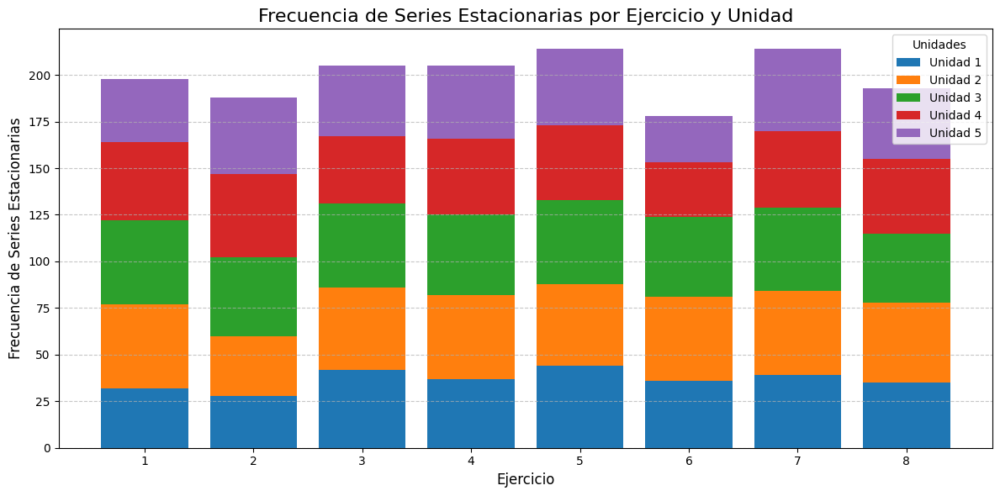

In [ ]:
plt.figure(figsize=(12, 6))

bottom = np.zeros(len(freq['Ejercicio'].unique()))

for unidad in freq['Unidad'].unique():
    subset = freq[freq['Unidad'] == unidad]
    plt.bar(
        subset['Ejercicio'],
        subset['Frecuencia'],
        bottom=bottom,
        label=f'Unidad {unidad}'
    )
    bottom += subset['Frecuencia'].values

plt.title('Frecuencia de Series Estacionarias por Ejercicio y Unidad', fontsize=16)
plt.xlabel('Ejercicio', fontsize=12)
plt.ylabel('Frecuencia de Series Estacionarias', fontsize=12)
plt.xticks(freq['Ejercicio'].unique())
plt.legend(title="Unidades")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

Se observa como hay variedad de las series de todas las unidades por ejercicio, realmente no hay una diferencia muy notable entre cada ejercicio que se deba destacar, parece que las proporciones por unidades estacionarias es similar.

## ACF y PACF
En el análisis de series temporales, las gráficas de la Función de Autocorrelación (ACF) y de la Función de Autocorrelación Parcial (PACF) son herramientas clave para identificar la estructura subyacente de una serie temporal. Mientras que la ACF muestra la correlación de una serie con sus propios valores en diferentes retardos (lags), la PACF muestra esta correlación eliminando los efectos de los retardos intermedios.

#### Función de Autocorrelación (ACF)
La ACF es una representación gráfica que muestra la correlación de una serie temporal con ella misma en diferentes retardos. El coeficiente de correlación mide qué tan relacionadas están dos variables.

- Un coeficiente de correlación de **1** indica una relación positiva perfecta.  
- Un coeficiente de **-1** indica una relación negativa perfecta.  
- Un coeficiente de **0** indica que no hay relación entre las variables.

La gráfica de la ACF es útil para identificar el orden de un modelo **AR** (Autorregresivo). El orden del modelo AR corresponde al número de retardos que deben incluirse en el modelo. Los picos en la gráfica de la ACF indican los retardos que tienen correlaciones significativas y, por lo tanto, deben ser considerados en el modelo.

#### Función de Autocorrelación Parcial (PACF)
La PACF es una representación gráfica que muestra la correlación de una serie temporal con sus valores en diferentes retardos, eliminando los efectos de los retardos previos. A diferencia de la ACF, la PACF aísla el efecto directo de cada retardo. La PACF se utiliza para identificar el orden de un modelo **MA** (Media Móvil). El orden del modelo MA corresponde al número de retardos que deben incluirse en el modelo. Los picos significativos en la gráfica de la PACF indican los retardos que son relevantes para el modelo.



In [ ]:
def plot_corrs(sujeto, ejercicio, unidad):

    """
    Genera gráficos de ACF y PACF para las 9 variables asociadas a un sujeto, ejercicio y unidad específicos.

    Parámetros:
    sujeto (int): Número del sujeto.
    ejercicio (int): Número del ejercicio.
    unidad (int): Número de la unidad.
    variables (dict): Diccionario con los datos organizados por clave 's{sujeto}e{ejercicio}u{unidad}'.

    Retorna:
    None. Muestra las gráficas en una matriz 9x2 (ACF y PACF por variable).
    """
    variables = templates

    key = f's{sujeto}e{ejercicio}u{unidad}'

    if key not in variables:
        print(f"Datos para la clave {key} no encontrados en el diccionario.")
        return

    data = variables[key]
    columnas = ['acc_x', 'acc_y', 'acc_z', 'gyr_x', 'gyr_y', 'gyr_z', 'mag_x', 'mag_y', 'mag_z']

    fig, axes = plt.subplots(len(columnas), 2, figsize=(12, 20))
    fig.suptitle(f'ACF y PACF para Sujeto {sujeto}, Ejercicio {ejercicio}, Unidad {unidad}', fontsize=16)

    for i, col in enumerate(columnas):
        if col not in data.columns:
            print(f"Columna {col} no encontrada en los datos.")
            continue


        plot_acf(data[col], ax=axes[i, 0], title=f'ACF - {col}')
        plot_pacf(data[col], ax=axes[i, 1], title=f'PACF - {col}')


    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

Debido a lo extenso que resultaría el análisis si se considerase cada uno de las combinaciones entre sujetos, ejercicios y unidad, se decidió fijar el análisis del ACF y PACF a un sujeto (distinto para cada ejercicio) y tres ejercicios: el primero, cuarto y octavo, el número de unidades se mantuvo.

#### Ejercicios tomados

- **Primero:** Este ejercicio consiste en sentarse en una superficie plana y elevada. Desde esa posición, debes levantar la pierna derecha manteniéndola completamente recta. Luego, sostén esa postura durante 5 segundos, asegurándote de que la rodilla derecha permanezca extendida. Finalmente, baja la pierna con control y regresa a la posición inicial. Al ser un ejercicio de piernas, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en rodilla derecha, 4 en rodilla izquierda y 5 en pecho.

- **Cuarto:** Este ejercicio consiste en acostarse boca arriba sobre una superficie plana. Desde esa posición, debes levantar la pierna derecha desde la articulación de la cadera, manteniendo tanto la rodilla derecha como la pierna izquierda completamente rectas. Luego, sostén la postura durante 5 segundos. Finalmente, regresa la pierna derecha a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en el tobillo izquierdo, 2 en el tobillo derecho, 3 en la rodilla derecha, 4 en la rodilla izquierda y 5 en el pecho.

- **Octavo:** Este ejercicio consiste en acostarse boca abajo sobre una superficie plana y elevada, dejando el brazo derecho colgando por el lado desde el codo. Desde esa posición, eleva el antebrazo derecho hasta extender completamente el codo. Mantén esta posición durante 5 segundos. Finalmente, regresa el brazo a la posición inicial con control. En este ejercicio, la distribución de las unidades de sensores está dada por 1 en la rodilla derecha, 2 en la muñeca derecha, 3 en el codo derecho, 4 en el hombro derecho y 5 en el pecho.

#### Primer ejercicio y sujeto uno

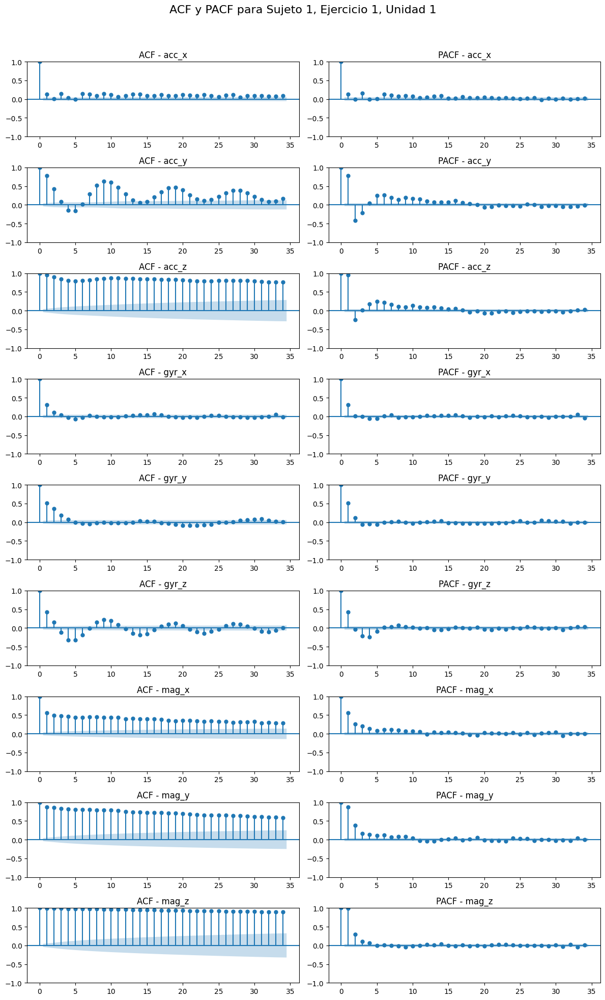

In [ ]:
plot_corrs(1, 1, 1)

**Acelerómetro:** La autocorrelación en `acc_z` muestra una periodicidad fuerte, probablemente asociada con la acción de soporte de la pierna izquierda al equilibrar el movimiento de la derecha. En `acc_x` y `acc_y`, los valores de autocorrelación son menores, lo que indica que las fuerzas laterales y longitudinales son menos significativas. En `acc_z`, el **PACF**, confirma que la estacionalidad es dominante y que los cambios en las observaciones están muy correlacionados con los pasos cíclicos del ejercicio.

**Giroscopio:** Las autocorrelaciones en `gyr_z` son relativamente más constantes, reflejando movimientos de rotación regulares en el tobillo izquierdo para estabilizar el cuerpo. En el PACF, los picos iniciales en `gyr_z` refuerzan la idea de un movimiento rotacional rítmico y consistente en el eje vertical del tobillo izquierdo.

Para la unidad 1 (tobillo izquierdo), los datos indican que esta pierna cumple un rol de soporte durante el ejercicio, lo que se refleja en las dependencias cíclicas claras en acc_z, gyr_z y mag_z. Los movimientos rotacionales y cambios de orientación son menores pero regulares, contribuyendo al equilibrio y estabilidad del cuerpo mientras la pierna derecha realiza el movimiento principal.

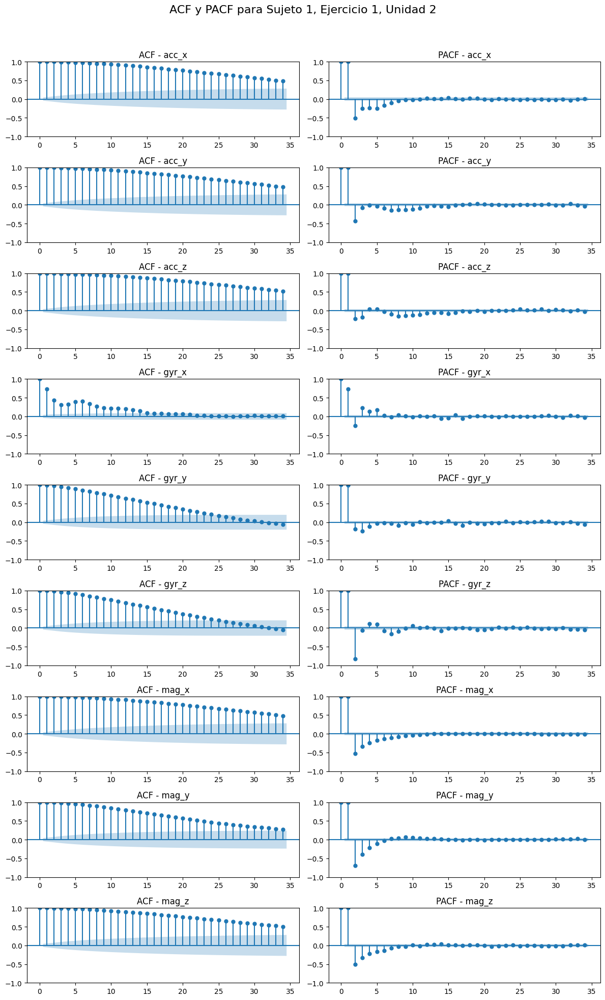

In [ ]:
plot_corrs(1, 1, 2)

La unidad 2 refleja directamente el movimiento principal del ejercicio. Las altas correlaciones en `acc_x`, `acc_z` y `gyr_z` destacan la importancia de los movimientos de elevación y rotación del tobillo derecho. Los patrones observados en `mag_z` confirman cambios constantes en la orientación durante el ejercicio. Estas gráficas validan que el tobillo derecho es el motor principal del movimiento en este ejercicio.

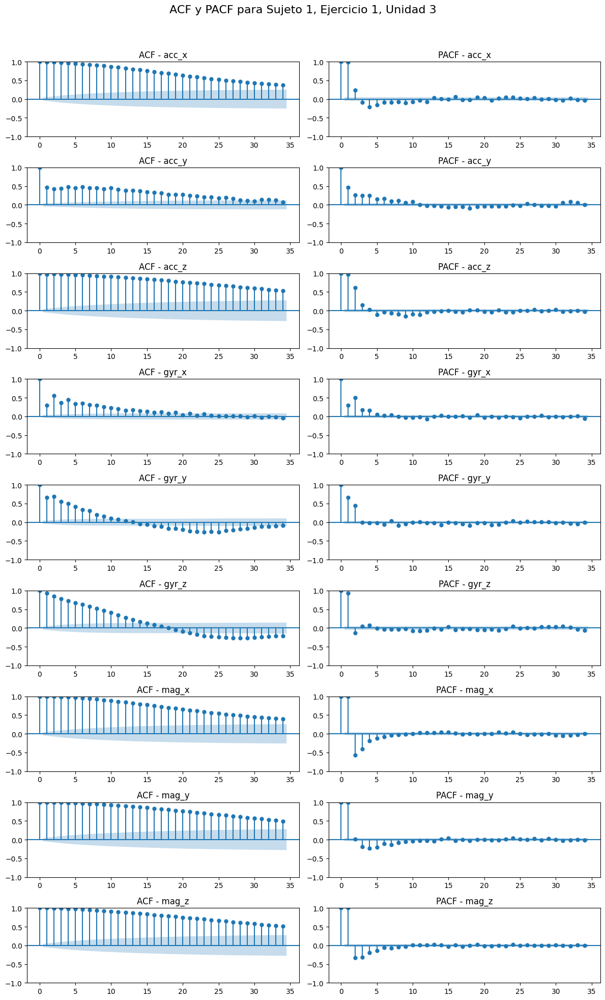

In [ ]:
plot_corrs(1, 1, 3)

En la unidad 3, ubicada en la rodilla derecha, las ACF y PACF muestran patrones claros de dependencia en las señales de aceleración y giroscopio, especialmente en acc_x y gyr_z. Esto sugiere que esta unidad captura de manera consistente las dinámicas del movimiento cíclico de la pierna, particularmente en la extensión y flexión de la rodilla, lo cual es clave en este ejercicio.

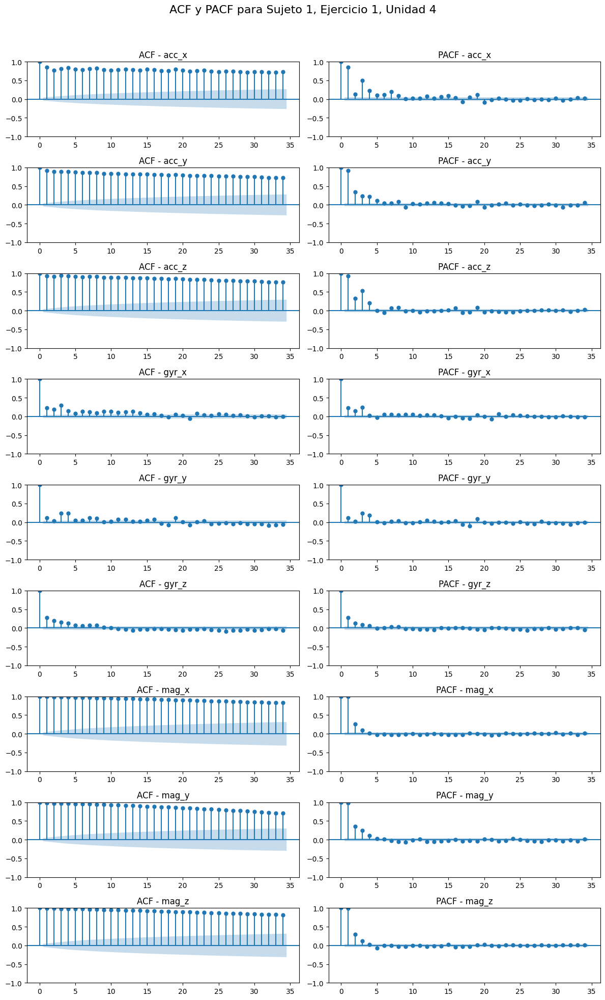

In [ ]:
plot_corrs(1, 1, 4)

En el giroscopio, los datos son más puntuales y reflejan los ajustes menores de la pierna y el control del movimiento durante la postura. El magnetómetro tiene un patrón más atenuado, lo que podría deberse a las características estáticas del sensor en la rodilla.

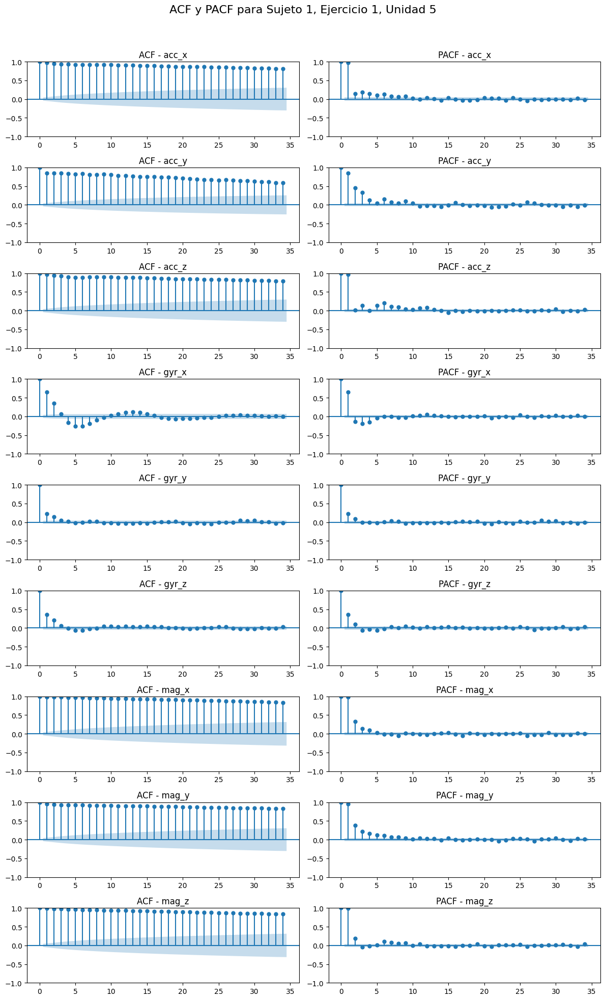

In [ ]:
plot_corrs(1, 1, 5)

La unidad 5 corresponde al sensor ubicado en el pecho, lo que implica que los datos reflejan el movimiento y la estabilización del torso durante el ejercicio. El ACF del acelerómetro muestra una alta correlación en los lags iniciales, disminuyendo gradualmente. Esto sugiere que los movimientos del torso tienen cierta periodicidad, probablemente reflejando el equilibrio y la estabilización del cuerpo mientras se realiza el ejercicio. En el giroscopio, el ACF cae rápidamente, lo que sugiere movimientos más puntuales y menos persistentes. Esto refleja que los giros del torso son mínimos y ocurren en momentos específicos (como para mantener el equilibrio), mientra sque el PACF muestra correlaciones significativas solo en los primeros lags, lo cual es coherente con los ajustes menores y breves en el torso.

# Modelos

## Pliegues

In [ ]:
particiones = [7, 14, 21, 28]

In [ ]:
def pliegues (inicio, fin, sep, X, y):
    X_train, y_train = X.iloc[inicio:fin], y.iloc[inicio:fin]
    X_test, y_test = X.iloc[fin + sep:fin + sep + 1], y.iloc[fin + sep:fin + sep + 1]
    return X_train, y_train, X_test, y_test

In [ ]:
def obtener_pligues_plot(isep):
    plieguess = []
    for s in range(1,2):
        for e in range(1,2):
            for u in range(1,2):
                variable = f's{s}e{e}u{u}'
                X = templates[variable].drop(columns=['time index','acc_x'])
                y = templates[variable]['acc_x']
                for sep in range(isep, isep+1):
                    for ti in particiones:
                        iniciotrain = 0
                        while (iniciotrain + ti + sep) < len(templates[variable]):
                            fintrain = iniciotrain + ti - 1
                            X_train, y_train, X_test, y_test = pliegues (iniciotrain, fintrain, sep, X, y)
                            plieguess.append([iniciotrain, fintrain, fintrain + sep,sep])
                            iniciotrain = iniciotrain + 1
    return plieguess

Para la visualización de los pliegues, se tomó de ejemplo del primer sujeto con el primer ejercicio y la primera unidad.

In [ ]:
def plot_pliegues_inv(plieguess_df, n=10):
    """
    Grafica las primeras n particiones y resalta en rojo los segmentos de entrenamiento.

    Args:
        plieguess_df (pd.DataFrame): DataFrame con las columnas ['inicio', 'fin', 'train', 'T'].
        n (int): Número de particiones iniciales a graficar.
    """
    plt.figure(figsize=(12, 6))

    for idx, row in plieguess_df.iloc[-n:].iterrows():
        plt.hlines(y=row['train'], xmin=row['inicio']+1, xmax=row['fin']+1, color='blue', alpha=0.7, label='Split' if idx == 0 else "")
        plt.hlines(y=row['train'], xmin=row['train'], xmax=row['train']+1, color='red', linewidth=2, label='Training' if idx == 0 else "")

    plt.gca().invert_yaxis()
    plt.xlabel("Índice Temporal")
    plt.ylabel("Valores de Train")
    plt.grid()
    plt.legend()
    plt.show()

In [ ]:
temp = pd.DataFrame(plieguess, columns= ['inicio', 'fin', 'train', 'T'])

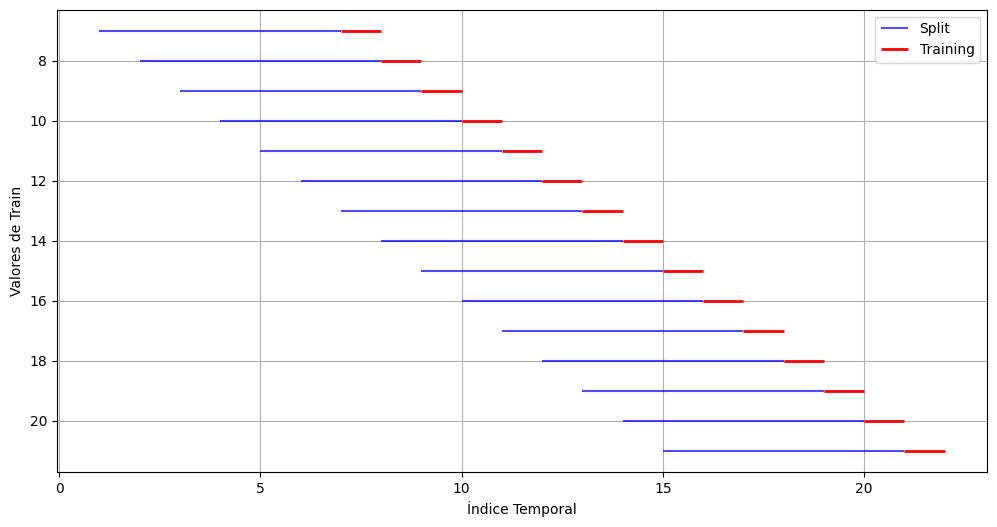

In [ ]:
plot_pliegues(temp,n = 15)

In [ ]:
temp = obtener_pligues_plot(2)
temp = pd.DataFrame(temp, columns= ['inicio', 'fin', 'train', 'T'])

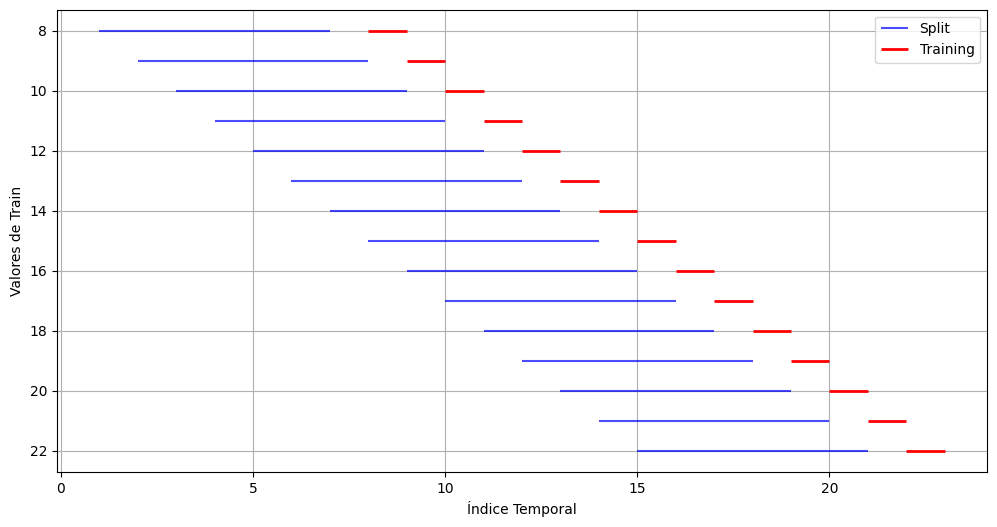

In [ ]:
plot_pliegues(temp,n = 15)

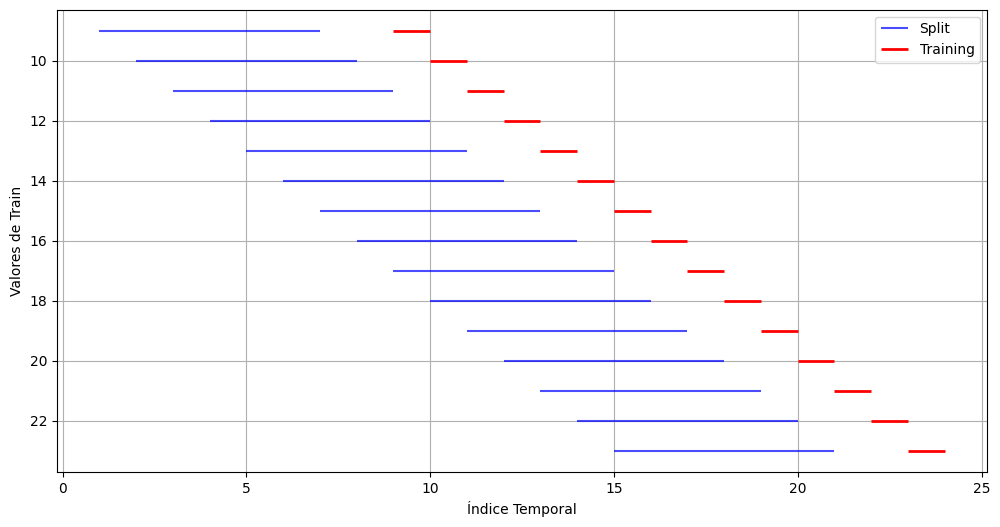

In [ ]:
temp = obtener_pligues_plot(3)
temp = pd.DataFrame(temp, columns= ['inicio', 'fin', 'train', 'T'])
plot_pliegues(temp,n = 15)

C:\Users\Valen\AppData\Local\Temp\ipykernel_11160\759576281.py:19: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


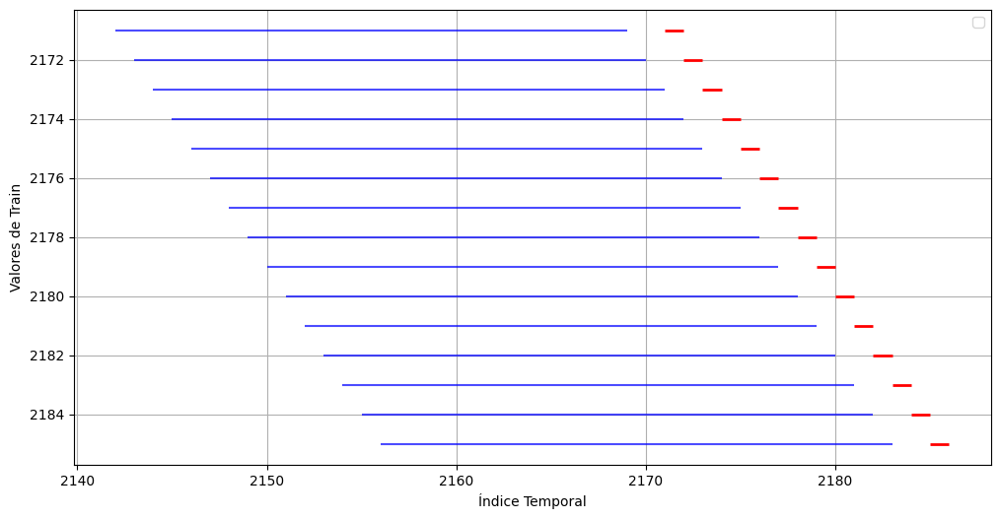

In [ ]:
temp = obtener_pligues_plot(3)
temp = pd.DataFrame(temp, columns= ['inicio', 'fin', 'train', 'T'])
plot_pliegues_inv(temp,n = 15)

Por cuestiones de tiempo, se limitó la realización de los modelos a un solo sujeto. Además de que se modificó la función de los pliegues para hacerla por segundos, es decir, 25 registros.


In [ ]:
def pliegues_25 (inicio, fin, sep, X, y):
    X_train, y_train = X.iloc[inicio:fin], y.iloc[inicio:fin]
    X_test, y_test = X.iloc[fin + (sep*25) - 24:fin + (sep*25)], y.iloc[fin + (sep*25) - 24:fin + (sep*25)]
    return X_train, y_train, X_test, y_test

In [ ]:
def errorporc(actual, predicho):
    res = np.empty(actual.shape)
    for j in range(actual.shape[0]):
        if actual[j] != 0:
            res[j] = (actual[j] - predicho[j]) / actual[j]
        else:
            res[j] = predicho[j] / np.mean(actual)
    return res

def MAPE(y_true, y_pred):
    return np.mean(np.abs(errorporc(np.asarray(y_true), np.asarray(y_pred))))*100

Este proceso se puede resumir con el siguiente código, para tomar el mejor modelo por cada variable del dataset.

In [ ]:
def mejor_modelo(e, data):
    best_models = []
    for i, model_data in enumerate(data):
        modelodata = pd.DataFrame(model_data)
        modelodata = modelodata[modelodata['Ejercicio'] == e]
        modelodata = modelodata[modelodata['R^2'] > 0]
        print(modelodata)
        if not modelodata.empty:
            best_model = modelodata.loc[
                modelodata.groupby(['Modelo', 'Unidad'])['RMSE'].idxmin()
            ].reset_index(drop=True)
            best_models.append(best_model)

    all_best_models = pd.concat(best_models, keys=range(len(data))).reset_index(level=0).rename(columns={'level_0': 'Variable_Index'})
    return all_best_models

Además, se presentan funcioes útiles para el análisis de los resultados obtenidos por los modelos.

# Mejores modelos finales por ejercicio, unidad y variable


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
cd "/content/drive/My Drive/data-mlpar3"

/content/drive/.shortcut-targets-by-id/1TiL2HS-l5J0x3ow3MDYYlYLi7vP1sUSQ/data-mlpar3


Fueron ejecutados en una maquina virtual con el siguiente código.

In [ ]:
for s in range(1,2):
    for e in range(1,9):
        for u in range(1,6):
            var_name = f's{s}e{e}u{u}'
            globals()[var_name] = pd.read_csv(rf'fisioterapia_dataset_regresion/s{s}/e{e}/u{u}/template_session.txt', sep = ';')

templates = {f's{s}e{e}u{u}': globals()[f's{s}e{e}u{u}'] for s in range(1, 2) for e in range(1, 9) for u in range(1, 6)}

def pliegues_25(inicio, fin, sep, X, y):
    X_train, y_train = X.iloc[inicio:fin], y.iloc[inicio:fin]
    X_test, y_test = X.iloc[fin + (sep * 25) - 24:fin + (sep * 25)], y.iloc[fin + (sep * 25) - 24:fin + (sep * 25)]
    return X_train, y_train, X_test, y_test

def errorporc(actual, predicho):
    res = np.empty(actual.shape)
    for j in range(actual.shape[0]):
        if actual[j] != 0:
            res[j] = (actual[j] - predicho[j]) / actual[j]
        else:
            res[j] = predicho[j] / np.mean(actual)
    return res

def MAPE(y_true, y_pred):
    return np.mean(np.abs(errorporc(np.asarray(y_true), np.asarray(y_pred)))) * 100


def run_model(objetivo, modelo_elegido):
    metricas = []
    param_grids = {
        'lineal': {},  # No hay hiperparámetros para Lineal
        'lasso': {
            'alpha': [0.1, 1, 10],
            'max_iter': [1000]
        },
        'ridge': {
            'alpha': [0.1, 1, 10],
            'max_iter': [1000]
        },
        'knn': {
            'n_neighbors': [3, 5, 7],
            'weights': ['uniform', 'distance'],
            'p': [1, 2]
        },
        'random_forest': {
            'n_estimators': [50, 100, 150],
            'max_depth': [None, 10, 20]
        },
        'svr': {
            'kernel': ['linear', 'rbf'],
            'C': [0.1, 1, 10]
        },
        'xgboost': {
            'learning_rate': [0.01, 0.1, 0.2],
            'n_estimators': [50, 100, 150],
            'max_depth': [3, 5, 7]
        }
    }

    def procesar_comb(variable, sep, ti, modelo_elegido, obj):
        objetivo = obj
        X = templates[variable].drop(columns=['time index', objetivo])
        y = templates[variable][objetivo]

        if modelo_elegido == 'knn':
            modelo_base = KNeighborsRegressor()
        elif modelo_elegido == 'lineal':
            modelo_base = LinearRegression()
        elif modelo_elegido == 'lasso':
            modelo_base = Lasso()
        elif modelo_elegido == 'ridge':
            modelo_base = Ridge()
        elif modelo_elegido == 'random_forest':
            modelo_base = RandomForestRegressor()
        elif modelo_elegido == 'xgboost':
            modelo_base = XGBRegressor()
        elif modelo_elegido == 'svr':
            modelo_base = SVR()

        param_grid = param_grids.get(modelo_elegido, {})
        param_combinations = list(ParameterGrid(param_grid)) if param_grid else [{}]

        resultado_local = []

        for params in param_combinations:
            start = 0
            resultados = []
            conjunto_test_total = []
            conjunto_validacion_total = []

            total_rmse_val = []
            total_mape_val = []
            total_r2_val = []
            total_ljungbox_pvalue = []
            total_jarquebera_pvalue = []

            errores_train = []
            errores_val = []
            errores_test = []

            modelo = modelo_base.set_params(**params)

            while (start + (ti + sep * 7) * 25) < len(X):
                fin_train = start + ti * 25
                fin_val = fin_train + 7 * 25
                fin_test = fin_val + 7 * 25

                X_train, y_train = X.iloc[start:fin_train], y.iloc[start:fin_train]
                X_val, y_val = X.iloc[fin_train:fin_val], y.iloc[fin_train:fin_val]
                X_test, y_test = X.iloc[fin_val:fin_test], y.iloc[fin_val:fin_test]

                modelo.fit(X_train, y_train)

                y_pred_val = modelo.predict(X_val)
                y_pred_test = modelo.predict(X_test)

                rmse_val = mean_squared_error(y_val, y_pred_val, squared=False)
                rmse_test = mean_squared_error(y_test, y_pred_test, squared=False)

                errores_val.append(rmse_val)
                errores_test.append(rmse_test)

                residuos_val = y_val - y_pred_val
                ljungbox_result = acorr_ljungbox(residuos_val, lags=[10], return_df=True)
                ljungbox_pvalue = ljungbox_result['lb_pvalue'].values[0]
                jarque_bera_result = jarque_bera(residuos_val)
                jarquebera_pvalue = jarque_bera_result[1]

                total_rmse_val.append(rmse_val)
                total_mape_val.append(MAPE(y_val, y_pred_val))
                total_r2_val.append(r2_score(y_val, y_pred_val))
                total_ljungbox_pvalue.append(ljungbox_pvalue)
                total_jarquebera_pvalue.append(jarquebera_pvalue)

                conjunto_test_total.extend(zip(y_test, y_pred_test))

                start += fin_test

            promedio_rmse_val = np.mean(total_rmse_val)
            promedio_mape_val = np.mean(total_mape_val)
            promedio_r2_val = np.mean(total_r2_val)
            promedio_ljungbox_pvalue = np.mean(total_ljungbox_pvalue)
            promedio_jarquebera_pvalue = np.mean(total_jarquebera_pvalue)

            resultado_local.append({
                    'Modelo': modelo_elegido,
                    'Hiperparámetros': params,
                    'Segundos': ti,
                    'Separación': sep,
                    'Unidad': variable.split('u')[-1],
                    'Ejercicio': variable.split('e')[-1][0],
                    'MAPE': promedio_mape_val,
                    'RMSE': promedio_rmse_val,
                    'R^2': promedio_r2_val,
                    'Ljung-Box p-value': promedio_ljungbox_pvalue,
                    'Jarque-Bera p-value': promedio_jarquebera_pvalue,
                    'Objetivo': objetivo,
                    'Predicciones': conjunto_test_total
                })

        return resultado_local

    resultados = Parallel(n_jobs=-1, backend='loky', verbose=2)(
        delayed(procesar_comb)(f's{s}e{e}u{u}', sep, ti, modelo_elegido, objetivo)
        for s in range(1, 2)
        for e in range(1, 9)
        for u in range(1, 6)
        for sep in range(1, 4)
        for ti in particiones
    )

    for res in resultados:
        metricas.extend(res)

    return metricas


columnas = ['gyr_x', 'gyr_y', 'gyr_z', 'acc_x', 'acc_y', 'acc_z', 'mag_x', 'mag_y', 'mag_z']

modelos = ['lineal','lasso','ridge','svr', 'xgboost', 'random_forest', 'knn']

particiones = [7, 14, 21, 28]

"""
for modelo in modelos:
    modelo_results = []
    for col in columnas:
        modelo_results.append(run_model(col, modelo))

    pickle_file_path = f"modelos/{modelo}_ff.pkl"
    with open(pickle_file_path, 'wb') as file:
        pickle.dump(modelo_results, file)
    print(f"Resultados del modelo '{modelo}' guardados en {pickle_file_path}.")

"""


'\nfor modelo in modelos:\n    modelo_results = []\n    for col in columnas:\n        modelo_results.append(run_model(col, modelo))\n\n    pickle_file_path = f"modelos/{modelo}_ff.pkl"\n    with open(pickle_file_path, \'wb\') as file:\n        pickle.dump(modelo_results, file)\n    print(f"Resultados del modelo \'{modelo}\' guardados en {pickle_file_path}.")\n\n'

In [ ]:
modelos = ['lineal', 'ridge', 'lasso', 'svr', 'random_forest', 'xgboost', 'knn']

for modelo in modelos:
    pickle_file_path = f"{modelo}_ff.pkl"
    try:
        name = f'{modelo}_varmodel'
        with open(pickle_file_path, 'rb') as file:
            globals()[name] = pickle.load(file)
        print(f"Resultados del modelo '{modelo}' cargados correctamente.")
    except FileNotFoundError:
        print(f"Archivo '{pickle_file_path}' no encontrado.")
    except Exception as e:
        print(f"Error al cargar '{pickle_file_path}': {e}")

Resultados del modelo 'lineal' cargados correctamente.
Resultados del modelo 'ridge' cargados correctamente.
Resultados del modelo 'lasso' cargados correctamente.
Resultados del modelo 'svr' cargados correctamente.
Resultados del modelo 'random_forest' cargados correctamente.
Resultados del modelo 'xgboost' cargados correctamente.
Resultados del modelo 'knn' cargados correctamente.


In [ ]:
def mejores_modelos(ejercicio, indice):
    modelos_positivos = []
    modelos = ['lineal', 'ridge', 'lasso', 'svr', 'random_forest', 'xgboost', 'knn']

    for modelo in modelos:
        key = f'{modelo}_varmodel'
        temp = globals()[key]
        temp = temp[indice]
        temp = pd.DataFrame(temp)
        temp = temp[temp['Ejercicio'] == ejercicio]
        temp = temp[temp['R^2'] > 0]
        modelos_positivos.append(temp)

    df_modelos_positivos = pd.concat(modelos_positivos, ignore_index=True)
    return df_modelos_positivos


In [ ]:
df = pd.DataFrame(mejores_modelos('1',3).sort_values(ascending=True, by= 'RMSE').iloc[0]['Predicciones'])

In [ ]:
pd.DataFrame(mejores_modelos('1',1).sort_values(ascending=True, by= 'MAPE'))

,Modelo,Hiperparámetros,Segundos,Separación,Unidad,Ejercicio,MAPE,RMSE,R^2,Ljung-Box p-value,Jarque-Bera p-value,Objetivo,Predicciones
230,xgboost,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",28,3,2,1,98.091224,0.017196,0.232975,0.324761,0.533079,gyr_y,"[{'y_real': 0.01646, 'y_pred': 0.02169762}, {'..."
169,xgboost,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,2,2,1,98.547920,0.017284,0.254626,0.337996,0.539178,gyr_y,"[{'y_real': 0.097889, 'y_pred': 0.0397648}, {'..."
168,xgboost,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,2,2,1,99.389691,0.017065,0.310151,0.334766,0.536550,gyr_y,"[{'y_real': 0.097889, 'y_pred': 0.038046446}, ..."
176,xgboost,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",28,2,2,1,100.393590,0.017408,0.240280,0.337893,0.513389,gyr_y,"[{'y_real': 0.097889, 'y_pred': 0.036083452}, ..."
223,xgboost,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,3,2,1,100.447735,0.017116,0.231732,0.323948,0.561753,gyr_y,"[{'y_real': 0.01646, 'y_pred': 0.015632726}, {..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,xgboost,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,3,3,1,731.510090,0.024409,0.022197,0.329701,0.618546,gyr_y,"[{'y_real': 0.00716, 'y_pred': 0.0076966453}, ..."
243,xgboost,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,2,3,1,744.784799,0.024190,0.023098,0.338914,0.618086,gyr_y,"[{'y_real': -0.003531, 'y_pred': 0.0044662254}..."
242,xgboost,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,1,3,1,770.853517,0.024101,0.016559,0.345387,0.585617,gyr_y,"[{'y_real': 0.037106, 'y_pred': 0.07025526}, {..."
246,xgboost,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,3,3,1,804.119991,0.023857,0.023288,0.349939,0.636744,gyr_y,"[{'y_real': 0.00716, 'y_pred': 0.008411847}, {..."


In [ ]:
def modeloespecifico(ejercicio, unidad, ti, sep, modelo_elegido, hyperparams, objetivo):
    def MAPE(y_true, y_pred):
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

    variable = f's1e{ejercicio}u{unidad}'
    if variable not in templates:
        raise ValueError(f"Variable {variable} no encontrada en templates")

    X = templates[variable].drop(columns=['time index', objetivo])
    y = templates[variable][objetivo]

    start = 0
    resultados = []
    conjunto_test_total = []
    conjunto_validacion_total = []
    conjunto_entrenamiento = []

    total_rmse_val = []
    total_mape_val = []
    total_r2_val = []
    total_ljungbox_pvalue = []
    total_jarquebera_pvalue = []

    errores_train = []
    errores_val = []
    errores_test = []

    while (start + (ti + sep * 7) * 25) < len(X):
        if modelo_elegido == 'knn':
            modelo = KNeighborsRegressor(**hyperparams)
        elif modelo_elegido == 'lineal':
            modelo = LinearRegression(**hyperparams)
        elif modelo_elegido == 'lasso':
            modelo = Lasso(**hyperparams)
        elif modelo_elegido == 'ridge':
            modelo = Ridge(**hyperparams)
        elif modelo_elegido == 'random_forest':
            modelo = RandomForestRegressor(**hyperparams)
        elif modelo_elegido == 'xgboost':
            modelo = XGBRegressor(**hyperparams)
        elif modelo_elegido == 'svr':
            modelo = SVR(**hyperparams)
        else:
            raise ValueError(f"Modelo {modelo_elegido} no soportado")

        fin_train = start + ti * 25
        fin_val = fin_train + 7 * 25
        fin_test = fin_val + 7 * 25 + (sep * 25) - 24

        X_train, y_train = X.iloc[start:fin_train], y.iloc[start:fin_train]
        X_val, y_val = X.iloc[fin_train:fin_val], y.iloc[fin_train:fin_val]
        X_test, y_test = X.iloc[fin_val + (sep * 25) - 24:fin_test], y.iloc[fin_val + (sep * 25) - 24 :fin_test]

        modelo.fit(X_train, y_train)

        y_pred_train = modelo.predict(X_train)
        y_pred_val = modelo.predict(X_val)
        y_pred_test = modelo.predict(X_test)

        rmse_train = mean_squared_error(y_train, y_pred_train, squared=False)
        rmse_val = mean_squared_error(y_val, y_pred_val, squared=False)
        rmse_test = mean_squared_error(y_test, y_pred_test, squared=False)

        errores_train.append(rmse_train)
        errores_val.append(rmse_val)
        errores_test.append(rmse_test)

        residuos_val = y_val - y_pred_val
        ljungbox_result = acorr_ljungbox(residuos_val, lags=[10], return_df=True)
        ljungbox_pvalue = ljungbox_result['lb_pvalue'].values[0]
        jarque_bera_result = jarque_bera(residuos_val)
        jarquebera_pvalue = jarque_bera_result[1]

        total_rmse_val.append(rmse_val)
        total_mape_val.append(MAPE(y_val, y_pred_val))
        total_r2_val.append(r2_score(y_val, y_pred_val))
        total_ljungbox_pvalue.append(ljungbox_pvalue)
        total_jarquebera_pvalue.append(jarquebera_pvalue)

        conjunto_test_total.extend(zip(y_test.index, y_test, y_pred_test))
        conjunto_validacion_total.extend(zip(y_val.index, y_val, y_pred_val))
        conjunto_entrenamiento.extend(zip(y_train.index, y_train, y_pred_train))

        start += fin_test + (sep * 25) - 24

    promedio_rmse_val = np.mean(total_rmse_val)
    promedio_mape_val = np.mean(total_mape_val)
    promedio_r2_val = np.mean(total_r2_val)
    promedio_ljungbox_pvalue = np.mean(total_ljungbox_pvalue)
    promedio_jarquebera_pvalue = np.mean(total_jarquebera_pvalue)

    resultado = {
        'Modelo': modelo_elegido,
        'Hiperparámetros': hyperparams,
        'RMSE_Validación': promedio_rmse_val,
        'MAPE_Validación': promedio_mape_val,
        'R2_Validación': promedio_r2_val,
        'Ljung-Box p-value': promedio_ljungbox_pvalue,
        'Jarque-Bera p-value': promedio_jarquebera_pvalue,
        'Ejercicio': ejercicio,
        'Unidad': unidad
    }
    resultados.append(resultado)

    plt.figure(figsize=(12, 8))
    sns.boxplot(data=[errores_train, errores_val, errores_test])
    plt.xticks([0, 1, 2], ['train', 'validación', 'test'])
    plt.ylabel('RMSE')
    plt.title('Boxplots de los errores para train, validación y test')
    plt.grid(axis='y')
    plt.show()

    return resultados, conjunto_test_total, conjunto_validacion_total, conjunto_entrenamiento

Para todos los ejercicios en general, se hará uso de la siguiente función para obtener el mejor modelo por ejercicio, en cada unidad y cada variable.

In [ ]:
def bm_eu(ejercicio, unidad, templates=templates):
    def MAPE(y_true, y_pred):
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

    variables = ['gyr_x', 'gyr_y', 'gyr_z', 'acc_x', 'acc_y', 'acc_z', 'mag_x', 'mag_y', 'mag_z']
    modelos = ['lineal', 'ridge', 'lasso', 'svr', 'random_forest', 'xgboost', 'knn']
    mejores_resultados = {var: {'Modelo': None, 'R2': -float('inf'), 'Hiperparámetros': None, 'MAPE': None, 'RMSE': None, 'Segundos': None, 'Separación': None} for var in variables}

    for modelo in modelos:
        resultados_modelo = globals()[f"{modelo}_varmodel"]

        for i, variable in enumerate(variables):
            for resultado in resultados_modelo[i]:
                if resultado['Ejercicio'] == ejercicio and resultado['Unidad'] == unidad:
                    predicciones = resultado['Predicciones']
                    y_real = np.array([pred['y_real'] for pred in predicciones])
                    y_pred = np.array([pred['y_pred'] for pred in predicciones])

                    r2_val = r2_score(y_real, y_pred)
                    rmse_val = mean_squared_error(y_real, y_pred, squared=False)
                    mape_val = MAPE(y_real, y_pred)

                    if r2_val > mejores_resultados[variable]['R2']:
                        mejores_resultados[variable] = {
                            'Modelo': modelo,
                            'R2': r2_val,
                            'MAPE': mape_val,
                            'RMSE': rmse_val,
                            'Hiperparámetros': resultado['Hiperparámetros'],
                            'Segundos': resultado['Segundos'],
                            'Separación': resultado['Separación']
                        }

    return mejores_resultados

## Ejercicio 1

In [ ]:
pd.DataFrame(bm_eu('1','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.878669,2.341633,0.002064,{},7,1
acc_z,random_forest,0.651354,8.894334,0.041813,"{'max_depth': None, 'n_estimators': 100}",7,1
mag_y,lineal,0.554418,0.178535,0.001054,{},7,1
mag_x,lineal,0.225632,0.107073,0.000793,{},14,1
acc_x,lineal,0.121907,0.143141,0.017356,{},21,1
acc_y,xgboost,0.091835,1.614234,0.036943,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",7,1
gyr_z,lineal,0.030541,442.326823,0.009529,{},28,1
gyr_x,lineal,0.010044,1005.800203,0.008278,{},28,3
gyr_y,ridge,0.00384,350.553394,0.010646,"{'alpha': 0.1, 'max_iter': 1000}",28,2


In [ ]:
pd.DataFrame(bm_eu('1','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,xgboost,0.999622,7.349916,0.007591,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",21,3
mag_y,random_forest,0.999177,0.276066,0.00316,"{'max_depth': 20, 'n_estimators': 150}",28,1
acc_x,xgboost,0.998943,4.922022,0.109617,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
acc_y,lineal,0.995781,4.605045,0.217153,{},21,1
acc_z,lineal,0.995262,20.29772,0.072016,{},14,1
mag_z,lineal,0.991048,93.610371,0.006333,{},14,1
gyr_z,xgboost,0.97618,188.951293,0.076481,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",28,1
gyr_y,xgboost,0.972456,102.951212,0.019433,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
gyr_x,knn,0.375398,223.432405,0.031063,"{'n_neighbors': 7, 'p': 1, 'weights': 'distance'}",28,1


In [ ]:
pd.DataFrame(bm_eu('1','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.996104,0.093908,0.000919,{},14,1
mag_x,lineal,0.995561,0.866818,0.002445,{},14,1
acc_x,lineal,0.990482,1.029023,0.042911,{},14,2
mag_z,lineal,0.984651,2.994386,0.004745,{},14,1
acc_z,lineal,0.975879,4.713129,0.078973,{},14,1
acc_y,lineal,0.565477,0.408741,0.059843,{},21,3
gyr_y,random_forest,0.55575,583.011174,0.029147,"{'max_depth': None, 'n_estimators': 100}",21,1
gyr_z,ridge,0.481003,710.744189,0.041675,"{'alpha': 0.1, 'max_iter': 1000}",21,2
gyr_x,random_forest,0.128685,599.639738,0.066988,"{'max_depth': 10, 'n_estimators': 50}",28,3


In [ ]:
pd.DataFrame(bm_eu('1','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.95071,0.167546,0.001156,{},7,1
mag_z,lineal,0.945566,0.154262,0.001099,{},7,1
acc_z,lineal,0.829055,1.014459,0.039432,{},7,1
acc_y,lineal,0.770159,0.811112,0.025086,{},7,1
mag_y,random_forest,0.762195,336.5872,0.002442,"{'max_depth': 10, 'n_estimators': 150}",14,1
acc_x,lineal,0.572349,0.220261,0.026075,{},7,1
gyr_y,xgboost,0.050502,175.252144,0.014406,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,3
gyr_x,ridge,0.022377,445.533394,0.011817,"{'alpha': 0.1, 'max_iter': 1000}",21,3
gyr_z,ridge,0.011335,284.32941,0.009102,"{'alpha': 1, 'max_iter': 1000}",14,2


In [ ]:
pd.DataFrame(bm_eu('1','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.953947,0.429908,0.001256,{},7,1
acc_z,lineal,0.934376,0.266746,0.016198,{},7,1
mag_y,lineal,0.903357,0.080801,0.000737,{},7,1
acc_x,lineal,0.8862,0.259018,0.013739,{},7,1
mag_x,lineal,0.878048,60.518529,0.00126,{},7,1
acc_y,lineal,0.83022,0.115969,0.011268,{},14,1
gyr_x,lineal,0.142536,182.049748,0.01532,{},21,1
gyr_z,lineal,0.142326,186.348465,0.008091,{},14,1
gyr_y,lasso,0.000389,382.017151,0.008164,"{'alpha': 0.1, 'max_iter': 1000}",21,3


## Ejercicio 2

In [ ]:
pd.DataFrame(bm_eu('2','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.947579,2.242315,0.004348,{},28,1
acc_z,lineal,0.882769,3.529433,0.085037,{},21,2
mag_x,lineal,0.867466,0.09188,0.000931,{},14,1
mag_y,lineal,0.863455,0.878428,0.002504,{},14,1
acc_y,lineal,0.784997,0.799128,0.043022,{},14,2
acc_x,random_forest,0.725215,0.254228,0.039926,"{'max_depth': None, 'n_estimators': 150}",28,1
gyr_z,ridge,0.337403,168.420211,0.012998,"{'alpha': 0.1, 'max_iter': 1000}",28,1
gyr_y,random_forest,0.214623,456.581368,0.025079,"{'max_depth': None, 'n_estimators': 50}",21,3
gyr_x,xgboost,0.107965,205.275857,0.021693,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,1


In [ ]:
pd.DataFrame(bm_eu('2','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.977468,0.46371,0.001961,{},7,1
mag_x,lineal,0.967872,0.08821,0.000803,{},21,3
acc_z,lineal,0.895055,2.755321,0.054441,{},7,1
mag_y,lineal,0.799007,155.402729,0.00412,{},7,1
acc_y,svr,0.759924,3.16975,0.07568,"{'C': 10, 'kernel': 'linear'}",28,2
acc_x,knn,0.23235,0.252481,0.063523,"{'n_neighbors': 3, 'p': 1, 'weights': 'distance'}",21,1
gyr_y,lineal,0.219314,179.605345,0.016634,{},14,1
gyr_z,ridge,0.162056,162.291575,0.022695,"{'alpha': 0.1, 'max_iter': 1000}",28,2
gyr_x,knn,0.021894,inf,0.027171,"{'n_neighbors': 5, 'p': 1, 'weights': 'distance'}",14,2


In [ ]:
pd.DataFrame(bm_eu('2','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.994292,0.101247,0.000883,{},14,1
mag_z,lineal,0.992055,0.448251,0.001848,{},7,1
acc_z,lineal,0.979212,47.636825,0.053381,{},7,1
mag_x,lineal,0.938668,2.958711,0.00374,{},7,1
acc_x,lineal,0.619224,2.851811,0.067841,{},7,1
gyr_x,ridge,0.340656,263.248538,0.046505,"{'alpha': 0.1, 'max_iter': 1000}",28,2
gyr_y,ridge,0.304138,177.728796,0.022203,"{'alpha': 0.1, 'max_iter': 1000}",28,2
gyr_z,xgboost,0.290274,211.936216,0.016084,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,2
acc_y,lineal,0.047109,0.282774,0.046749,{},14,1


In [ ]:
pd.DataFrame(bm_eu('2','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,xgboost,0.997332,5.026869,0.006938,"{'learning_rate': 0.1, 'max_depth': 7, 'n_esti...",21,1
mag_x,xgboost,0.997267,0.416426,0.003385,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
acc_z,lineal,0.995376,10.612844,0.137448,{},14,1
mag_y,lineal,0.974258,1.059266,0.004571,{},14,1
acc_x,svr,0.933625,0.728757,0.092705,"{'C': 1, 'kernel': 'rbf'}",14,1
acc_y,lineal,0.923348,5.390916,0.062795,{},21,1
gyr_y,xgboost,0.808137,599.778954,0.098095,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",14,1
gyr_x,random_forest,0.780603,1083.128374,0.044579,"{'max_depth': None, 'n_estimators': 50}",21,3
gyr_z,xgboost,0.410775,271.592841,0.016567,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,2


In [ ]:
pd.DataFrame(bm_eu('2','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.985038,0.109868,0.000916,{},21,1
mag_z,lineal,0.984919,0.256353,0.001289,{},14,1
mag_x,lineal,0.924604,1.423001,0.003045,{},7,1
acc_x,lineal,0.891671,0.488031,0.046437,{},7,1
acc_y,lineal,0.886922,0.27541,0.034466,{},7,1
acc_z,lineal,0.845206,1.318312,0.041924,{},7,1
gyr_z,random_forest,0.27189,1319.861913,0.024696,"{'max_depth': 20, 'n_estimators': 50}",21,1
gyr_x,random_forest,0.164381,150.682239,0.021707,"{'max_depth': 20, 'n_estimators': 50}",28,2
gyr_y,ridge,0.155534,297.447887,0.013961,"{'alpha': 0.1, 'max_iter': 1000}",14,3


## Ejercicio 3

In [ ]:
pd.DataFrame(bm_eu('3','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.952735,0.1118,0.000882,{},21,1
acc_z,lineal,0.947512,1.195896,0.026964,{},21,1
mag_x,lineal,0.942804,0.157713,0.000978,{},21,1
mag_z,lineal,0.938015,0.960835,0.001487,{},28,1
acc_x,lineal,0.917712,138.420854,0.020028,{},21,1
acc_y,lineal,0.521322,0.163856,0.02125,{},21,1
gyr_y,lineal,0.115371,373.727016,0.007715,{},21,1
gyr_x,xgboost,0.098198,175.113441,0.019128,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,3
gyr_z,xgboost,0.046527,374.498126,0.009092,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1


In [ ]:
pd.DataFrame(bm_eu('3','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,random_forest,0.999423,0.208486,0.001704,"{'max_depth': 10, 'n_estimators': 150}",28,1
mag_y,random_forest,0.999363,0.468049,0.002472,"{'max_depth': 20, 'n_estimators': 100}",28,1
acc_x,random_forest,0.997532,1.80049,0.081865,"{'max_depth': 20, 'n_estimators': 100}",21,1
mag_z,lineal,0.936894,58.410885,0.008399,{},28,1
acc_z,lineal,0.936098,3.881375,0.136373,{},28,1
gyr_y,ridge,0.903621,124.809032,0.020692,"{'alpha': 0.1, 'max_iter': 1000}",28,3
acc_y,random_forest,0.899045,1.893474,0.252043,"{'max_depth': 20, 'n_estimators': 50}",28,1
gyr_z,ridge,0.852025,625.022558,0.070242,"{'alpha': 0.1, 'max_iter': 1000}",28,3
gyr_x,random_forest,0.633852,373.579148,0.049848,"{'max_depth': 20, 'n_estimators': 100}",21,3


In [ ]:
pd.DataFrame(bm_eu('3','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,random_forest,0.99909,0.295345,0.002185,"{'max_depth': 10, 'n_estimators': 150}",28,1
mag_x,xgboost,0.998942,0.392533,0.002574,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
acc_x,lineal,0.997595,38.542544,0.068809,{},28,1
acc_y,random_forest,0.882604,0.959706,0.137981,"{'max_depth': 20, 'n_estimators': 100}",28,1
mag_z,ridge,0.841323,148.504415,0.013617,"{'alpha': 1, 'max_iter': 1000}",7,1
acc_z,random_forest,0.836118,15.761356,0.171631,"{'max_depth': None, 'n_estimators': 150}",7,1
gyr_z,xgboost,0.312876,282.036952,0.135639,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,3
gyr_x,random_forest,0.293746,1057.07116,0.067266,"{'max_depth': None, 'n_estimators': 50}",28,1
gyr_y,knn,0.231943,517.312615,0.047506,"{'n_neighbors': 7, 'p': 1, 'weights': 'distance'}",28,3


In [ ]:
pd.DataFrame(bm_eu('3','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.994368,0.923299,0.002593,{},14,1
mag_y,lineal,0.992766,0.147913,0.001045,{},14,1
acc_z,lineal,0.974785,1.093472,0.08414,{},7,1
mag_x,lineal,0.971019,0.30204,0.001409,{},14,1
acc_y,lineal,0.953919,0.620335,0.074165,{},7,1
acc_x,lineal,0.871329,38.906698,0.054586,{},14,1
gyr_y,ridge,0.237168,291.297979,0.018429,"{'alpha': 0.1, 'max_iter': 1000}",28,3
gyr_x,lineal,0.209847,250.386298,0.035465,{},28,3
gyr_z,lineal,0.152487,266.468255,0.020397,{},28,1


In [ ]:
pd.DataFrame(bm_eu('3','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
acc_z,lineal,0.97189,540.220357,0.03326,{},21,1
mag_z,lineal,0.97079,6.082988,0.00212,{},21,1
mag_x,lineal,0.959898,0.237896,0.001189,{},28,1
mag_y,lineal,0.932629,0.108142,0.00092,{},28,1
acc_x,lineal,0.89482,144.354646,0.030299,{},28,1
acc_y,lineal,0.409659,0.218687,0.030158,{},14,1
gyr_x,xgboost,0.10707,305.908405,0.025281,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,1
gyr_z,xgboost,0.080957,196.354878,0.011664,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
gyr_y,random_forest,0.062966,157.563951,0.008609,"{'max_depth': 10, 'n_estimators': 150}",28,1


## Ejercicio 4

In [ ]:
pd.DataFrame(bm_eu('4','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.888751,1.730776,0.002316,{},7,1
acc_y,lineal,0.836863,2.660134,0.047834,{},7,1
mag_z,lineal,0.813978,0.110884,0.000929,{},7,1
mag_x,lineal,0.700765,0.114215,0.000816,{},14,1
acc_x,lineal,0.672162,1.620264,0.021802,{},28,3
acc_z,xgboost,0.531165,0.382846,0.10833,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
gyr_y,random_forest,0.215279,320.111552,0.009557,"{'max_depth': None, 'n_estimators': 50}",28,2
gyr_z,xgboost,0.141745,165.534046,0.00745,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",28,1
gyr_x,ridge,0.131027,200.641421,0.023999,"{'alpha': 1, 'max_iter': 1000}",28,3


In [ ]:
pd.DataFrame(bm_eu('4','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.996107,0.787821,0.00408,{},14,2
mag_z,lineal,0.993666,0.358368,0.002951,{},14,1
acc_x,lineal,0.993565,29.442998,0.093123,{},14,1
mag_y,lineal,0.975246,1.308938,0.00627,{},14,1
acc_y,lineal,0.778218,7.432416,0.221067,{},14,1
gyr_y,xgboost,0.586925,655.34785,0.105097,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,3
acc_z,xgboost,0.57778,2.791719,0.449208,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",28,1
gyr_z,ridge,0.518864,210.807334,0.040552,"{'alpha': 1, 'max_iter': 1000}",28,3
gyr_x,xgboost,0.434233,287.914692,0.075654,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,3


In [ ]:
pd.DataFrame(bm_eu('4','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
acc_x,lineal,0.993773,25.50222,0.091863,{},14,1
mag_x,xgboost,0.99342,1.122503,0.005281,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",28,2
mag_z,xgboost,0.990913,0.363678,0.003292,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",28,1
mag_y,lineal,0.974212,3.957227,0.010604,{},7,1
acc_y,lineal,0.917822,27.772116,0.193673,{},14,1
acc_z,lineal,0.73589,1.441837,0.20356,{},28,2
gyr_y,random_forest,0.55785,1170.569508,0.122264,"{'max_depth': 10, 'n_estimators': 50}",14,2
gyr_x,xgboost,0.519342,787.088542,0.075953,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,3
gyr_z,knn,0.434566,315.995313,0.038166,"{'n_neighbors': 7, 'p': 2, 'weights': 'distance'}",28,1


In [ ]:
pd.DataFrame(bm_eu('4','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.974448,2.107526,0.002786,{},7,1
mag_x,lineal,0.970272,0.454333,0.001587,{},14,1
mag_y,lineal,0.969727,0.109618,0.000919,{},14,3
acc_z,lineal,0.968782,2.42627,0.038856,{},7,1
acc_x,lineal,0.94666,1.398878,0.035786,{},7,1
acc_y,lineal,0.554179,0.215325,0.029929,{},7,1
gyr_x,ridge,0.189888,1396.633735,0.029819,"{'alpha': 0.1, 'max_iter': 1000}",28,3
gyr_z,lineal,0.18254,126.653311,0.018222,{},28,3
gyr_y,xgboost,0.100338,187.978025,0.011847,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",14,3


In [ ]:
pd.DataFrame(bm_eu('4','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
acc_y,lineal,0.979717,0.85188,0.026085,{},21,2
mag_y,lineal,0.978569,44.571011,0.001942,{},21,2
mag_x,lineal,0.932017,0.195147,0.000988,{},28,1
mag_z,lineal,0.926634,0.089808,0.000801,{},28,1
acc_x,lineal,0.881146,2.38815,0.017412,{},28,3
acc_z,lineal,0.379697,0.361308,0.067161,{},21,2
gyr_x,xgboost,0.189229,346.164151,0.018068,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,3
gyr_y,xgboost,0.080472,385.06504,0.010074,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,2
gyr_z,xgboost,0.024588,159.542098,0.006584,"{'learning_rate': 0.1, 'max_depth': 7, 'n_esti...",28,3


## Ejercicio 5


In [ ]:
pd.DataFrame(bm_eu('5','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.984979,0.179156,0.001067,{},14,1
mag_y,lineal,0.982293,1.900741,0.002264,{},21,1
acc_y,lineal,0.979979,0.681508,0.02809,{},28,1
acc_x,lineal,0.978672,1.754564,0.023317,{},14,1
mag_z,lineal,0.978231,0.121199,0.001022,{},14,1
gyr_y,random_forest,0.794712,313.179077,0.01045,"{'max_depth': 10, 'n_estimators': 150}",28,1
acc_z,ridge,0.758162,0.242092,0.036142,"{'alpha': 0.1, 'max_iter': 1000}",28,1
gyr_x,xgboost,0.686025,220.716481,0.025072,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,2
gyr_z,lineal,0.515546,214.604955,0.009182,{},14,1


In [ ]:
pd.DataFrame(bm_eu('5','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.994195,0.935229,0.006441,{},7,1
acc_x,lineal,0.994023,13.608876,0.12398,{},21,1
mag_y,lineal,0.981259,0.664853,0.006905,{},7,1
mag_z,lineal,0.98084,1.838693,0.010278,{},14,1
acc_z,xgboost,0.962484,3.468823,0.25092,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
acc_y,lineal,0.796187,2.532987,0.340495,{},21,1
gyr_x,xgboost,0.486952,657.965589,0.163505,"{'learning_rate': 0.2, 'max_depth': 7, 'n_esti...",21,1
gyr_z,xgboost,0.26102,439.175737,0.209509,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
gyr_y,xgboost,0.070671,242.857789,0.037187,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",14,1


In [ ]:
pd.DataFrame(bm_eu('5','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.995652,0.617118,0.002855,{},7,1
mag_y,lineal,0.994769,0.235597,0.002487,{},7,1
acc_x,lineal,0.987754,27.488779,0.060986,{},14,2
mag_z,lineal,0.920478,33.091812,0.008709,{},28,1
acc_z,lineal,0.869423,480.773997,0.142461,{},14,1
gyr_z,knn,0.526656,352.219249,0.050229,"{'n_neighbors': 5, 'p': 1, 'weights': 'distance'}",28,3
acc_y,lineal,0.444159,1.106602,0.179736,{},21,1
gyr_y,xgboost,0.369106,216.156326,0.049372,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",21,1
gyr_x,knn,0.24382,265.536348,0.086107,"{'n_neighbors': 7, 'p': 1, 'weights': 'distance'}",14,3


In [ ]:
pd.DataFrame(bm_eu('5','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.970457,0.228801,0.001265,{},7,1
mag_z,lineal,0.954879,0.159357,0.00117,{},7,1
acc_y,lineal,0.931791,0.335049,0.030843,{},7,1
acc_x,lineal,0.91325,0.514705,0.015315,{},28,1
acc_z,lineal,0.901377,0.434798,0.039075,{},7,1
mag_x,lineal,0.8996,0.363029,0.001117,{},28,1
gyr_z,random_forest,0.302301,322.46439,0.00929,"{'max_depth': None, 'n_estimators': 150}",28,3
gyr_y,lineal,0.1701,224.946363,0.010574,{},28,1
gyr_x,xgboost,0.045948,249.772638,0.019671,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",7,3


In [ ]:
pd.DataFrame(bm_eu('5','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.962801,0.271599,0.001281,{},7,1
mag_z,lineal,0.908854,0.264704,0.001572,{},7,1
acc_x,lineal,0.857201,0.747696,0.016152,{},14,1
mag_x,lineal,0.792631,0.148592,0.000905,{},14,1
acc_y,lineal,0.720192,0.376986,0.039502,{},14,1
acc_z,lineal,0.625456,0.528717,0.049344,{},14,1
gyr_y,xgboost,0.275151,230.003694,0.010553,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",14,1
gyr_x,lineal,0.219758,278.420207,0.020594,{},28,1
gyr_z,xgboost,0.176328,1291.915918,0.011603,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",21,1


## Ejercicio 6

In [ ]:
pd.DataFrame(bm_eu('6','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
acc_z,xgboost,0.673398,3.236856,0.018056,"{'learning_rate': 0.2, 'max_depth': 5, 'n_esti...",21,1
mag_x,random_forest,0.568087,1.343582,0.001232,"{'max_depth': 10, 'n_estimators': 100}",21,1
mag_z,lineal,0.552437,0.205708,0.000921,{},7,1
acc_x,random_forest,0.363832,0.20925,0.012316,"{'max_depth': 20, 'n_estimators': 150}",21,1
acc_y,xgboost,0.315828,0.077498,0.010688,"{'learning_rate': 0.2, 'max_depth': 5, 'n_esti...",21,1
mag_y,lineal,0.277698,0.087577,0.00076,{},7,1
gyr_z,xgboost,0.205027,203.609667,0.006632,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",28,1
gyr_y,xgboost,0.147478,260.004119,0.012072,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",21,1
gyr_x,random_forest,0.103266,738.577633,0.0102,"{'max_depth': 10, 'n_estimators': 150}",28,1


In [ ]:
pd.DataFrame(bm_eu('6','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,xgboost,0.998241,9.047744,0.017436,"{'learning_rate': 0.2, 'max_depth': 3, 'n_esti...",28,1
acc_x,svr,0.997918,15.672034,0.306249,"{'C': 10, 'kernel': 'linear'}",7,1
mag_z,knn,0.986435,12.761003,0.023099,"{'n_neighbors': 7, 'p': 2, 'weights': 'distance'}",14,1
acc_z,lineal,0.97347,3.80761,0.289614,{},21,1
mag_y,ridge,0.968117,1.927595,0.013727,"{'alpha': 0.1, 'max_iter': 1000}",14,1
acc_y,lineal,0.966654,2.9357,0.162543,{},28,1
gyr_z,svr,0.938229,1839.850085,0.086097,"{'C': 10, 'kernel': 'rbf'}",28,1
gyr_y,svr,0.937712,384.261496,0.193738,"{'C': 10, 'kernel': 'rbf'}",28,1
gyr_x,xgboost,0.178056,386.051381,0.121403,"{'learning_rate': 0.01, 'max_depth': 7, 'n_est...",28,3


In [ ]:
pd.DataFrame(bm_eu('6','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.996885,0.209432,0.001478,{},14,1
mag_y,lineal,0.995859,0.402548,0.002027,{},14,1
mag_x,lineal,0.992347,0.47168,0.002107,{},14,1
acc_y,lineal,0.967444,2.308652,0.075502,{},21,1
acc_z,lineal,0.956131,1.262902,0.092813,{},21,1
acc_x,lineal,0.926408,0.583681,0.066717,{},14,1
gyr_z,ridge,0.46777,654.639365,0.029142,"{'alpha': 0.1, 'max_iter': 1000}",28,1
gyr_y,xgboost,0.463582,254.500853,0.048329,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
gyr_x,ridge,0.367512,242.420297,0.047223,"{'alpha': 0.1, 'max_iter': 1000}",28,1


In [ ]:
pd.DataFrame(bm_eu('6','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.989516,0.105382,0.000981,{},7,1
mag_x,lineal,0.987468,1.497913,0.002882,{},14,1
acc_x,lineal,0.987008,0.44948,0.034741,{},7,1
acc_z,lineal,0.974356,0.483611,0.046383,{},7,1
mag_y,lineal,0.958169,0.447094,0.001767,{},14,1
acc_y,lineal,0.800526,0.874338,0.051851,{},7,1
gyr_y,lineal,0.217185,230.990098,0.017512,{},28,3
gyr_z,lineal,0.160263,204.771426,0.014259,{},28,1
gyr_x,lasso,0.001477,390.132444,0.019918,"{'alpha': 0.1, 'max_iter': 1000}",28,3


In [ ]:
pd.DataFrame(bm_eu('6','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,lineal,0.952913,0.157884,0.00106,{},14,1
acc_y,lineal,0.903609,2.965798,0.024812,{},14,1
mag_x,lineal,0.901052,0.153324,0.001025,{},14,1
mag_y,lineal,0.893973,0.743086,0.001882,{},14,1
acc_z,lineal,0.810015,0.730865,0.038264,{},7,1
acc_x,lineal,0.720781,0.217362,0.024767,{},7,1
gyr_z,lineal,0.061675,155.671646,0.008465,{},28,1
gyr_y,xgboost,0.034598,208.799492,0.011465,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",21,3
gyr_x,xgboost,0.015878,488.640846,0.013355,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,3


## Ejercicio 7

In [ ]:
pd.DataFrame(bm_eu('7','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.956878,0.354424,0.001611,{},7,1
mag_x,lineal,0.936865,0.099034,0.000894,{},7,1
acc_z,lineal,0.899402,0.921495,0.044967,{},7,1
acc_x,lineal,0.898896,0.124317,0.015455,{},7,1
acc_y,random_forest,0.565794,58.001752,0.042285,"{'max_depth': 20, 'n_estimators': 150}",7,1
mag_z,ridge,0.377825,3.626891,0.002662,"{'alpha': 0.1, 'max_iter': 1000}",7,1
gyr_z,ridge,0.21503,338.834094,0.011458,"{'alpha': 0.1, 'max_iter': 1000}",14,1
gyr_x,xgboost,0.153298,280.348972,0.022068,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",14,3
gyr_y,lineal,0.073464,211.468831,0.012372,{},7,1


In [ ]:
pd.DataFrame(bm_eu('7','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,ridge,0.996546,40.941133,0.015185,"{'alpha': 10, 'max_iter': 1000}",21,1
acc_x,xgboost,0.993087,4.171699,0.249906,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
acc_z,ridge,0.977067,6.636813,0.389415,"{'alpha': 0.1, 'max_iter': 1000}",21,1
mag_z,xgboost,0.962175,1.933444,0.019171,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
acc_y,xgboost,0.877989,56.169548,0.304858,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",21,1
mag_y,xgboost,0.801081,6.820835,0.027323,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
gyr_y,random_forest,0.744764,390.89945,0.219096,"{'max_depth': 20, 'n_estimators': 50}",28,1
gyr_z,random_forest,0.695106,1811.167826,0.091975,"{'max_depth': 10, 'n_estimators': 100}",28,1
gyr_x,svr,0.339803,408.197042,0.240442,"{'C': 10, 'kernel': 'rbf'}",21,1


In [ ]:
pd.DataFrame(bm_eu('7','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,ridge,0.996695,3.571618,0.012084,"{'alpha': 0.1, 'max_iter': 1000}",14,1
acc_x,lineal,0.992076,2.298308,0.217376,{},21,1
mag_y,xgboost,0.991914,1.609813,0.010426,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",28,1
acc_y,svr,0.990867,1839.705537,0.180811,"{'C': 10, 'kernel': 'linear'}",21,1
acc_z,random_forest,0.960095,6.448995,0.37702,"{'max_depth': 10, 'n_estimators': 50}",21,1
mag_z,xgboost,0.836706,5.804975,0.030908,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",7,1
gyr_y,random_forest,0.82759,1017.534976,0.149621,"{'max_depth': 10, 'n_estimators': 150}",21,1
gyr_z,xgboost,0.785777,893.422727,0.071382,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,3
gyr_x,random_forest,0.502777,332.686534,0.19432,"{'max_depth': 20, 'n_estimators': 100}",28,1


In [ ]:
pd.DataFrame(bm_eu('7','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
acc_y,lineal,0.983423,3.427351,0.08761,{},21,1
mag_y,ridge,0.98307,0.885544,0.006105,"{'alpha': 0.1, 'max_iter': 1000}",21,1
mag_z,lineal,0.976308,0.559548,0.007955,{},7,1
mag_x,lineal,0.945629,13.77728,0.01567,{},7,1
acc_x,lineal,0.913206,3.86098,0.124785,{},21,1
acc_z,lineal,0.699891,0.905435,0.1923,{},14,1
gyr_z,svr,0.337509,1393.641336,0.115375,"{'C': 10, 'kernel': 'linear'}",14,1
gyr_x,ridge,0.116016,485.170337,0.158903,"{'alpha': 0.1, 'max_iter': 1000}",7,1
gyr_y,lineal,0.017939,607.760998,0.180666,{},14,1


In [ ]:
pd.DataFrame(bm_eu('7','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.978554,0.26324,0.002083,{},7,1
mag_z,lineal,0.952806,0.262314,0.002478,{},14,1
acc_z,lineal,0.916917,1.255416,0.057648,{},21,1
mag_y,lineal,0.85535,21.561231,0.01467,{},7,1
acc_x,lineal,0.755725,0.26045,0.035592,{},21,1
acc_y,random_forest,0.641162,35.997725,0.120303,"{'max_depth': None, 'n_estimators': 100}",7,1
gyr_z,ridge,0.258285,185.728309,0.025846,"{'alpha': 1, 'max_iter': 1000}",14,3
gyr_y,ridge,0.082773,249.930545,0.032745,"{'alpha': 1, 'max_iter': 1000}",14,1
gyr_x,ridge,0.080751,375.569464,0.095868,"{'alpha': 0.1, 'max_iter': 1000}",14,1


## Ejercicio 8

In [ ]:
pd.DataFrame(bm_eu('8','1')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_x,lineal,0.960786,1.122765,0.001372,{},7,1
mag_z,lineal,0.928003,0.245541,0.001091,{},14,1
acc_x,lineal,0.926714,0.250039,0.019733,{},7,1
acc_z,lineal,0.888319,0.430855,0.02623,{},14,1
mag_y,lineal,0.743288,0.096732,0.000862,{},28,1
acc_y,lineal,0.61787,0.302822,0.025947,{},14,2
gyr_y,lineal,0.087514,inf,0.011681,{},21,1
gyr_x,lineal,0.081355,412.1541,0.014424,{},28,3
gyr_z,lasso,-0.000882,198.39496,0.009897,"{'alpha': 0.1, 'max_iter': 1000}",28,2


In [ ]:
pd.DataFrame(bm_eu('8','2')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_z,random_forest,0.998812,0.765684,0.005665,"{'max_depth': 20, 'n_estimators': 150}",21,1
mag_x,random_forest,0.998497,10.289123,0.009151,"{'max_depth': 10, 'n_estimators': 100}",28,1
acc_x,xgboost,0.993584,13.58315,0.234833,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",14,1
acc_z,svr,0.972055,4.703387,0.333414,"{'C': 10, 'kernel': 'rbf'}",28,1
mag_y,ridge,0.940826,90.635693,0.014776,"{'alpha': 0.1, 'max_iter': 1000}",21,1
acc_y,lineal,0.93708,2.321913,0.167394,{},28,1
gyr_z,svr,0.610856,1451.492837,0.0837,"{'C': 1, 'kernel': 'rbf'}",28,2
gyr_y,random_forest,0.538657,515.594348,0.338165,"{'max_depth': 20, 'n_estimators': 50}",28,1
gyr_x,ridge,0.422238,383.90923,0.090945,"{'alpha': 1, 'max_iter': 1000}",28,3


In [ ]:
pd.DataFrame(bm_eu('8','3')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.989004,4.824924,0.009678,{},21,1
acc_x,lineal,0.987672,1.924245,0.127448,{},21,1
mag_x,lineal,0.986958,15.44354,0.008748,{},21,1
acc_y,lineal,0.981408,1.531691,0.149185,{},21,1
acc_z,lineal,0.97751,1.479262,0.119212,{},28,1
mag_z,lineal,0.962896,0.421486,0.004913,{},7,1
gyr_z,xgboost,0.806647,378.639442,0.070195,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",21,1
gyr_y,svr,0.743051,257.837932,0.051073,"{'C': 10, 'kernel': 'rbf'}",28,3
gyr_x,random_forest,0.40571,257.279328,0.134204,"{'max_depth': None, 'n_estimators': 150}",28,1


In [ ]:
pd.DataFrame(bm_eu('8','4')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
acc_x,lineal,0.99361,1.725315,0.076137,{},7,1
mag_x,lineal,0.991403,14.622342,0.006166,{},14,1
mag_y,lineal,0.985411,0.994361,0.004054,{},28,1
acc_z,lineal,0.982789,0.800748,0.071466,{},21,1
mag_z,lineal,0.974848,0.278133,0.00295,{},7,1
acc_y,lineal,0.944014,0.481082,0.069369,{},7,1
gyr_z,random_forest,0.656634,651.995276,0.040731,"{'max_depth': 20, 'n_estimators': 150}",28,2
gyr_y,random_forest,0.468753,279.407632,0.053213,"{'max_depth': 10, 'n_estimators': 150}",21,1
gyr_x,ridge,0.197617,289.544701,0.083603,"{'alpha': 0.1, 'max_iter': 1000}",28,2


In [ ]:
pd.DataFrame(bm_eu('8','5')).T.sort_values(ascending=False, by = 'R2')

,Modelo,R2,MAPE,RMSE,Hiperparámetros,Segundos,Separación
mag_y,lineal,0.925998,0.125574,0.000812,{},7,1
acc_y,lineal,0.914374,0.300792,0.014426,{},7,1
mag_x,lineal,0.893019,0.434132,0.000922,{},7,1
acc_x,lineal,0.89291,0.572132,0.013594,{},7,1
mag_z,lineal,0.887722,0.137115,0.000915,{},7,1
acc_z,lineal,0.631572,0.196155,0.022864,{},7,1
gyr_z,xgboost,0.160125,161.673988,0.006723,"{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",28,1
gyr_y,xgboost,0.044578,344.942863,0.008265,"{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",28,2
gyr_x,xgboost,0.008172,188.675613,0.009067,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",28,1


# Análisis de modelos elegidos

Debido a la gran cantidad de modelos construidos, se seleccionaron cinco (uno de cada tipo de modelo requerido) para realizar el análisis profundo de las predicciones realizadas y residuos.

In [ ]:
def seleccionar_mejores_modelos(templates=templates):
    modelos = ['knn', 'lineal', 'lasso', 'ridge', 'random_forest', 'xgboost', 'svr']
    variables = ['gyr_x', 'gyr_y', 'gyr_z', 'acc_x', 'acc_y', 'acc_z', 'mag_x', 'mag_y', 'mag_z']
    mejores_resultados = {modelo: {'Variable': None, 'R2': -float('inf'), 'Unidad': None, 'Ejercicio': None, 'Hiperparámetros': None, 'Ljung-Box p-value': None, 'Jarque-Bera p-value': None} for modelo in modelos}
    for modelo in modelos:
        resultados_modelo = globals()[f"{modelo}_varmodel"]
        for i, variable in enumerate(variables):
            for resultado in resultados_modelo[i]:
                r2_val = resultado['R^2']
                if r2_val > mejores_resultados[modelo]['R2']:
                    mejores_resultados[modelo] = {
                        'Variable': variable,
                        'R2': r2_val,
                        'Unidad': resultado['Unidad'],
                        'Ejercicio': resultado['Ejercicio'],
                        'Separación':resultado['Separación'],
                        'Ventana':resultado['Segundos'],
                        'Hiperparámetros': resultado['Hiperparámetros'],
                        'Ljung-Box p-value': resultado.get('Ljung-Box p-value', None),
                        'Jarque-Bera p-value': resultado.get('Jarque-Bera p-value', None)
                    }
    df_mejores_modelos = pd.DataFrame.from_dict(mejores_resultados, orient='index').drop(columns = ['R2', 'Ljung-Box p-value', 'Jarque-Bera p-value'])
    df_mejores_modelos.reset_index(inplace=True)
    df_mejores_modelos.rename(columns={'index': 'Modelo'}, inplace=True)
    return df_mejores_modelos

In [ ]:
temp = seleccionar_mejores_modelos()
temp

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
0,knn,acc_y,3,3,1,28,"{'n_neighbors': 7, 'p': 1, 'weights': 'distance'}"
1,lineal,mag_y,3,2,1,21,{}
2,lasso,acc_y,5,3,3,28,"{'alpha': 0.1, 'max_iter': 1000}"
3,ridge,gyr_y,2,1,1,28,"{'alpha': 1, 'max_iter': 1000}"
4,random_forest,acc_x,2,4,1,28,"{'max_depth': 20, 'n_estimators': 150}"
5,xgboost,gyr_y,2,1,1,21,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti..."
6,svr,acc_y,4,7,3,28,"{'C': 10, 'kernel': 'linear'}"


In [ ]:
def rvsp(df_val, df_test):
    r2_val = r2_score(df_val.iloc[:, 1], df_val.iloc[:, 2])
    rmse_val = mean_squared_error(df_val.iloc[:, 1], df_val.iloc[:, 2], squared=False)

    r2_test = r2_score(df_test.iloc[:, 1], df_test.iloc[:, 2])
    rmse_test = mean_squared_error(df_test.iloc[:, 1], df_test.iloc[:, 2], squared=False)

    plt.figure(figsize=(14, 6))

    plt.subplot(1, 2, 1)
    plt.plot(df_val.index, df_val.iloc[:, 1], label='Valores Reales (Validación)', color='blue', linestyle='-', marker='o')
    plt.plot(df_val.index, df_val.iloc[:, 2], label='Valores Predichos (Validación)', color='orange', linestyle='--', marker='x')
    plt.xlabel('Índice')
    plt.ylabel('Valores')
    plt.title(f'Reales vs Predichos - Conjunto de Validación\nR2: {r2_val:.2f}, RMSE: {rmse_val:.2f}')
    plt.legend()
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(df_test.index, df_test.iloc[:, 1], label='Valores Reales (Test)', color='blue', linestyle='-', marker='o')
    plt.plot(df_test.index, df_test.iloc[:, 2], label='Valores Predichos (Test)', color='orange', linestyle='--', marker='x')
    plt.xlabel('Índice')
    plt.ylabel('Valores')
    plt.title(f'Reales vs Predichos - Conjunto de Test\nR2: {r2_test:.2f}, RMSE: {rmse_test:.2f}')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()



In [ ]:
def analizar_residuos(df_test: pd.DataFrame, df_train: pd.DataFrame):
    def calcular_residuos(df: pd.DataFrame):
        if df.isnull().values.any():
            print(df.isnull().sum())
            df = df.dropna()

        df['Residuos'] = df[1] - df[2]

        mae = mean_absolute_error(df[1], df[2])
        mse = mean_squared_error(df[1], df[2])
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs(df['Residuos'] / df[1])) * 100
        r2 = r2_score(df[1], df[2])

        ljung_box = acorr_ljungbox(df['Residuos'], lags=[10], return_df=True)
        ljung_box_pvalue = ljung_box['lb_pvalue'].iloc[0]

        jarque_bera_result = jarque_bera(df['Residuos'])
        jarque_bera_pvalue = jarque_bera_result[1]

        tabla_resumen = pd.DataFrame({
            'MAPE (%)': [mape],
            'MAE': [mae],
            'MSE': [mse],
            'RMSE': [rmse],
            'R2': [r2],
            'Ljung-Box p-value': [ljung_box_pvalue],
            'Jarque-Bera p-value': [jarque_bera_pvalue]
        })

        return df, tabla_resumen

    def generar_graficos_lado_a_lado(df_train: pd.DataFrame, df_test: pd.DataFrame):
        fig, axes = plt.subplots(2, 2, figsize=(18, 8))

        qqplot(df_train['Residuos'], line='s', ax=axes[0, 0])
        axes[0, 0].set_title('QQPlot (Entrenamiento)')

        qqplot(df_test['Residuos'], line='s', ax=axes[0, 1])
        axes[0, 1].set_title('QQPlot (Test)')

        plot_acf(df_train['Residuos'], ax=axes[1, 0], lags=30)
        axes[1, 0].set_title('ACF (Entrenamiento)')

        plot_acf(df_test['Residuos'], ax=axes[1, 1], lags=30)
        axes[1, 1].set_title('ACF (Test)')

        plt.tight_layout()
        plt.show()

    df_train, tabla_train = calcular_residuos(df_train)

    # Calcular residuos y métricas para el conjunto de test
    df_test, tabla_test = calcular_residuos(df_test)

    # Generar gráficos lado a lado (solo QQPlot y ACF)
    generar_graficos_lado_a_lado(df_train, df_test)

    return {"Entrenamiento": tabla_train, "Test": tabla_test}



## KNN


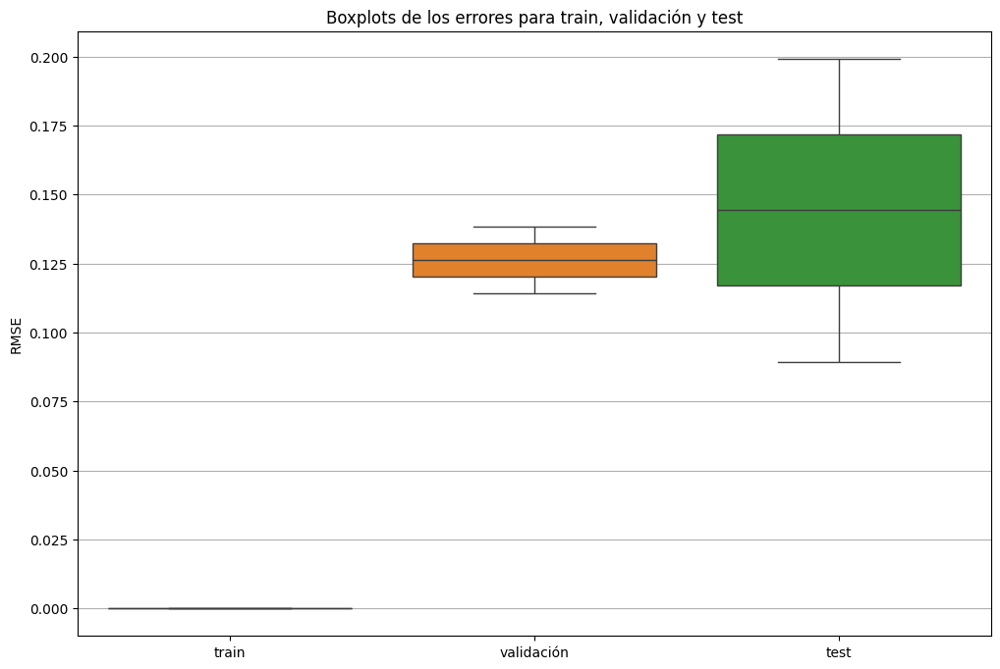

In [ ]:
modelo = temp.iloc[0]
knn, knn_test, knn_val, knn_train = modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

Nótese que la mediana del RMSE de los conjuntos de validación y test son cercanas.

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
0,knn,acc_y,3,3,1,28,"{'n_neighbors': 7, 'p': 1, 'weights': 'distance'}"


El mejor modelo encontrado para KNN fue para la variable acc_y, es decir, el acelerómetro en el eje y, para el tercer ejercicio y la tercera unidad, la cual es de hecho, en el contexto del ejercicio el sensor en una de las ubicaciones más importantes, la rodilla derecha.

Este ejercicio en particular, consiste en acostarse boca arriba sobre una superficie plana, levantar la pierna derecha manteniendo tanto la rodilla derecha como la pierna izquierda completamente rectas. Luego, sostén la postura durante 5 segundos. Finalmente, regresa la pierna derecha a la posición inicial con control.

Se encontró que el mejor modelo no tiene una separación del conjunto de validación y una ventana de predicción en el conjunto de entrenamiento de 28 días, los mejores parámetros encontrados fueron 7 vecinos, p igual a 1 y como peso la distancia.

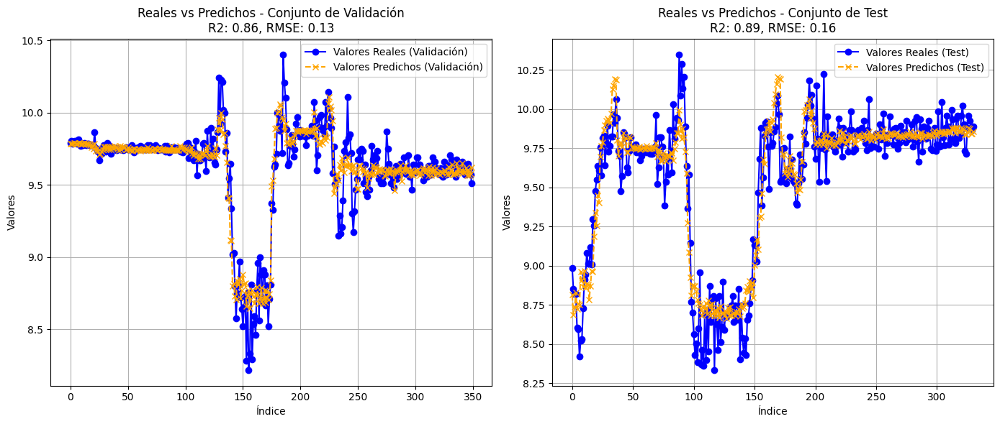

In [ ]:
rvsp(pd.DataFrame(knn_val), pd.DataFrame(knn_test))

Se obtuvo un $R^2$ de 0.86 en el conjunto de validación con un $RMSE$ de 0.13, ambos buenos indicadores de la eficiencia del modelo. En el conjunto de test, se obtuvo un $R^2$ de 0.89 y un $RMSE$ de 0.16, ambos un poco más altos.

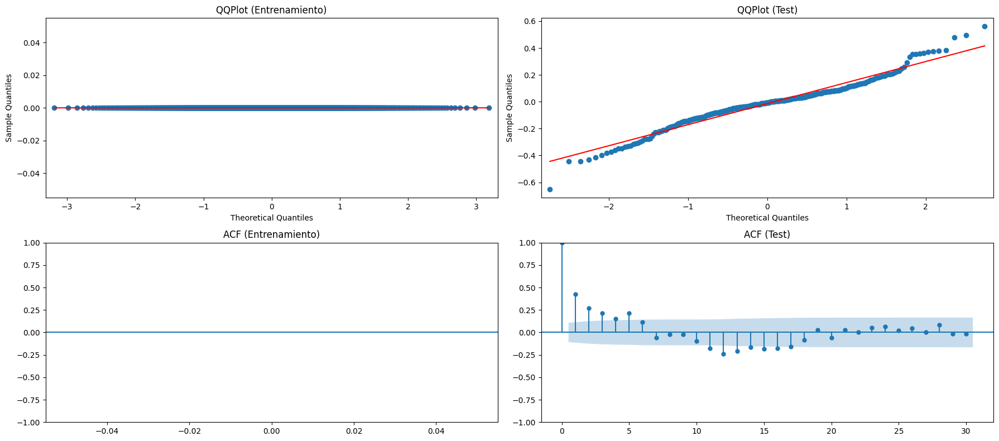

In [ ]:
res = analizar_residuos(pd.DataFrame(knn_test), pd.DataFrame(knn_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,0.0,0.0,0.0,0.0,1.0,NaN,NaN


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,1.179781,0.11063,0.024726,0.157244,0.892235,5.052984e-24,1.308037e-12


Para los residuos en el caso del conjunto de entrenamiento, el modelo parece ajustar perfectamente a los datos de entrenamiento, esto sugiere cierto sobreajuste en el caso de knn. Los p valores aparecen como **NaN** debido a que todos los residuos son 0, lo que impide realizar las pruebas correctamente. El ACF no refleja ningún tipo de autocorrelación.

Para el caso de test, el modeo tiene un buen desempeño con un $R^2$ de 0.89, los errores también son bastante bajos por tanto generaliza bien al conjunto. Al revisar los p - valores,ambos con muy cercanos a 0, lo que en el caso de la prueba $\texttt{Ljung-Box}$ indica que los residuos tienen autocorrelación, restándole validez al modelo. El valor de $\texttt{Jarque-Bera}$ al ser también cercano a 0, indica que los residuos tampoco siguen una distribución normal.

## Regresión lineal

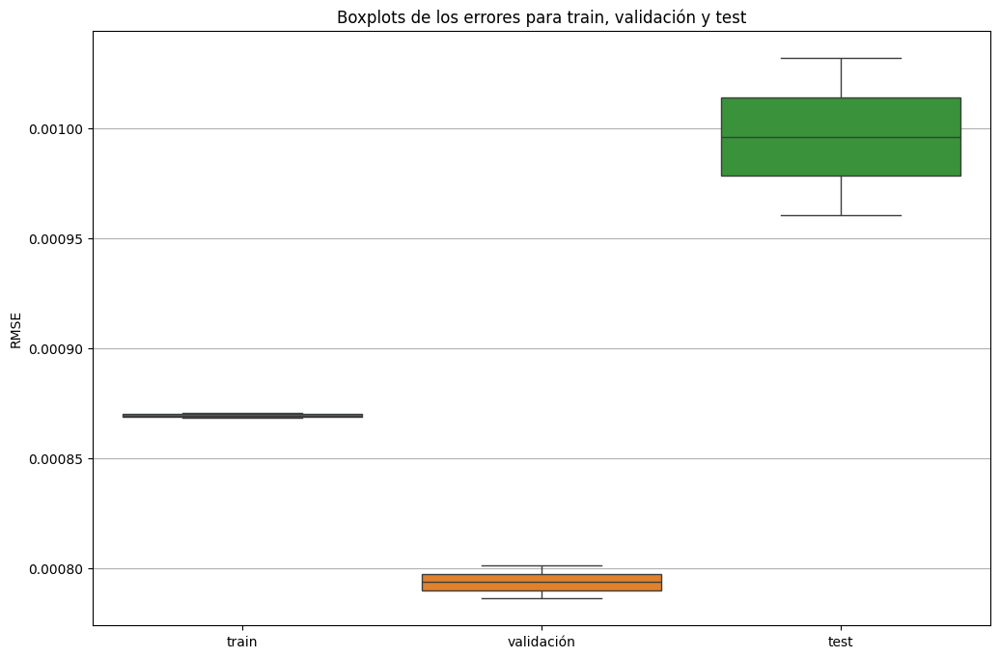

In [ ]:
modelo = temp.iloc[1]
lineal, lineal_test, lineal_val, lineal_train = modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
1,lineal,mag_y,3,2,1,21,{}


Para el modelo de regresión lineal, el mejor obtenido fue para la variable mag_y o magnetómetro en y, para la unidad 3, ejercicio 2, ninguna separación del conjjunto de validación y una ventana de predicción en el conjunto de entrenamiento de 21 días. Al ser un modelo de regresión lineal, no tiene hiperparámetros.

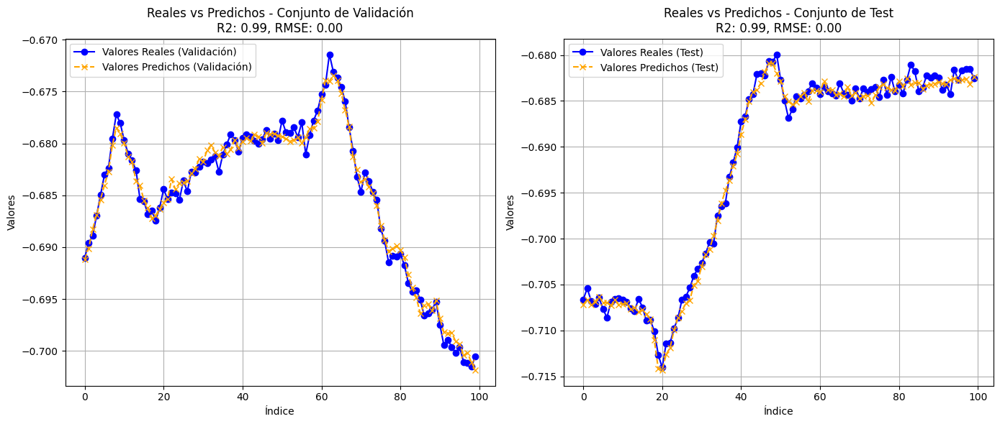

In [ ]:
rvsp(pd.DataFrame(lineal_val).iloc[:100], pd.DataFrame(lineal_test)[:100])

Ajusta demasiado bien, podrían sugerir sobreajuste en ambos conjuntos.

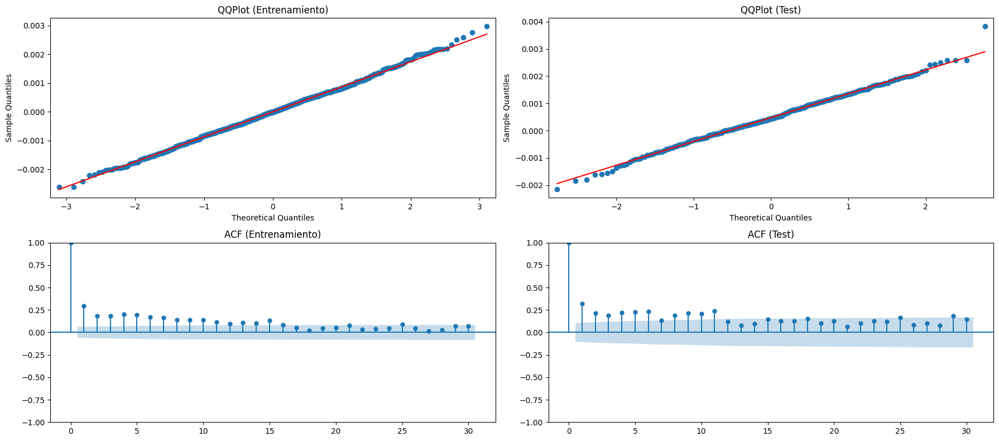

In [ ]:
res = analizar_residuos(pd.DataFrame(lineal_test), pd.DataFrame(lineal_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,0.100007,0.000692,7.561042e-07,0.00087,0.994687,1.280441e-72,0.660765


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,0.116151,0.00079,9.940178e-07,0.000997,0.989414,3.383875e-31,0.415658


En ambos modelos se obtienen $R^2$ bastante altos y errores muy pequeños, esto indica que el modelo predice casi que perfectamente los datos de entrenamiento y test. Din embargo, en ambos caso el p - valor de $\texttt{Ljung Box}$ indican que existe una autocorrelación significativa entre los residuos, es decir no son independientes. El valor de $\texttt{Jarque-Bera}$, por otro lado, sí sugiere que los residuos son normales.

## Regresión Lasso

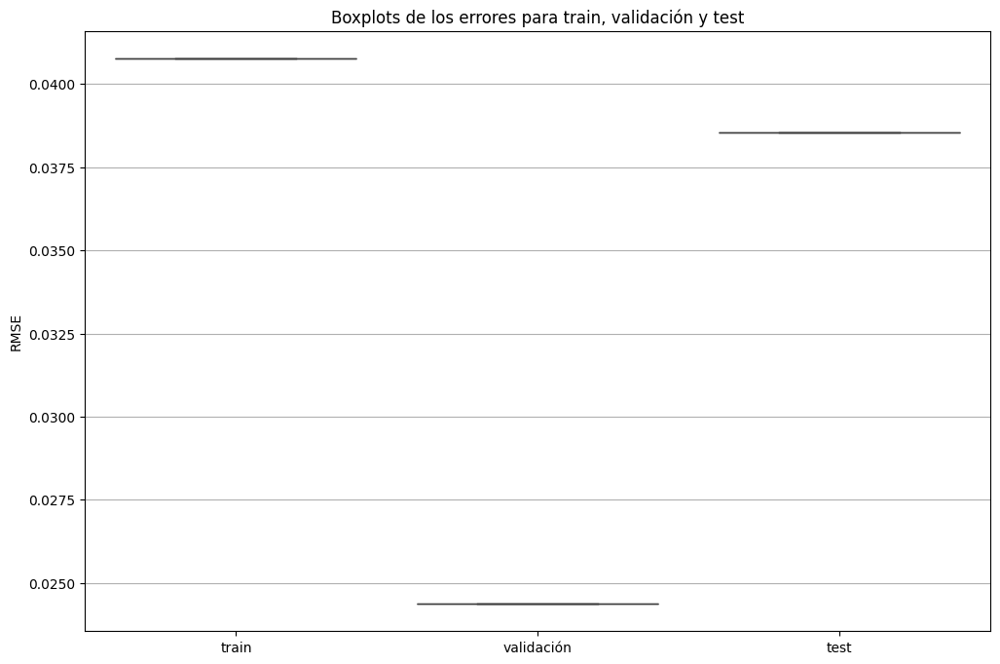

In [ ]:
modelo = temp.iloc[2]
lasso, lasso_test, lasso_val, lasso_train = modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
2,lasso,acc_y,5,3,3,28,"{'alpha': 0.1, 'max_iter': 1000}"


Lasso realmente no funcionóC con ninguna variable, no ajustó bien bajo nigún hiperparámetro, ejercicio, unidad, ventana o separación. El mejor modelo de regresión con penalización de Lasso, fue realizado para la variable de aceleración en y, unidad 5, tercer ejercicio y con una separación de 2 segundos o 50 registros del conjunto de validación. Los mejores hiperparámetros encontrados fueron un alpha de 0.1 y 1000 iteraciones máximas.

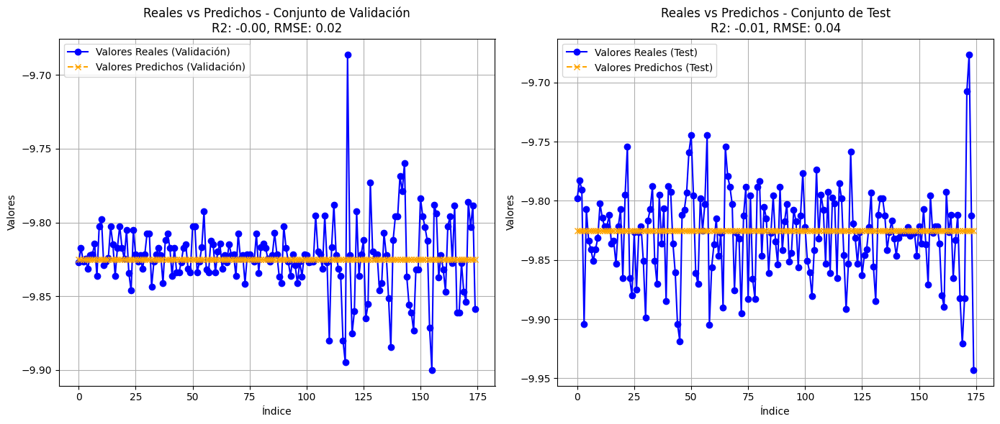

In [ ]:
rvsp(pd.DataFrame(lasso_val), pd.DataFrame(lasso_test))

Como se puede observar, predijo el mismo valor  tanto en validación como en test.

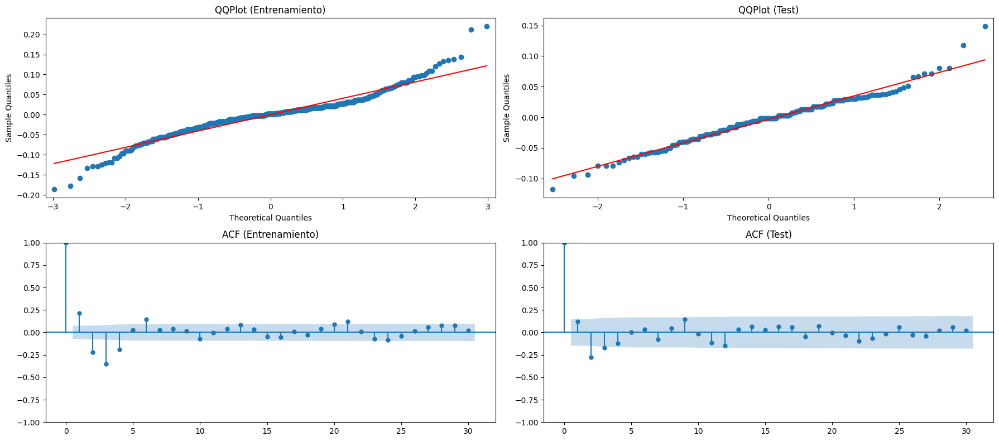

In [ ]:
res = analizar_residuos(pd.DataFrame(lasso_test), pd.DataFrame(lasso_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,0.280075,0.027516,0.001662,0.040762,0.0,1.054963e-37,1.250797e-124


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,0.296399,0.02914,0.001485,0.038534,-0.008199,0.000844,0.000858


Se obtuvieron errores bastante bajos pero también pésimos $R^2$, los p - valores de las pruebas realizadas a los residuos indican que no son independientes ni tampoco normales.

## Regresión Ridge

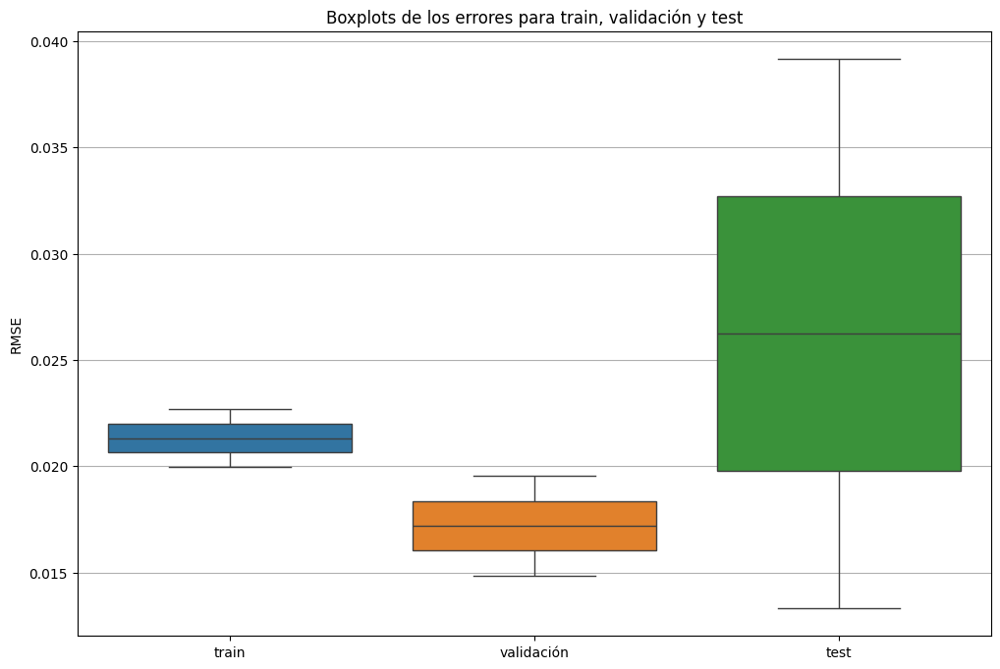

In [ ]:
modelo = temp.iloc[3]
ridge, ridge_test, ridge_val, ridge_train = modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
3,ridge,gyr_y,2,1,1,28,"{'alpha': 1, 'max_iter': 1000}"


El mejor mmodelo obtenido para regresión con Ridge fue para la variable del giroscopio en y, gyr_y, en la unidad 2 y el ejercicio 1, con un conjunto de test justo después del de validación y una ventana de predicción en entrenamiento de 28 segundos.

Este ejercicio consiste en consiste en sentarse en una superficie plana y elevada. Desde esa posición, debes levantar la pierna derecha manteniéndola completamente recta. Luego, sostén esa postura durante 5 segundos, asegurándote de que la rodilla derecha permanezca extendida. Finalmente, baja la pierna con control y regresa a la posición inicial.

La unidad involucrada en este modelo corresponde a la encontrada en el tobillo derecho, la cual juega un papel fundamental durante la realización del ejercicio.

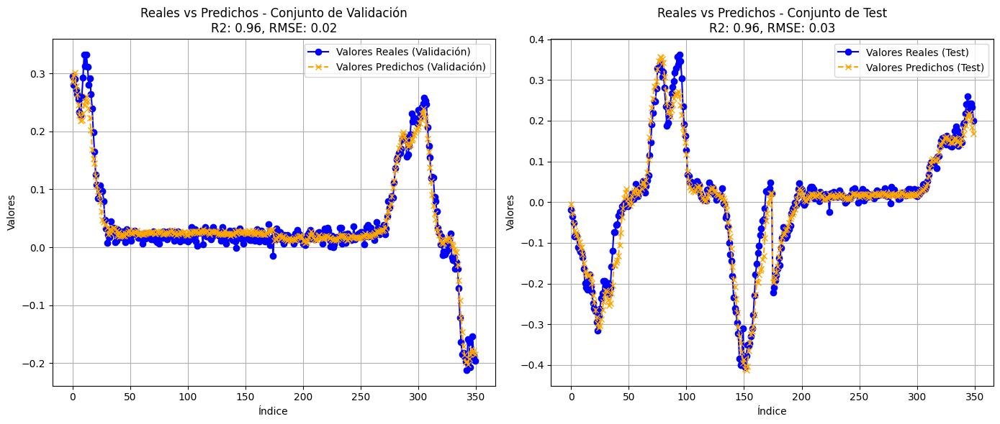

In [ ]:
rvsp(pd.DataFrame(ridge_val), pd.DataFrame(ridge_test))

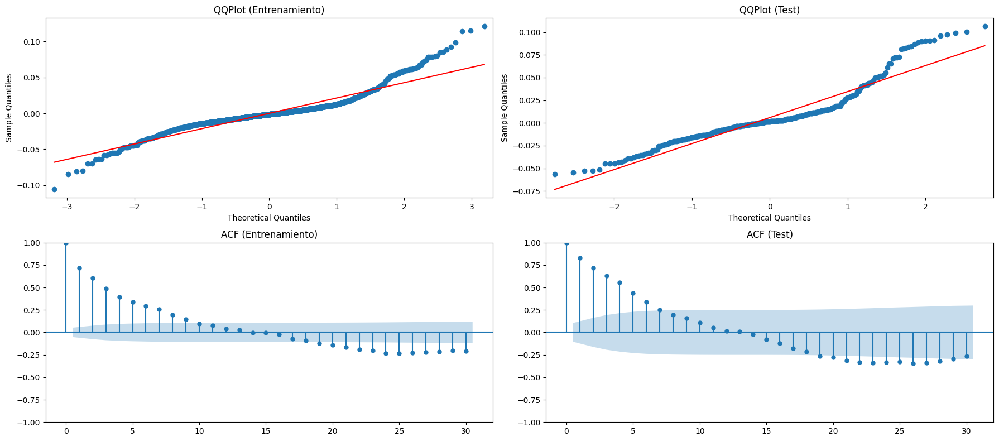

In [ ]:
res = analizar_residuos(pd.DataFrame(ridge_test), pd.DataFrame(ridge_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,101.574877,0.01393,0.000457,0.02137,0.968481,0.0,0.0


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,87.584141,0.019208,0.000855,0.029247,0.960738,7.272001e-173,2.766085e-32


Si bien se obtuvo un muy bien $R^2$ y algunos errores bastante bajos, la métrica del error porcental $MAPE$ y los p-valores de las pruebas realizadas a los residuos sugieren problemas en el ajuste, no son ni normales ni independientes.

## Random Forest

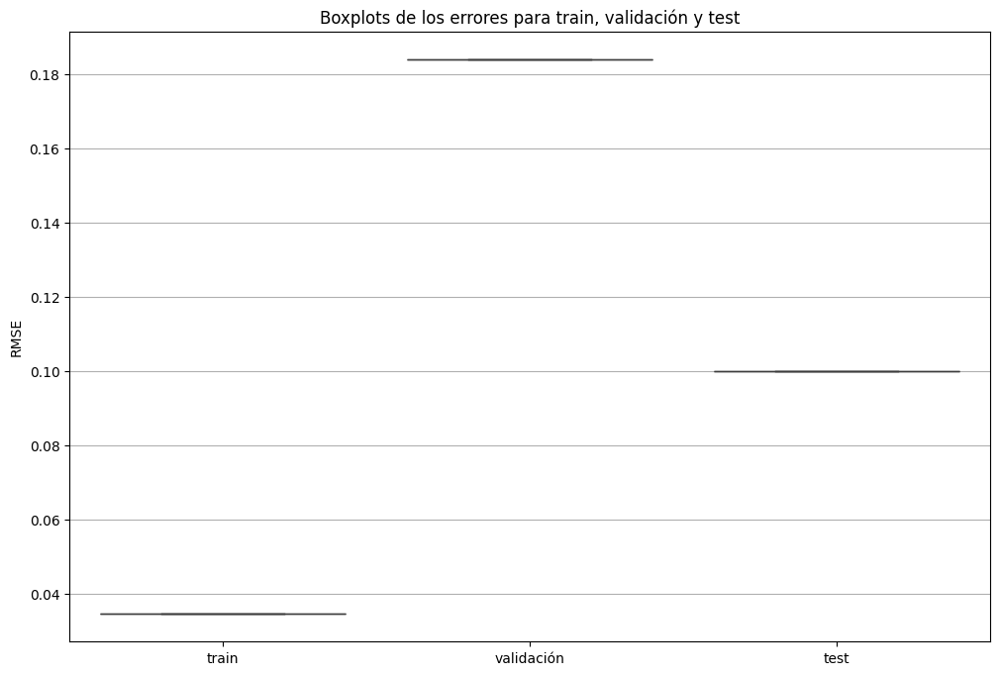

In [ ]:
modelo = temp.iloc[4]
rf, rf_test, rf_val, rf_train = modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
4,random_forest,acc_x,2,4,1,28,"{'max_depth': 20, 'n_estimators': 150}"


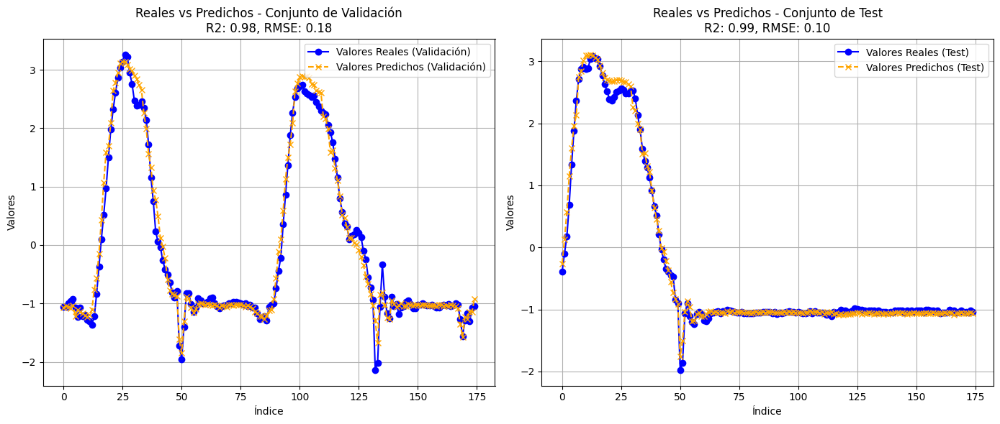

In [ ]:
rvsp(pd.DataFrame(rf_val), pd.DataFrame(rf_test))

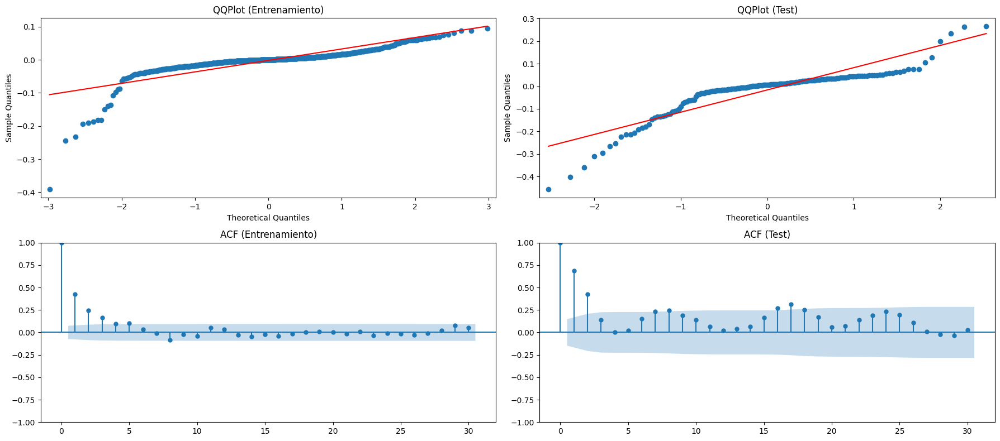

In [ ]:
res = analizar_residuos(pd.DataFrame(rf_test), pd.DataFrame(rf_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,2.629574,0.017395,0.001201,0.034654,0.999491,6.806554e-40,0.0


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,8.161946,0.059689,0.010004,0.100018,0.994838,2.908990e-28,2.617335e-47


Se obtuvieron errores muy bajos, un buen $R^2$ sin embargo, los resultados de las pruebas aplicadas a los residuos tanto en el conjunto de entrenamiento como en el conjunto de test, demuestran que los residuos no son independientes ni normales.

## XGBoost

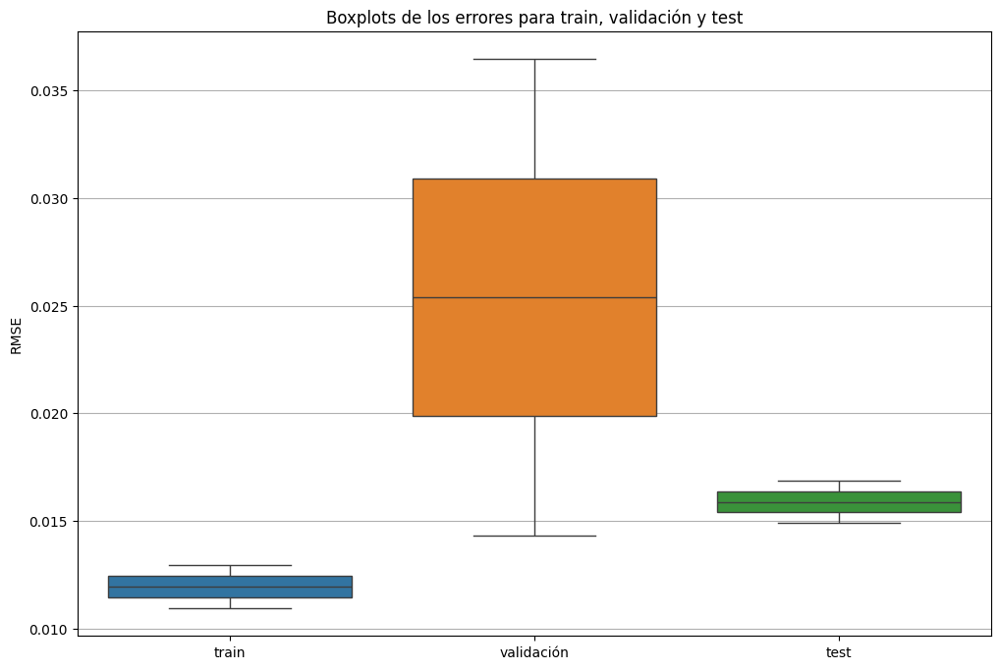

In [ ]:
modelo = temp.iloc[5]
xg, xg_test, xg_val, xg_train= modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
5,xgboost,gyr_y,2,1,1,21,"{'learning_rate': 0.1, 'max_depth': 3, 'n_esti..."


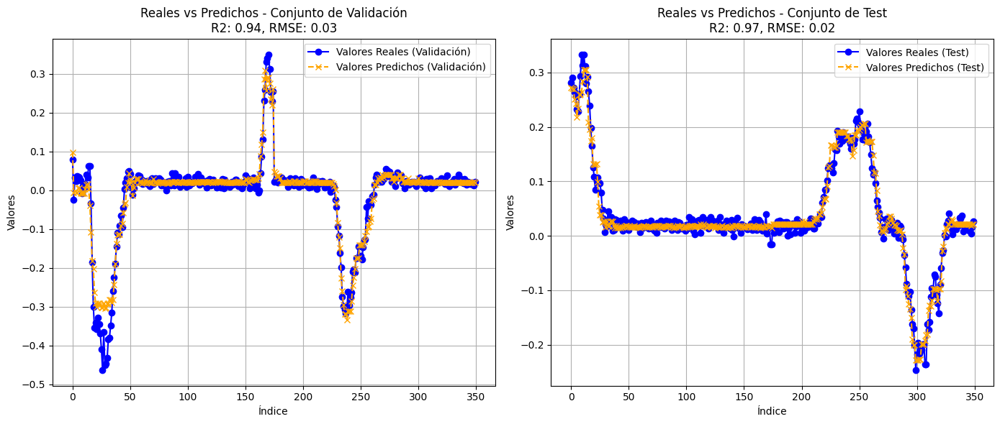

In [ ]:
rvsp(pd.DataFrame(xg_val), pd.DataFrame(xg_test))

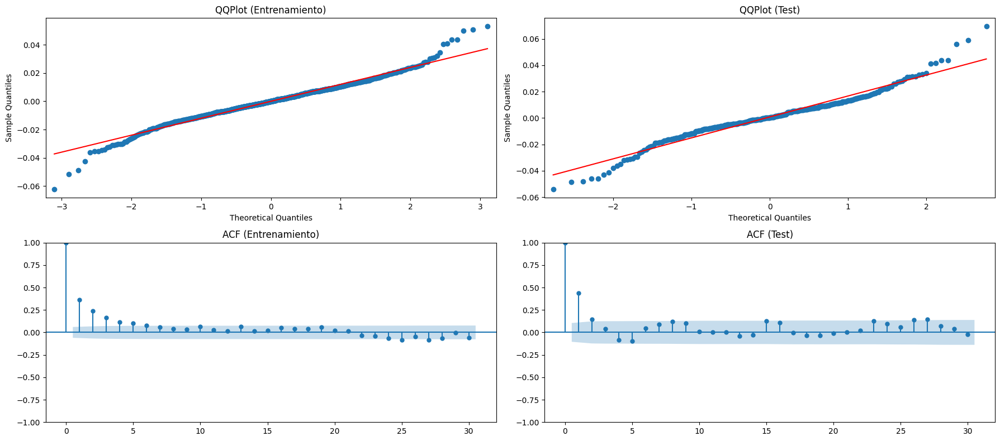

In [ ]:
res = analizar_residuos(pd.DataFrame(xg_test), pd.DataFrame(xg_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,86.39569,0.008996,0.000144,0.01199,0.99228,5.036854e-52,1.120875e-54


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,77.976109,0.01133,0.000254,0.015924,0.972163,8.487276e-16,2.948930e-21


Los errores porcentuales y los p - valores de las pruebas aplicadas a los residuos confirman que el modelo no está ajustando tan bien como lo sugiere el $R^2$, el cual es bastante alto, debido a que los residuos tampoco cumplieron los supuestos, es decir, no son normales ni tampoco independientes. Se observa como las colas de los QQplot salen de la línea recta.

## SVR

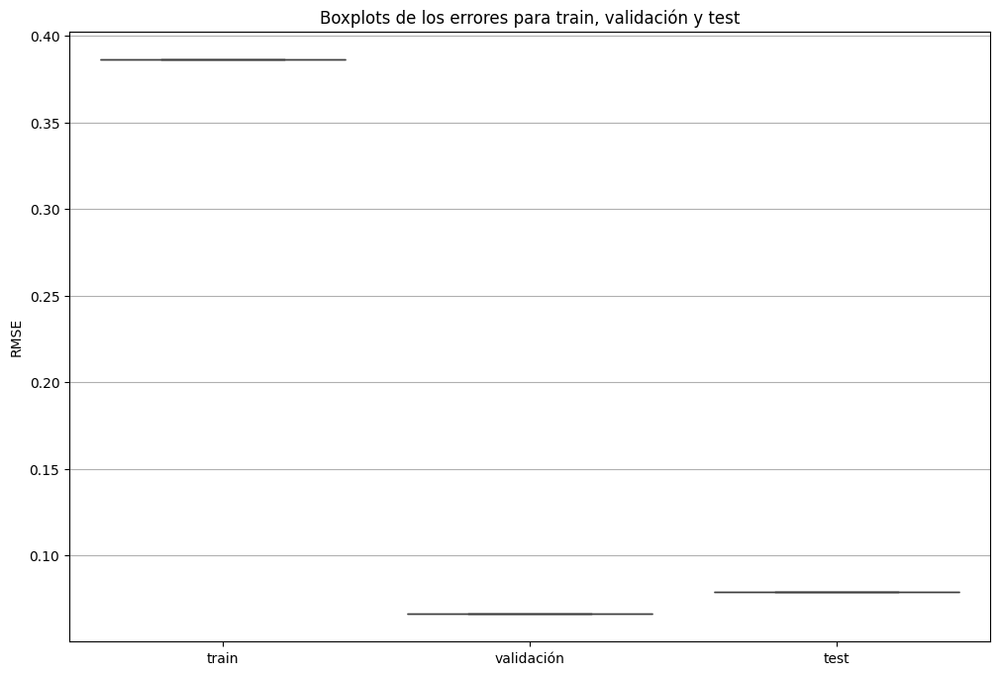

In [ ]:
modelo = temp.iloc[6]
svr, svr_test, svr_val, svr_train= modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])

In [ ]:
pd.DataFrame(modelo).T

,Modelo,Variable,Unidad,Ejercicio,Separación,Ventana,Hiperparámetros
6,svr,acc_y,4,7,3,28,"{'C': 10, 'kernel': 'linear'}"


El mejor modelo encontrado para SVR corresponde al ejercicio 7, este ejercicio consiste en permanecer de pie, con la espalda recta, sosteniendo un peso de 1 kg en la mano derecha, con el brazo colgando recto hacia abajo. Desde esa posición, eleva el peso hacia el lado derecho desde la articulación del hombro hasta alcanzar una posición horizontal, manteniendo el codo completamente recto. Luego, mantén esta posición durante 5 segundos. Finalmente, regresa el brazo a la posición inicial con control.

Para la unidad 4, posicionada en el hombro derecho en la variable del acelerómetro en y. Este modelo tuvo un ventana de predicción en entrenamiento de 28 segundos y una separación de 3 segundos del conjunto de validación y test. Los mejores hiperparámetros encontrados fueron de kernel lineal con C 10.

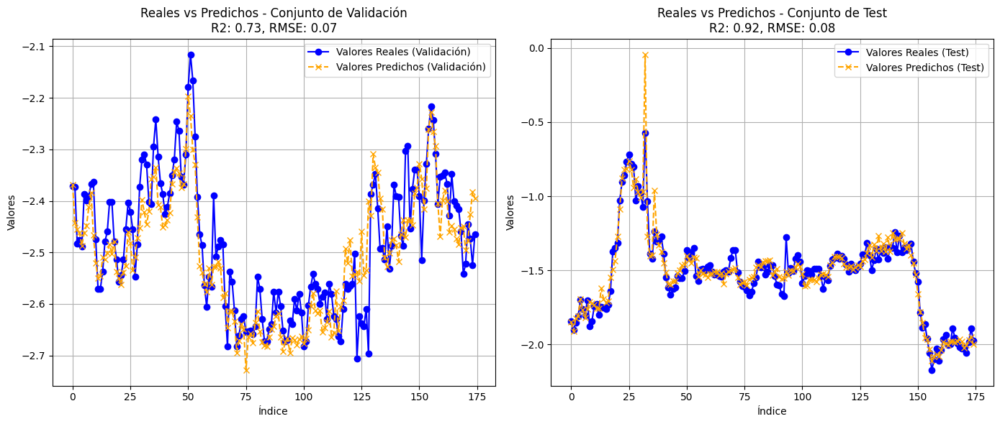

In [ ]:
rvsp(pd.DataFrame(svr_val), pd.DataFrame(svr_test))

Se obtuvieron valores de $R^2$ bastante altos en ambos conjuntos, tanto de validación como en test, siendo más alto en test con 0.92. Los $RMSE$ también son bastante bajos en ambos conjuntos, siendo muy ligeramente mayor en test.

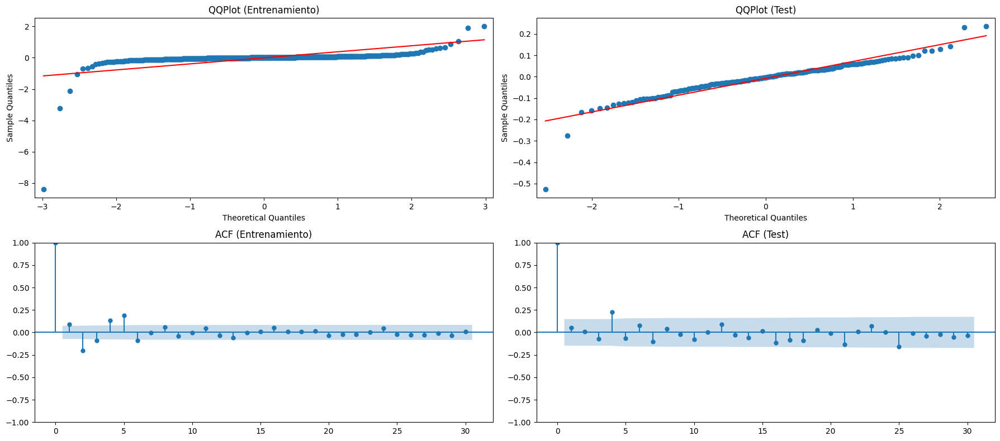

In [ ]:
res = analizar_residuos(pd.DataFrame(svr_test), pd.DataFrame(svr_train))

In [ ]:
res['Entrenamiento']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,9.130908,0.093525,0.149123,0.386164,0.726431,1.249499e-14,0.0


In [ ]:
res['Test']

,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
0,4.10939,0.053941,0.006261,0.079128,0.920384,0.096078,4.807450e-196


En la gráfica se observa del conjunto de entrenamiento se nota inmediatamente que los residuos no son normales, esto es confirmado por el p valor de $\texttt{Jarque-Bera}$ el cual confirma la no normalidad de los residuos, en test parecen tener una distribución más normal, sin embargo los resultados del test arrojados confirman que no tienen tampoco una distribución normal.

En el caso de la prueba de $\texttt{Ljung-Box}$, los residuos en el conjunto de entrenamiento presentan autocorrelación significativa, en cambio, en el conjunto de test, con un nivel de significancia del 0.05, no se rechaza la hipótesis nula de independencia, es decir, los residuos no están autocorrelacionados.

En cuanto a las métricas en el conjunto de entrenamiento, se obtuvo un error porcentual medio del 9.13%, es decir, las predicciones del conjunto de entrenamiento se desvían ese porcentaje de los valores reales en promedio, el $MAE$ es bajo, sin embargo el $MSE$ y $RMSE$ son un poco más altos, es decir, el modelo comete errores con impactos sifnificativos.

Para el conjunto de test el $MAPE$ es menor, es decir, los valores predichos del test se desvían un 4.1% del valor real, tando el $MAE$, $MSE$ y $RMSE$ son menores en este conjunto.

# Resultados finales

In [ ]:
modelos_finales = []
modelos = ['knn', 'lineal', 'lasso', 'ridge', 'random_forest', 'xgboost', 'svr']
for i in range(0,7):
  modelo = temp.iloc[i]
  modelo, modelo_test, modelo_val, modelo_train= modeloespecifico(modelo['Ejercicio'], modelo['Unidad'], modelo['Ventana'], modelo['Separación'], modelo['Modelo'], modelo['Hiperparámetros'], modelo['Variable'])
  res = analizar_residuos(pd.DataFrame(modelo_test), pd.DataFrame(modelo_train))
  jej = res['Test']
  jej = [res['Test'][col].iloc[0] for col in res['Test'].columns]
  print(jej)
  modelos_finales.append(jej)


In [ ]:
pd.DataFrame(modelos_finales, index = modelos, columns = res['Test'].columns)


,MAPE (%),MAE,MSE,RMSE,R2,Ljung-Box p-value,Jarque-Bera p-value
knn,1.179781,0.110630,2.472567e-02,0.157244,0.892235,5.052984e-24,1.308037e-12
lineal,0.116151,0.000790,9.940178e-07,0.000997,0.989414,3.383875e-31,4.156584e-01
lasso,0.296399,0.029140,1.484897e-03,0.038534,-0.008199,8.441934e-04,8.580741e-04
ridge,87.584141,0.019208,8.553685e-04,0.029247,0.960738,7.272001e-173,2.766085e-32
random_forest,8.568616,0.061894,9.483475e-03,0.097383,0.995107,2.459596e-32,5.902667e-48
xgboost,77.976109,0.011330,2.535730e-04,0.015924,0.972163,8.487276e-16,2.948930e-21
svr,4.109390,0.053941,6.261236e-03,0.079128,0.920384,9.607772e-02,4.807450e-196


**KNN**  
El modelo de KNN tiene un buen rendimiento con un $ \text{MAPE} $ bajo (1.18%), lo que indica que se ajusta bastante bien a los datos. Su $ R^2 $ de 0.89 muestra una buena capacidad predictiva. Sin embargo, los residuos no son totalmente normales y la prueba de $ \text{Ljung-Box} $ sugiere que hay autocorrelación en los residuos, lo que quiere decir que el modelo no ha capturado toda la estructura temporal de los datos. Podría mejorar con algunos ajustes adicionales.

**Regresión lineal**  
La regresión lineal es excelente en cuanto a precisión, con un $ \text{MAPE} $ de 0.12% y un $ R^2 $ de 0.99, lo que indica un ajuste muy bueno a los datos. Sin embargo, también muestra autocorrelación en los residuos, según la prueba de $ \text{Ljung-Box} $. Aunque es muy preciso, el modelo podría necesitar mejorar en la captura de las dinámicas temporales.

**Lasso**  
El modelo de Lasso tiene un $ \text{MAPE} $ decente de 0.30%, pero su $ R^2 $ negativo (-0.01) indica que no se ajusta bien a los datos. Además, la prueba de $ \text{Ljung-Box} $ muestra autocorrelación en los residuos, lo que sugiere que el modelo no está capturando toda la dinámica temporal. Los residuos tampoco son normales, lo que indica que el modelo podría no ser el mejor para estos datos.

**Ridge**  
Aunque el modelo de Ridge tiene un $ \text{MAPE} $ altísimo (87.58%), su $ R^2 $ alto (0.96) muestra que está sobreajustando los datos. Los residuos no presentan autocorrelación, lo que significa que el modelo ha capturado la parte temporal bien. Sin embargo, los residuos no son normales, lo que sugiere que hay espacio para mejoras.

**Random Forest**  
Random Forest tiene un rendimiento bastante bueno, con un $ \text{MAPE} $ de 8.57% y un $ R^2 $ de 0.99, lo que indica que tiene una excelente capacidad predictiva. Además, no hay autocorrelación en los residuos, lo que es una buena señal de que ha capturado bien la dinámica temporal. Los residuos no siguen una distribución normal, pero, en general, el modelo parece estar funcionando bastante bien.

**XGBoost**  
El modelo de XGBoost no tiene un buen desempeño en cuanto a precisión, con un $ \text{MAPE} $ alto (77.98%), aunque su $ R^2 $ de 0.97 muestra que tiene algo de capacidad predictiva. Los residuos tienen autocorrelación, lo que sugiere que no ha capturado completamente la estructura temporal. Además, los residuos tampoco son normales, lo que indica que podría haber margen para mejorar.

**SVR**  
SVR tiene un rendimiento moderado, con un $ \text{MAPE} $ de 4.11% y un $ R^2 $ de 0.92, lo que lo hace decente en cuanto a capacidad predictiva. No hay autocorrelación significativa en los residuos, lo que es positivo. Sin embargo, los residuos no son normales, lo que sugiere que el modelo también podría mejorarse.

